In [3]:
# Librerías
import numpy as np
import deepxde as dde
import deepxde.backend.tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.interpolate import griddata
from scipy.interpolate import RegularGridInterpolator
from matplotlib.lines import Line2D
from IPython.display import HTML
from memory_profiler import memory_usage
import psutil

Using backend: tensorflow.compat.v1
Other supported backends: tensorflow, pytorch, jax, paddle.
paddle supports more examples now and is recommended.


Instructions for updating:
non-resource variables are not supported in the long term


# Primer problema
El problema que se prentende modelizar es el siguiente:

$\frac{\partial u}{\partial t} = 1.58\frac{\partial^2 u}{\partial x^2} + 0.8u, \quad x \in (0, 5), \ t > 0$

sujeto a las condiciones de frontera de tipo Dirichlet:

$u(0,t) = 273.15, \quad u(5,t) = 273.15, \quad t > 0$

y a la condición inicial de tipo gaussiana:

$u(x,0) = x(5-x)50\exp\left(-10(x - 2)^2\right) + 273.15, \quad x \in (0, 5)$

Parámetros de inicialización del problema:

In [4]:
# Parámetros del problema.
L = 5           # Longitud de la barra.
Lscalado = 1.0  # Longitud escalada.
n_terms = 50    # Número de términos en la serie de Fourier.
D = 1.58        # Coeficiente de difusión térmica.
K = 0.8         # Coeficiente reactivo.
T_max = 1.0     # Tiempo máximo.
Kelvin = 273.15 # Conversión de Celsius a Kelvin.

In [5]:
# LaTeX.
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.size": 14,
    "axes.labelsize": 14,
    "axes.titlesize": 14,
    "xtick.labelsize": 13,
    "ytick.labelsize": 13,
    "legend.fontsize": 14,
    "axes.linewidth": 1.2,
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 6,
    "ytick.major.size": 6,
})

# Solución analítica

Se trunca la serie de Fourier en el término 50.

In [6]:
def IC(x):
    return (50 * np.exp(-10 * (x - 2)**2)*(5-x)*x)  # Pico de 200 ºC en x=2.

# Cálculo de los coeficientes de Fourier Cn.
def compute_coefficients(n_terms):
    C = np.zeros(n_terms)
    for n in range(1,n_terms):
        k_n = (n) * np.pi / (L)
        integrand = lambda x: (IC(x)) * np.sin(k_n * x)
        C[n] = (2 / L) * np.trapz(integrand(np.linspace(0, L, 10000)), np.linspace(0, L, 10000))
    return C

C_n = compute_coefficients(n_terms)

# Solución del primer problema.
def u_xt(M):
    solution = 0
    for n in range(1,n_terms):
        k_n = (n) * np.pi / (L)
        solution += C_n[n] * np.sin(k_n * M[:,0]) * np.exp((-D*(k_n**2)+K) * M[:,1])
    return solution.reshape(-1, 1)  # Salida vector columna.

# Crear una malla combinando la primera columna (x) y la segunda columna (t) de M.
x_vals = np.linspace(0, L, 200)      # Valores de x (espacio).
t_vals = np.linspace(0, T_max, 200)  # Valores de t (tiempo).

# Crear una malla 2D con todas las combinaciones de x y t.
X, T = np.meshgrid(x_vals, t_vals)
# Aplanar las mallas para crear pares (x, t).
M_combined = np.column_stack([X.ravel(), T.ravel()])

# Evaluar la función para cada combinación de (x, t).
U = u_xt(M_combined)+Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla.
U = U.reshape(X.shape)

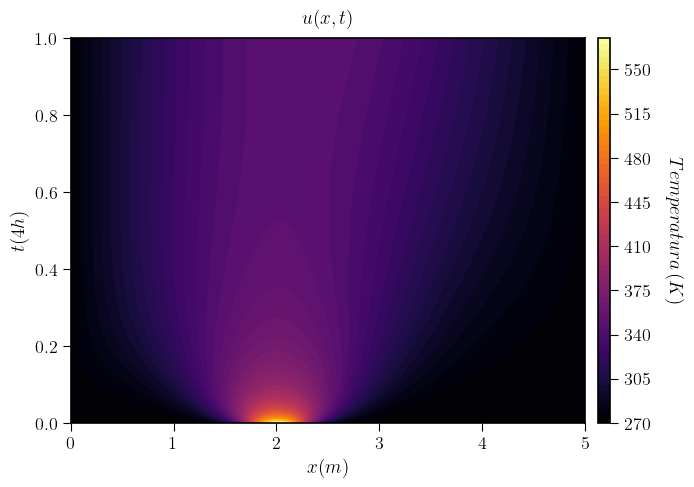

In [ ]:
# evolución de la temperatura.
plt.figure(figsize=(8, 5))
contour=plt.contourf(X, T, U, levels=60,cmap='inferno')
cbar = plt.colorbar(contour, pad=0.02, aspect=30)
cbar.ax.tick_params(labelsize=13)
cbar.set_label(r"$Temperatura\, (K)$", rotation=-90, labelpad=25)

plt.title(r"$u(x, t)$", pad=10)
plt.xlabel(r"$x(m)$")
plt.ylabel(r"$t(4h)$")
plt.show()

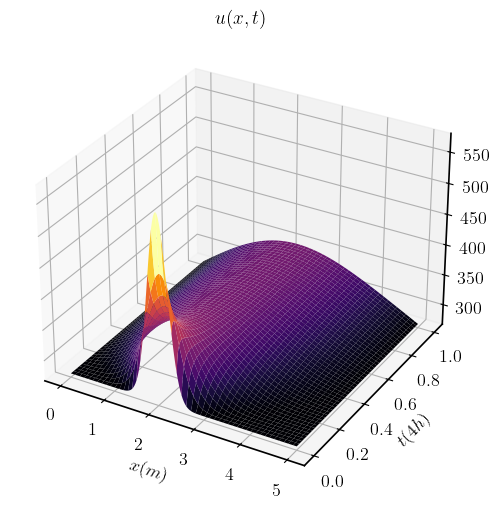

In [ ]:
fig = plt.figure(figsize=(14, 6))
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X, T, U, cmap='inferno')

ax.set_title(r"${u}(x,t)$")
ax.set_xlabel("$x (m)$")
ax.set_ylabel("$t (4h)$")

plt.show()

# MDF

In [17]:
def MDF(Nx,Nt):

    x = np.linspace(0, L, Nx)
    t = np.linspace(0, T_max, Nt)
    h = x[1] - x[0]        # Paso espacial.
    k = t[1] - t[0]        # Paso temporal.

    # Inicializar la matriz de temperaturas.
    U1 = np.zeros((Nx, Nt))
    U1[:, 0] = IC(x) 

    # Condiciones de frontera (Dirichlet homogéneas: extremos a 0).
    U1[0, :] = 0
    U1[-1, :] = 0 

    # Cálculo del número CFL.
    CFL = D * k / h**2
    print(f"CFL: {CFL:.4f}")

    # Esquema explícito.
    for n in range(0, Nt-1):
        for i in range(1, Nx-1):
            U1[i, n+1] = (k*K + 1)*U1[i, n] + CFL * (U1[i+1, n] - 2*U1[i, n] + U1[i-1, n])

    U1 = U1 + Kelvin  # Convertir a Kelvin.
    
    return U1, x, t

### Tiempo y precisión

In [ ]:
%%time
Nx = 15 # Número de puntos espaciales.
Nt = 40 # Número de puntos temporales.

mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.00000001,retval=True)
mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
U, x, t = mem_info[1]    

print("Memoria consumida: %1.4f MB" % mem_consumo)

CFL: 0.3176
Memoria consumida: 0.2344 MB
CPU times: user 14.4 ms, sys: 24.9 ms, total: 39.3 ms
Wall time: 324 ms


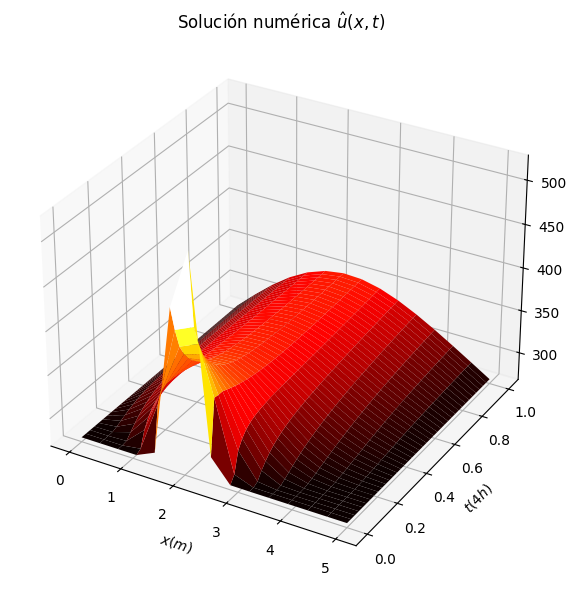

In [ ]:
# Graficar la evolución de la temperatura MDF.
X1, T1 = np.meshgrid(x, t, indexing='ij')

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X1, T1, U, cmap='hot')

ax.set_title(r"Solución numérica $\hat{u}(x,t)$")
ax.set_xlabel(r"$x (m)$")
ax.set_ylabel(r"$t (4h)$")

plt.tight_layout()
plt.show()

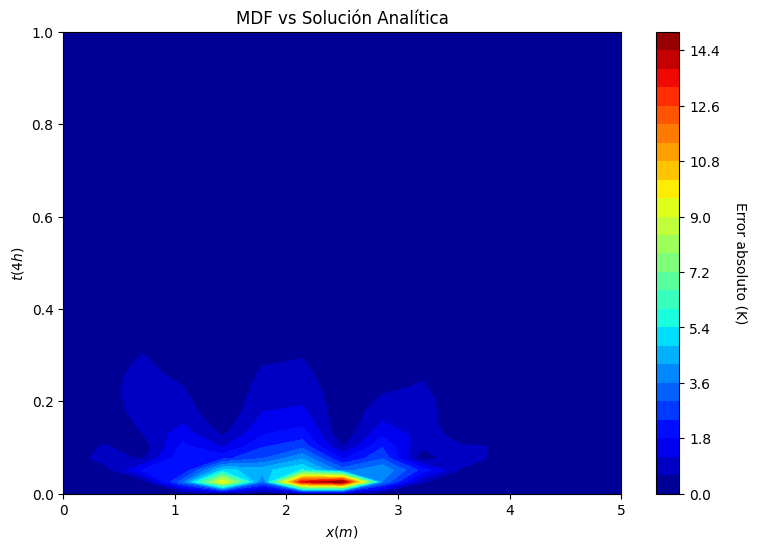

In [ ]:
M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])

# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(M_combined1) + Kelvin
U12 = U12.reshape(X1.shape)

error = np.abs(U - U12) 
error = error.reshape(X1.shape)

plt.figure(figsize=(9, 6))
cp = plt.contourf(X1, T1, error, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Error absoluto (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("MDF vs Solución Analítica")
plt.show()

In [ ]:
interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

U_interp = interpolador(X_test)  # Vector de 10000 valores.

In [ ]:
# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(X_test).flatten() + Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla.
error = np.abs(U_interp - U12) 

In [65]:
x_grid = np.linspace(0, L, 1000)
t_grid = np.linspace(0, T_max, 1000)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(X_test, error, (X, T), method="cubic", fill_value=True)

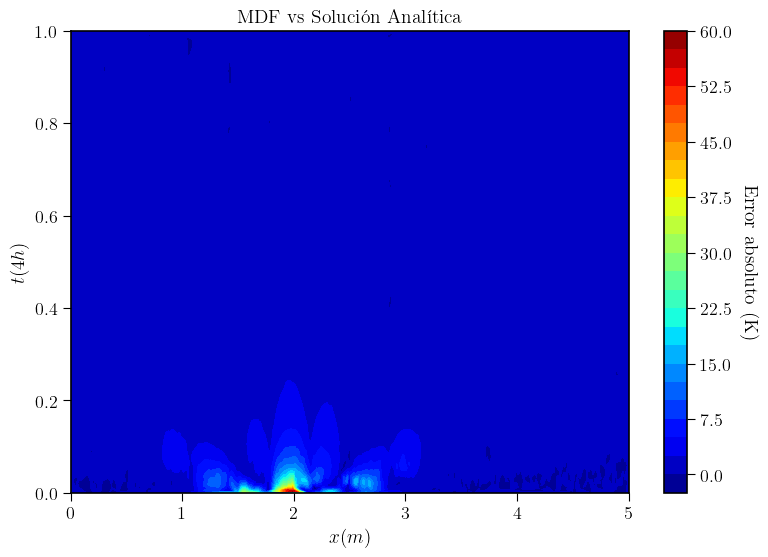

In [66]:
plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Error absoluto (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("MDF vs Solución Analítica")
plt.show()

In [ ]:
# MSE (Numerica vs analítica)
mse = np.mean((error)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 4.4728


### Número de puntos similar a PINN 1.

In [ ]:
%%time
Nx = 20 # Número de puntos espaciales.
Nt = 86 # Número de puntos temporales.

mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.00000001,retval=True)
mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
U, x, t = mem_info[1]    

print("Memoria consumida: %1.4f MB" % mem_consumo)

CFL: 0.2684
Memoria consumida: 0.4531 MB
CPU times: user 9.91 ms, sys: 87.4 ms, total: 97.4 ms
Wall time: 438 ms


In [ ]:
interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

U_interp = interpolador(X_test)  # Vector de 10000 valores interpolados.

In [ ]:
# Evaluar la función para cada combinación de (x, t)
U12 = u_xt(X_test).flatten() + Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla
error = np.abs(U_interp - U12)

In [ ]:
# MSE (Numerica vs analítica)
mse = np.mean((error)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 1.3914


### Número de puntos similar a PINN 2.

In [ ]:
%%time
Nx = 25  # Número de puntos espaciales.
Nt = 152 # Número de puntos temporales.

mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.00000001,retval=True)
mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
U, x, t = mem_info[1]    

print("Memoria consumida: %1.4f MB" % mem_consumo)

CFL: 0.2411
Memoria consumida: 0.3906 MB
CPU times: user 4.2 ms, sys: 14.6 ms, total: 18.8 ms
Wall time: 365 ms


In [ ]:
interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

U_interp = interpolador(X_test)  # Vector de 10000 valores interpolados.

In [ ]:
# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(X_test).flatten() + Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla.
error = np.abs(U_interp - U12) 

In [ ]:
# MSE (Numerica vs analítica)
mse = np.mean((error)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 0.3371


### Función error que interpola el mdf según los puntos de test.

In [ ]:
def errorMDF(U, x,t, test):
    interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

    U_interp = interpolador(X_test)  # Vector de valores interpolados.
    
    # Evaluar la función para cada combinación de (x, t).
    U12 = u_xt(X_test).flatten() + Kelvin
    # Volver a dar forma a los resultados para que coincidan con la malla.
    error = np.abs(U_interp - U12)
     
    # MSE (Numerica vs analítica).
    mse = np.mean((error)**2)
    return mse

#### Consumo de memoria y precisión

In [ ]:
Nx = 50
errores1 = []
memorias13 = []
NtL = [1000, 2000, 4000, 8000, 16000]

for Nt in NtL:
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias13.append(mem_consumo)
    
    X1, T1 = np.meshgrid(x, t, indexing='ij')
    M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])
    u_exacta = u_xt(M_combined1)+Kelvin
    error = np.mean((U - u_exacta.reshape(X1.shape))**2)
    errores1.append(error)

CFL: 0.1519
CFL: 0.0759
CFL: 0.0379
CFL: 0.0190
CFL: 0.0095


In [ ]:
Nx = 50
errores = []
memorias = []
NtL = [1000, 2000, 4000, 8000, 16000]

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

for Nt in NtL:
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias.append(mem_consumo)
    error = errorMDF(U,x,t,X_test)
    errores.append(error)

CFL: 0.1519
CFL: 0.0759
CFL: 0.0379
CFL: 0.0190
CFL: 0.0095


In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasMDFNx50.txt', memorias)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasMDFNx50.txt')

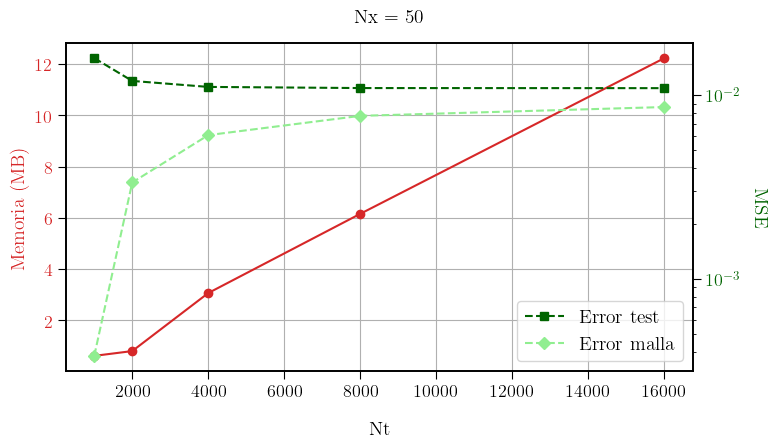

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Nx = 50", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria
color1 = 'tab:red'
ax1.set_xlabel("Nt", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(NtL, memorias, 'o-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Error (MSE)
ax2 = ax1.twinx()  
color2 = '#006400'
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(NtL, errores, 's--', color=color2,label="Error test")
ax2.plot(NtL,errores1, 'D--', color="#90ee90", label="Error malla")
ax2.set_yscale("log")  
ax2.tick_params(axis='y', labelcolor=color2)
plt.legend()

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [19]:
errores[-1]

0.01092172172201465

In [20]:
errores[-2]

0.010934321496848268

#### Manteniendo un CFL de 0.3

In [ ]:
Nx = 0
errores1 = []
memorias13 = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.3

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)

    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias13.append(mem_consumo)
    
    X1, T1 = np.meshgrid(x, t, indexing='ij')
    M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])
    u_exacta = u_xt(M_combined1)+Kelvin
    error = np.mean((U - u_exacta.reshape(X1.shape))**2)
    errores1.append(error)

CFL: 0.2756
CFL: 0.2853
CFL: 0.2880
CFL: 0.2913
CFL: 0.2944
CFL: 0.2958
CFL: 0.2976
CFL: 0.2981


In [ ]:
Nx = 0
errores = []
memorias = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.3

x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)
X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

puntos = (np.array(NxL) * np.array(NtL)).tolist()

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.01,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias.append(mem_consumo)
    
    error = errorMDF(U,x,t,X_test)
    errores.append(error)

CFL: 0.2756
CFL: 0.2853
CFL: 0.2880
CFL: 0.2913
CFL: 0.2944
CFL: 0.2958
CFL: 0.2976
CFL: 0.2981


In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasMDFCFL3.txt', memorias)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasMDFCFL3.txt')

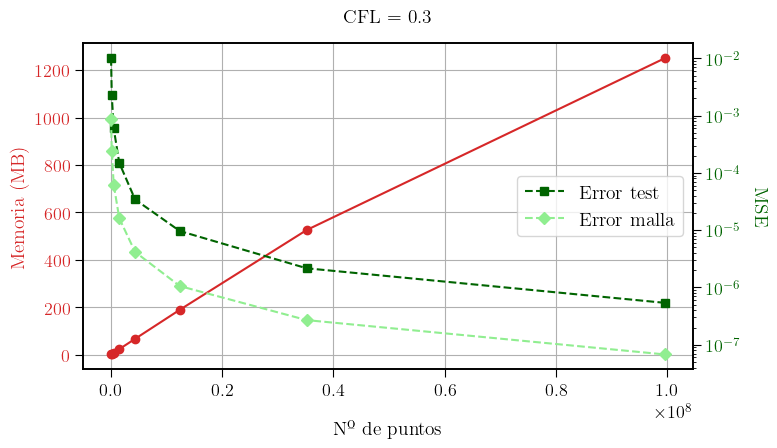

In [ ]:

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("CFL = 0.3", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria
color1 = 'tab:red'
ax1.set_xlabel("Nº de puntos", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(puntos, memorias, 'o-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Error (MSE)
ax2 = ax1.twinx()  
color2 = '#006400'
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(puntos, errores, 's--', color=color2, label="Error test")
ax2.plot(puntos,errores1, 'D--', color="#90ee90", label="Error malla")
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)
plt.legend(loc='center right')

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

#### Manteniendo un CFL de 0.2

In [ ]:
Nx = 0
errores1 = []
memorias13 = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.2

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)

    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias13.append(mem_consumo)
    
    X1, T1 = np.meshgrid(x, t, indexing='ij')
    M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])
    u_exacta = u_xt(M_combined1)+Kelvin
    error = np.mean((U - u_exacta.reshape(X1.shape))**2)
    errores1.append(error)

CFL: 0.1845
CFL: 0.1875
CFL: 0.1912
CFL: 0.1948
CFL: 0.1964
CFL: 0.1972
CFL: 0.1982
CFL: 0.1985


In [ ]:
Nx = 0
errores = []
memorias = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.2

x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)
X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

puntos = (np.array(NxL) * np.array(NtL)).tolist()

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.1,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias.append(mem_consumo)
    
    error = errorMDF(U,x,t,X_test)
    errores.append(error)

CFL: 0.1845
CFL: 0.1845
CFL: 0.1875
CFL: 0.1875
CFL: 0.1912
CFL: 0.1948
CFL: 0.1964
CFL: 0.1972
CFL: 0.1982
CFL: 0.1985


In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasMDFCFL2.txt', memorias)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasMDFCFL2.txt')

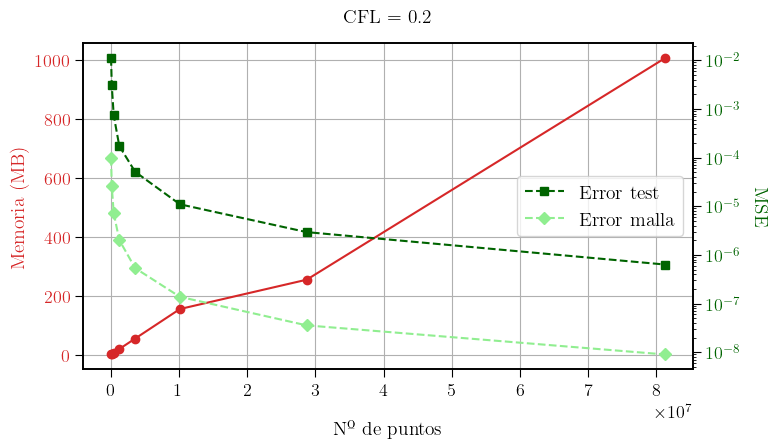

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("CFL = 0.2", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria
color1 = 'tab:red'
ax1.set_xlabel("Nº de puntos", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(puntos, memorias, 'o-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Error (MSE)
ax2 = ax1.twinx()  
color2 = '#006400'
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(puntos, errores, 's--', color=color2, label="Error test")
ax2.plot(puntos,errores1, 'D--', color="#90ee90", label="Error malla")
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)
plt.legend(loc='center right')

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# PINNs

In [7]:
# Funciones a llamar durante el entrenameinto de la PINN.

def ICreescaladox(x):
    y = x[:, 0:1] * L  # Reescalar x a la longitud de la barra.
    u = 50 * tf.exp(-10 * tf.square(y - 2)) * (5 - y) * y
    return u / F  # Pico de 300 ºC en x=2.

def EDPreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D/(L**2))*du_xx - K*u  # Reescalar x a la longitud de la barra.

def u_xt1reescaladox(x):
    y = np.copy(x)      # Reescalar x a la longitud de la barra.
    y[:,0:1] = y[:,0:1]*L
    return u_xt(y) / F  # Escalar la solución.

# EDP: u_t = u_xx + u.
def EDPsinreescalarx(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D)*du_xx - K*u

def u_xt1(x):
    return u_xt(x) / F  # Escalar la solución.

def IC(x):
    u = 50 * tf.exp(-10 * tf.square(x[:,0:1] - 2)) * (5 - x[:,0:1]) * x[:,0:1]
    return u / F  # Pico de 300 ºC en x=2.

# vanilla-PINN

### Modelo menos complejo (PINN 1)

Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

#### Tiempo de entrenamiento

In [1]:
F = 1  # Reescalado.

In [8]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory133, train_state = model.train(iterations=7500,display_every=7500)

Compiling model...
Building feed-forward neural network...
'build' took 0.025641 s

'compile' took 0.151435 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.77e-01, 4.23e-03, 1.27e+00, 7.18e+03]    [3.77e-01, 4.23e-03, 1.27e+00, 7.18e+03]    [2.82e+03]    


I0000 00:00:1750721081.960466   24701 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


7500      [8.38e+01, 3.36e+00, 5.43e+00, 6.39e+01]    [5.22e+01, 3.36e+00, 5.43e+00, 6.39e+01]    [2.04e+00]    

Best model at step 7500:
  train loss: 1.57e+02
  test loss: 1.25e+02
  test metric: [2.04e+00]

'train' took 8.677028 s

CPU times: user 8.69 s, sys: 1.75 s, total: 10.4 s
Wall time: 8.87 s


: 

#### Consumo de memoria

In [9]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [10]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
mem_cb = MemoryCallback()
losshistory133, train_state = model.train(iterations=7500,display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.024722 s

'compile' took 0.148979 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.65e+00, 8.96e-03, 4.06e+00, 7.01e+03]    [1.66e+00, 8.96e-03, 4.06e+00, 7.01e+03]    [2.62e+03]    


I0000 00:00:1751390718.286344  140959 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [2.52e+00, 2.50e-02, 6.27e+00, 6.98e+03]    [2.55e+00, 2.50e-02, 6.27e+00, 6.98e+03]    [2.58e+03]    
2         [3.53e+00, 5.38e-02, 8.83e+00, 6.95e+03]    [3.57e+00, 5.38e-02, 8.83e+00, 6.95e+03]    [2.55e+03]    
3         [4.64e+00, 9.57e-02, 1.16e+01, 6.93e+03]    [4.69e+00, 9.57e-02, 1.16e+01, 6.93e+03]    [2.52e+03]    
4         [5.81e+00, 1.52e-01, 1.46e+01, 6.91e+03]    [5.88e+00, 1.52e-01, 1.46e+01, 6.91e+03]    [2.49e+03]    
5         [7.02e+00, 2.24e-01, 1.76e+01, 6.88e+03]    [7.12e+00, 2.24e-01, 1.76e+01, 6.88e+03]    [2.47e+03]    
6         [8.28e+00, 3.14e-01, 2.06e+01, 6.86e+03]    [8.40e+00, 3.14e-01, 2.06e+01, 6.86e+03]    [2.44e+03]    
7         [9.58e+00, 4.23e-01, 2.37e+01, 6.84e+03]    [9.72e+00, 4.23e-01, 2.37e+01, 6.84e+03]    [2.42e+03]    
8         [1.09e+01, 5.51e-01, 2.67e+01, 6.83e+03]    [1.11e+01, 5.51e-01, 2.67e+01, 6.83e+03]    [2.39e+03]    
9         [1.23e+01, 6.96e-01, 2.96e+01, 6.81e+03]    [1.25e+01, 6.96e-01, 2.96e+01, 6.81e+03]  

In [11]:
memoria_por_epoca = mem_cb.get_memory()
metrictest = losshistory133.metrics_test
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasvanillaPINN1.txt', memoria_por_epoca)

In [12]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasvanillaPINN1.txt')

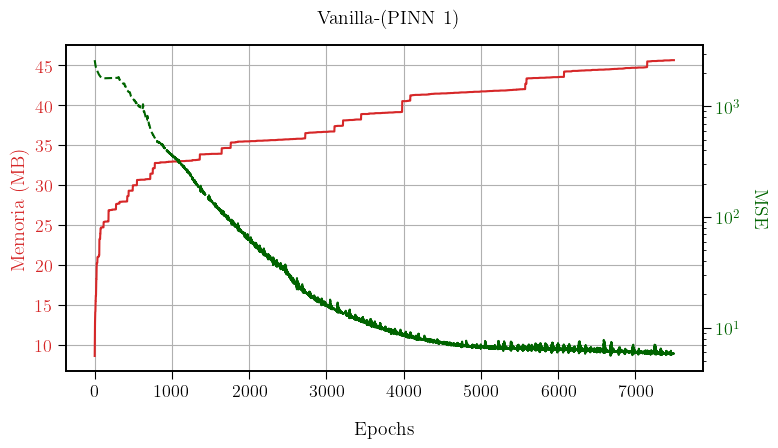

In [13]:
metrictest = losshistory133.metrics_test

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Vanilla-(PINN 1)", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400' 
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [19]:
max(memorias)

45.640625

#### Realización de vídeo y gráficas relevantes.

In [20]:
# Callback para guardar las predicciones cada 100 iteraciones.
        
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X  # Puntos donde quieres evaluar la solución (np.array)
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101
# Crear malla de puntos.
x = np.linspace(0, L, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model,XT, save_every=100)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory133, train_state = model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])

Compiling model...
Building feed-forward neural network...
'build' took 0.021696 s

'compile' took 0.141924 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.46e-01, 3.11e-01, 7.32e-03, 7.15e+03]    [2.07e-01, 3.11e-01, 7.32e-03, 7.15e+03]    [2.75e+03]    
1         [1.43e-01, 4.09e-01, 4.34e-01, 7.11e+03]    [1.17e-01, 4.09e-01, 4.34e-01, 7.11e+03]    [2.71e+03]    
2         [3.28e-01, 5.24e-01, 1.59e+00, 7.08e+03]    [3.15e-01, 5.24e-01, 1.59e+00, 7.08e+03]    [2.67e+03]    
3         [7.69e-01, 6.55e-01, 3.36e+00, 7.04e+03]    [7.71e-01, 6.55e-01, 3.36e+00, 7.04e+03]    [2.63e+03]    
4         [1.42e+00, 8.02e-01, 5.59e+00, 7.01e+03]    [1.43e+00, 8.02e-01, 5.59e+00, 7.01e+03]    [2.59e+03]    
5         [2.23e+00, 9.65e-01, 8.12e+00, 6.98e+03]    [2.26e+00, 9.65e-01, 8.12e+00, 6.98e+03]    [2.56e+03]    
6         [3.16e+00, 1.15e+00, 1.08e+01, 6.96e+03]    [3.20e+00, 1.15e+00, 1.08

In [24]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

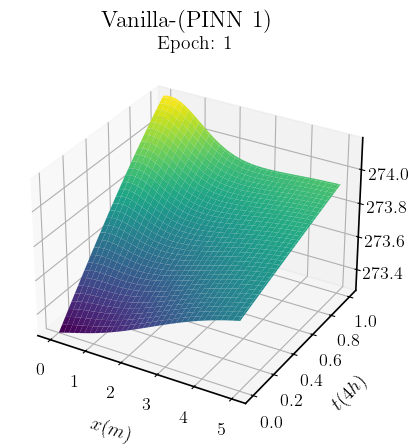

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='viridis')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("Vanilla-(PINN 1)")
    ax.set_xlabel("$x(m)$", labelpad=10)
    ax.set_ylabel("$t(4h)$", labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$", labelpad=10)

    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

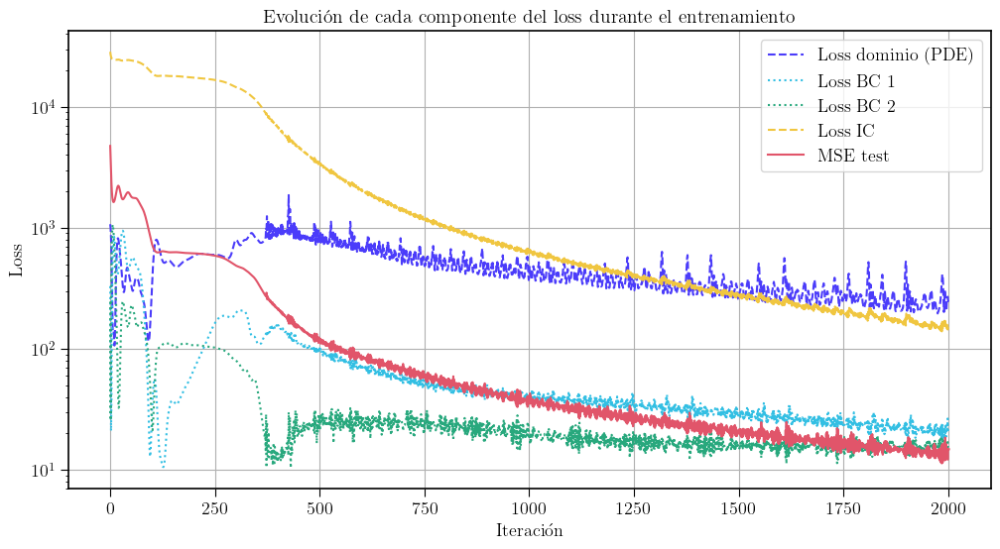

In [ ]:
loss_train = np.array(losshistory133.loss_train)*F**2
testmetric = np.array(losshistory133.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D",  
    "#F0C640", 
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Vanilla-(PINN 1)")
plt.legend()
plt.grid(True)
plt.show()


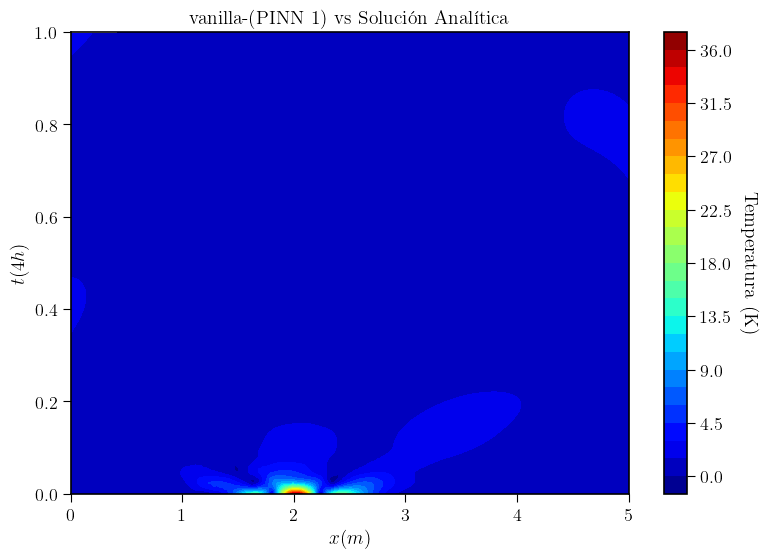

In [ ]:
test_points = geomtime.uniform_points(10201, True) 
y_pred = model.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt1(test_points)*F          # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true) 

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 300)
t_grid = np.linspace(0, T_max, 300)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("vanilla-(PINN 1) vs Solución Analítica")
plt.show()

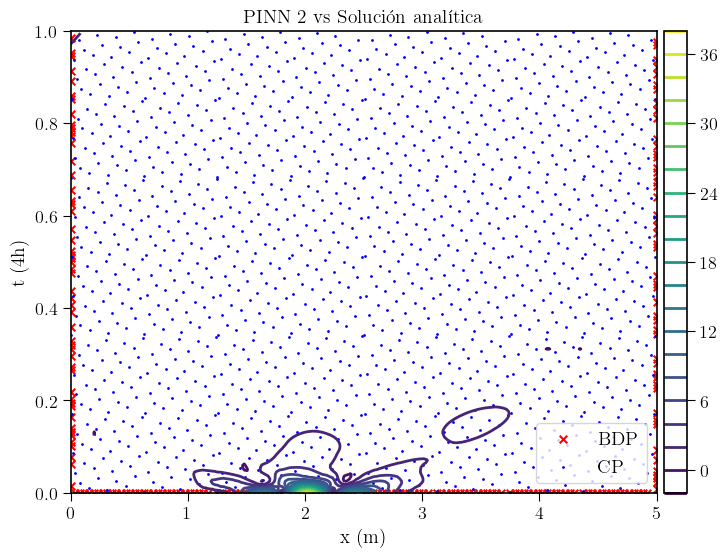

In [ ]:
# Extraer puntos de collocation, boundary e inicial.
collocation_points = data.train_x   # Todos los puntos de entrenamiento.
boundary_points = data.bc_points()  # Puntos de frontera.

# Convertir ambos a tuplas para poder comparar
all_points_tuples = set(map(tuple, collocation_points))
boundary_points_tuples = set(map(tuple, boundary_points))

# Collocation points = todos los puntos menos los de frontera/inicial.
collocation_points_tuples = all_points_tuples - boundary_points_tuples
collocation_points = np.array(list(collocation_points_tuples))

plt.figure(figsize=(9, 6))

cont = plt.contour(X, T, error_grid, 20, linewidths=2)
plt.colorbar(cont, pad=+0.01)

plt.scatter(boundary_points[:, 0], boundary_points[:, 1], marker="x", c="r", s=30, label="BDP")

plt.scatter(collocation_points[:, 0], collocation_points[:, 1], s=4, marker=".", c="b", label="CP")

plt.xlabel("x (m)")
plt.ylabel("t (4h)")
plt.title("PINN 2 vs Solución analítica")
plt.legend(loc='lower right')
plt.show()

In [ ]:
# MSE
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 2.5501


### Modelo más complejo (PINN 2)
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.001

Reescalado de la salida: u* = u/100

Reescalado de la entrada espacial: x* = x/L

Peso de la función error IC: 4

Peso de la función de pérdida del dominio: 2

Demás pesos de la función de pérdida: 1

#### Tiempo de entrenamiento

In [26]:
# Escala la función.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time

# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=7500)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.032206 s

'compile' took 0.208812 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.62e-01, 9.42e-02, 1.92e-01, 3.15e+00]    [1.39e-01, 9.42e-02, 1.92e-01, 3.15e+00]    [7.43e-01]    
7500      [7.06e-03, 5.93e-04, 1.19e-03, 2.05e-03]    [1.08e-02, 5.93e-04, 1.19e-03, 2.05e-03]    [3.46e-04]    

Best model at step 7500:
  train loss: 1.09e-02
  test loss: 1.46e-02
  test metric: [3.46e-04]

'train' took 84.525527 s

Compiling model...
'compile' took 0.118417 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
7500      [7.06e-03, 5.93e-04, 1.19e-03, 2.05e-03]    [1.08e-02, 5.93e-04, 1.19e-03, 2.05e-03]    [3.46e-04]    
INFO:tensorflow:Optimization terminated with:
  Message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  Objective

: 

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101 
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
mem_cb = MemoryCallback()
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.031537 s

'compile' took 0.222677 s

Training model...

0         [3.18e-01, 5.13e-02, 1.86e-02, 2.71e+00]    [1.97e-01, 5.13e-02, 1.86e-02, 2.71e+00]    [4.71e-01]    
1         [1.99e-01, 1.17e-02, 1.13e-02, 2.61e+00]    [1.38e-01, 1.17e-02, 1.13e-02, 2.61e+00]    [3.34e-01]    
2         [1.04e-01, 1.04e-03, 4.20e-02, 2.55e+00]    [8.50e-02, 1.04e-03, 4.20e-02, 2.55e+00]    [2.49e-01]    
3         [4.29e-02, 1.26e-02, 7.71e-02, 2.52e+00]    [4.46e-02, 1.26e-02, 7.71e-02, 2.52e+00]    [2.02e-01]    
4         [1.66e-02, 3.50e-02, 9.58e-02, 2.51e+00]    [2.15e-02, 3.50e-02, 9.58e-02, 2.51e+00]    [1.79e-01]    
5         [1.35e-02, 5.72e-02, 9.44e-02, 2.50e+00]    [1.31e-02, 5.72e-02, 9.44e-02, 2.50e+00]    [1.70e-01]    
6         [1.67e-02, 7.31e-02, 8.00e-02, 2.50e+00]    [1.14e-02, 7.31e-02, 8.00e-02, 2.50e+00]    [1.67e-01]    
7         [1.57e-02, 8.14e-02, 6.17e-02, 2.50e+00]    [9.96e-03, 8.14e-02, 6.17

In [ ]:
memoria_por_epoca = mem_cb.get_memory()
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasVanillaPINN2.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasVanillaPINN2.txt')

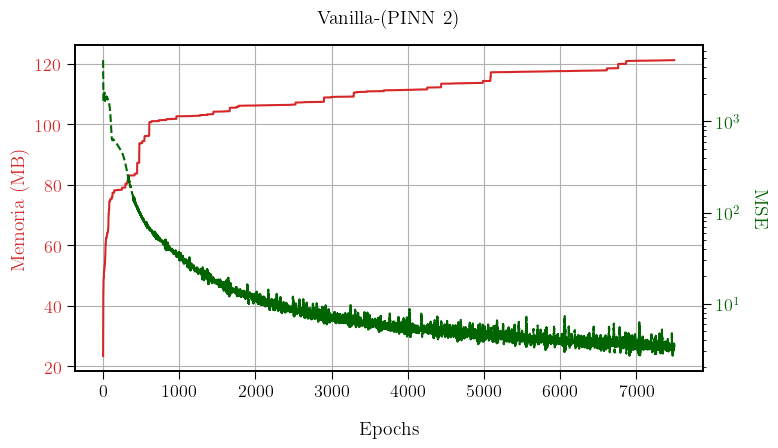

: 

In [ ]:
metrictest = np.array(losshistory1.metrics_test)*F**2

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Vanilla-(PINN 2)", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400' 
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


In [13]:
max(memorias)

121.234375

#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
        
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X  
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [20]:
# Escala la función.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, 1, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model,XT, save_every=100)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.045281 s

'compile' took 0.232505 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.93e-02, 4.08e-02, 4.42e-01, 2.60e+00]    [6.82e-02, 4.08e-02, 4.42e-01, 2.60e+00]    [1.87e-01]    
1         [3.99e-02, 1.14e-02, 1.84e-01, 2.64e+00]    [2.88e-02, 1.14e-02, 1.84e-01, 2.64e+00]    [1.94e-01]    
2         [1.06e-02, 1.80e-03, 6.45e-02, 2.70e+00]    [8.26e-03, 1.80e-03, 6.45e-02, 2.70e+00]    [2.34e-01]    
3         [4.47e-03, 1.96e-04, 1.99e-02, 2.72e+00]    [4.36e-03, 1.96e-04, 1.99e-02, 2.72e+00]    [2.77e-01]    
4         [2.88e-02, 1.87e-03, 7.65e-03, 2.69e+00]    [2.07e-02, 1.87e-03, 7.65e-03, 2.69e+00]    [3.03e-01]    
5         [7.29e-02, 3.30e-03, 6.90e-03, 2.63e+00]    [5.21e-02, 3.30e-03, 6.90e-03, 2.63e+00]    [3.07e-01]    
6         [1.13e-01, 3.21e-03, 1.09e-02, 2.57e+00]    [8.36e-02, 3.21e-03, 1.09

In [23]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

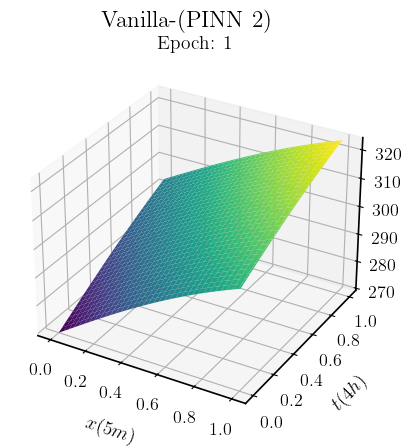

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='viridis')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("Vanilla-(PINN 2)")
    ax.set_xlabel("$x(5m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

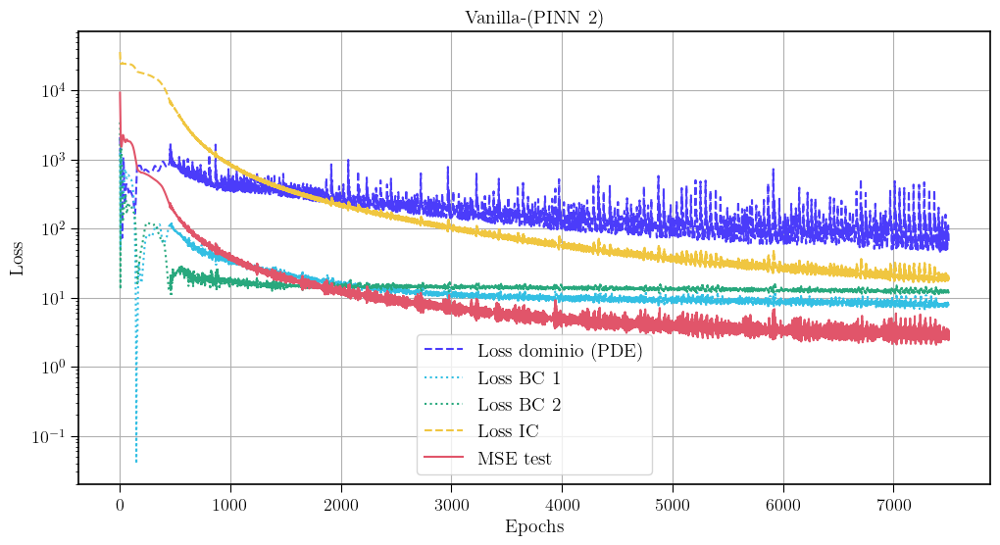

In [ ]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D",  
    "#F0C640", 
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (PDE)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Vanilla-(PINN 2)")
plt.legend()
plt.grid(True)
plt.show()

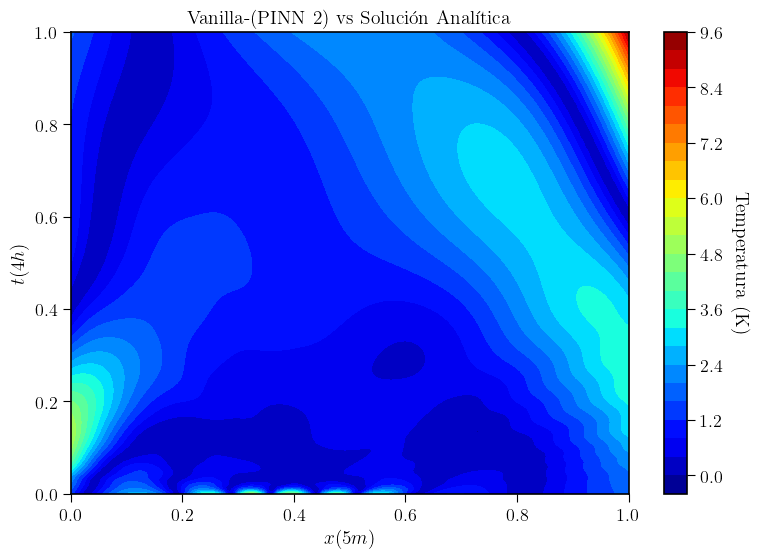

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True) 
y_pred = model.predict(test_points)*F     # Reescalar la predicción
y_true = u_xt1reescaladox(test_points)*F  # Reescalar la solución analítica

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, Lscalado, 200)
t_grid = np.linspace(0, T_max, 200)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (5m)$")
plt.ylabel("$t (4h)$")
plt.title("Vanilla-(PINN 2) vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 2.9231


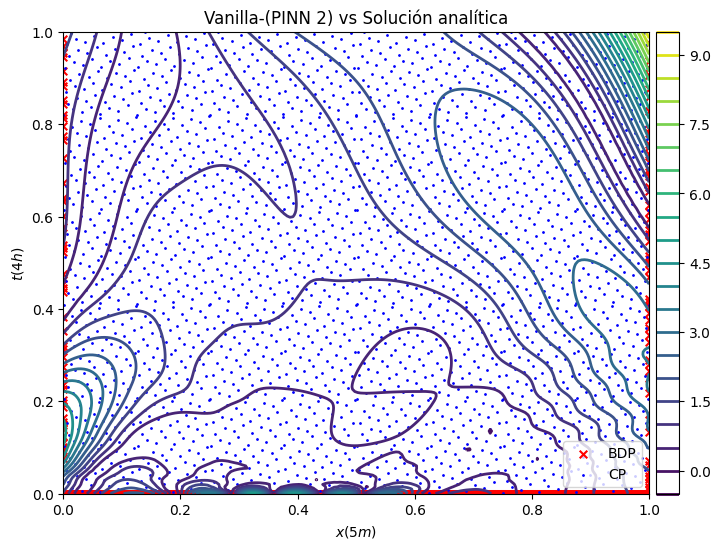

In [ ]:
# Extraer puntos de collocation, boundary e inicial.
collocation_points = data.train_x   # Todos los puntos de entrenamiento.
boundary_points = data.bc_points()  # Puntos de frontera.

all_points_tuples = set(map(tuple, collocation_points))
boundary_points_tuples = set(map(tuple, boundary_points))

# Collocation points = todos los puntos menos los de frontera/inicial.
collocation_points_tuples = all_points_tuples - boundary_points_tuples
collocation_points = np.array(list(collocation_points_tuples))

plt.figure(figsize=(9, 6))

cont = plt.contour(X, T, error_grid, 20, linewidths=2)
plt.colorbar(cont, pad=+0.01)

plt.scatter(boundary_points[:, 0], boundary_points[:, 1], marker="x", c="r", s=30, label="BDP")

plt.scatter(collocation_points[:, 0], collocation_points[:, 1], s=4, marker=".", c="b", label="CP")

plt.xlabel("$x(5m)$")
plt.ylabel("$t(4h)$")
plt.title("Vanilla-(PINN 2) vs Solución analítica")
plt.legend(loc='lower right')
plt.show()

# hard-PINN

Se utilizan ambos modelos de vanilla-PINN encontrados para estudiar la generalización con hard-PINN.

### Modelo menos complejo

#### Tiempo de entrenamiento

In [33]:
# Reescalar la solución.
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time

layer_size = [2] + [16] * 2 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net1 = dde.nn.FNN(layer_size, activation, initializer)


# Condición inicial compatible con tensores.
def ICtf(x):
    return 50 * tf.exp(-10 * (x - 2)**2)*(5-x)*x  # Pico de 200 ºC en x=2.

def output_transform(x, y):
    x0 = x[:, 0:1]
    t = x[:, 1:2]
    g = ICtf(x0)
    return (g + x0 * (L - x0) * t * y)/F

# Reemplazar salida por el ansatz.
net1.apply_output_transform(
        lambda x, y: output_transform(x,y)
)


# Dataset solo necesita ecuación diferencial y dominio.
data1 = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [],
    num_domain=1500,
    solution=u_xt1,
    num_test=10201,
)

# Modelo.
model1 = dde.Model(data1, net1)
model1.compile("adam", lr=0.01, metrics=["MSE"])
losshistory341, train_state = model1.train(iterations=7500, display_every=7500)

Compiling model...
Building feed-forward neural network...
'build' took 0.029424 s

'compile' took 0.301831 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [5.32e+06]    [5.34e+06]    [4.19e+03]    
7500      [1.08e+05]    [4.95e+05]    [1.25e+03]    

Best model at step 7500:
  train loss: 1.08e+05
  test loss: 4.95e+05
  test metric: [1.25e+03]

'train' took 10.989254 s

CPU times: user 11.3 s, sys: 2.42 s, total: 13.7 s
Wall time: 11.3 s


#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()  
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
layer_size = [2] + [16] * 2 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net1 = dde.nn.FNN(layer_size, activation, initializer)


# Condición inicial compatible con tensores.
def ICtf(x):
    return 50 * tf.exp(-10 * (x - 2)**2)*(5-x)*x  # Pico de 200 ºC en x=2.

def output_transform(x, y):
    x0 = x[:, 0:1]
    t = x[:, 1:2]
    g = ICtf(x0)
    return (g + x0 * (L - x0) * t * y)

# Reemplazar salida por el ansatz.
net1.apply_output_transform(
        lambda x, y: output_transform(x,y)
)


# Dataset solo necesita ecuación diferencial y dominio.
data1 = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [], 
    num_domain=1500,
    solution=u_xt1,
    num_test=10201,
)

# Modelo.
model = dde.Model(data1, net1)
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
losshistory341, train_state = model.train(iterations=7500, display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.031249 s

'compile' took 0.232336 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [5.32e+06]    [5.34e+06]    [4.19e+03]    


I0000 00:00:1750727011.544036   18450 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [5.32e+06]    [5.34e+06]    [4.19e+03]    
2         [5.32e+06]    [5.34e+06]    [4.19e+03]    
3         [5.32e+06]    [5.34e+06]    [4.19e+03]    
4         [5.32e+06]    [5.34e+06]    [4.19e+03]    
5         [5.32e+06]    [5.34e+06]    [4.19e+03]    
6         [5.32e+06]    [5.34e+06]    [4.19e+03]    
7         [5.32e+06]    [5.34e+06]    [4.19e+03]    
8         [5.32e+06]    [5.34e+06]    [4.19e+03]    
9         [5.32e+06]    [5.34e+06]    [4.19e+03]    
10        [5.32e+06]    [5.34e+06]    [4.19e+03]    
11        [5.32e+06]    [5.34e+06]    [4.19e+03]    
12        [5.32e+06]    [5.34e+06]    [4.19e+03]    
13        [5.32e+06]    [5.34e+06]    [4.19e+03]    
14        [5.32e+06]    [5.34e+06]    [4.19e+03]    
15        [5.32e+06]    [5.34e+06]    [4.19e+03]    
16        [5.32e+06]    [5.34e+06]    [4.19e+03]    
17        [5.32e+06]    [5.34e+06]    [4.19e+03]    
18        [5.31e+06]    [5.34e+06]    [4.19e+03]    
19        [5.31e+06]    [5.34e+06]    [4.19e+0

In [10]:
memoria_por_epoca = mem_cb.get_memory()

In [11]:
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('memoriashardPINN1.txt', memoria_por_epoca)


In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriashardPINN1.txt')

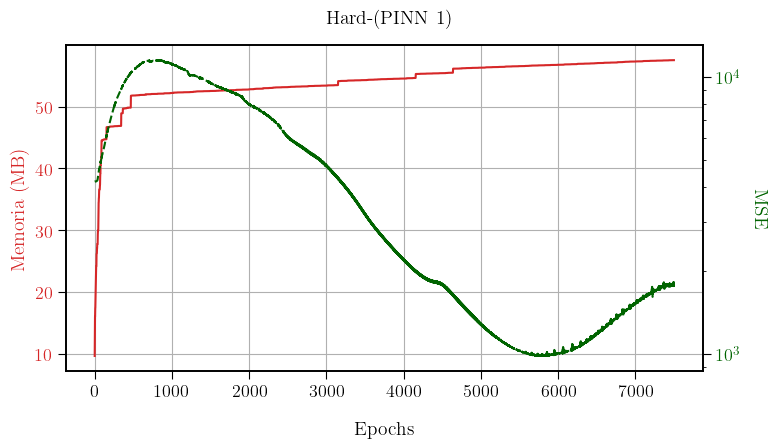

In [ ]:
metrictest = losshistory341.metrics_test

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Hard-(PINN 1)", fontsize=14, y = 0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400' 
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [15]:
max(memorias)

57.5

#### Realización de vídeo y gráficas relevantes.

In [8]:
# Reescalar la solución.
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
        
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
layer_size = [2] + [16] * 2 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net1 = dde.nn.FNN(layer_size, activation, initializer)


# Condición inicial compatible con tensores.
def ICtf(x):
    return 50 * tf.exp(-10 * (x - 2)**2)*(5-x)*x  # Pico de 200 ºC en x=2.

def output_transform(x, y):
    x0 = x[:, 0:1]
    t = x[:, 1:2]
    g = ICtf(x0)/F
    return (g + x0 * (L - x0) * t * y)

# Reemplazar salida por el ansatz.
net1.apply_output_transform(
        lambda x, y: output_transform(x,y)
)

# Dataset solo necesita ecuación diferencial y dominio.
data1 = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [], 
    num_domain=1500,
    solution=u_xt1,
    num_test=10201,
)

Nx, Nt = 101, 101  
# Crear malla de puntos.
x = np.linspace(0, L, Nx)
t = np.linspace(0, 1, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model1 = dde.Model(data1, net1)
PredictionLogger = PredictionLogger(model1, XT, save_every=100)
model1.compile("adam", lr=0.01, metrics=["MSE"])
losshistory341, train_state = model1.train(iterations=7500, display_every=1, callbacks=[PredictionLogger])

Compiling model...
Building feed-forward neural network...
'build' took 0.029125 s

'compile' took 0.234562 s

Training model...

0         [5.32e+06]    [5.34e+06]    [4.21e+03]    
1         [5.32e+06]    [5.34e+06]    [4.21e+03]    
2         [5.32e+06]    [5.34e+06]    [4.20e+03]    
3         [5.32e+06]    [5.34e+06]    [4.20e+03]    
4         [5.32e+06]    [5.34e+06]    [4.20e+03]    
5         [5.32e+06]    [5.34e+06]    [4.19e+03]    
6         [5.32e+06]    [5.34e+06]    [4.19e+03]    
7         [5.32e+06]    [5.34e+06]    [4.19e+03]    
8         [5.32e+06]    [5.34e+06]    [4.19e+03]    
9         [5.32e+06]    [5.34e+06]    [4.19e+03]    
10        [5.32e+06]    [5.34e+06]    [4.19e+03]    
11        [5.32e+06]    [5.34e+06]    [4.19e+03]    
12        [5.32e+06]    [5.34e+06]    [4.19e+03]    
13        [5.32e+06]    [5.34e+06]    [4.19e+03]    
14        [5.32e+06]    [5.34e+06]    [4.19e+03]    
15        [5.32e+06]    [5.34e+06]    [4.19e+03]    
16        [5.32e+06]  

In [20]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

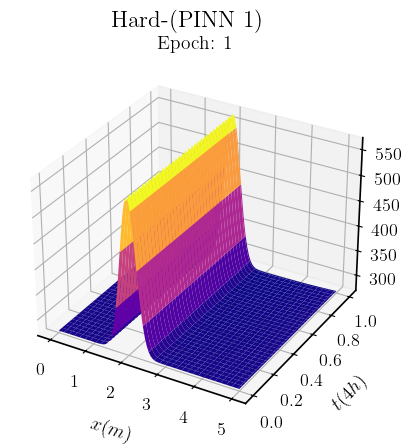

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='plasma')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("Hard-(PINN 1)")
    ax.set_xlabel("$x(m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

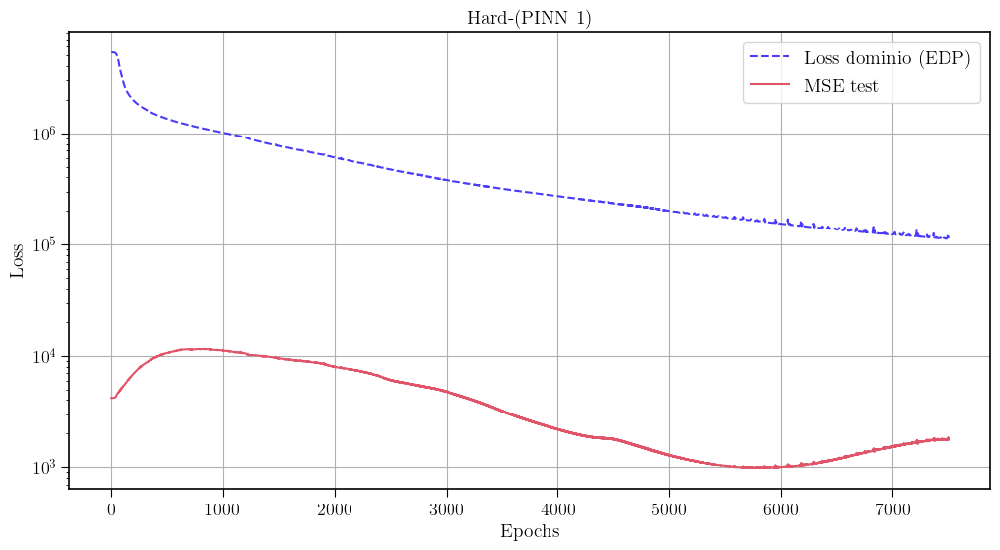

In [ ]:
loss_train = np.array(losshistory341.loss_train)*F**2
testmetric156 = np.array(losshistory341.metrics_test)*F**2

colors = [
    "#4B3CFA",
    "#33BFE3",  
    "#28A87D",  
    "#F0C640", 
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])

plt.plot(testmetric156[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Hard-(PINN 1)")
plt.legend()
plt.grid(True)
plt.show()

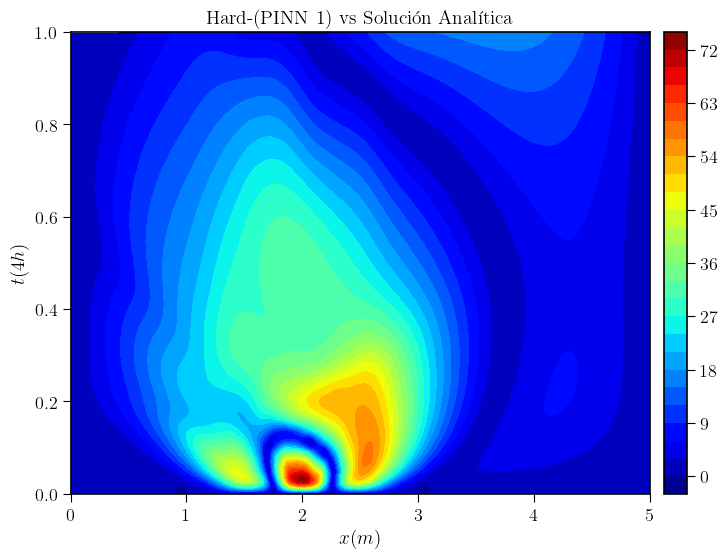

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True) 
y_pred = model1.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt1(test_points)*F           # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 300)
t_grid = np.linspace(0, T_max, 300)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp, pad=0.02)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("Hard-(PINN 1) vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 1714.2589


### Modelo más complejo

#### Tiempo de entrenamiento

In [6]:
# Reescalar la solución.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time

layer_size = [2] + [32] * 4 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net1 = dde.nn.FNN(layer_size, activation, initializer)


# Condición inicial compatible con tensores.
def ICtfreescaldox(x):
    return 50 * tf.exp(-10 * (x - 2)**2)*(5-x)*x  # Pico de 200 ºC en x=2.

def output_transformreescaladox(x, y):
    x0 = x[:, 0:1]*L
    t = x[:, 1:2]
    g = ICtfreescaldox(x0)/F
    return (g + x0 * (L - x0) * t * y)

# Reemplazar salida por el ansatz.
net1.apply_output_transform(
    lambda x, y: output_transformreescaladox(x,y)
)

# Dataset solo necesita ecuación diferencial y dominio.
data1 = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [],  
    num_domain=2500,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Modelo.
model1 = dde.Model(data1, net1)
model1.compile("adam", lr=0.001, metrics=["MSE"])
model1.train(iterations=7500,display_every=7500)
model1.compile("L-BFGS",metrics=["MSE"])
losshistory65, train_state = model1.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.039153 s

'compile' took 0.326153 s

Training model...

0         [5.41e+02]    [5.48e+02]    [2.65e+00]    
7500      [2.81e-01]    [2.14e-01]    [1.23e-04]    

Best model at step 7500:
  train loss: 2.81e-01
  test loss: 2.14e-01
  test metric: [1.23e-04]

'train' took 59.240902 s

Compiling model...
'compile' took 0.150949 s

Training model...

Step      Train loss    Test loss     Test metric   
7500      [2.81e-01]    [2.14e-01]    [1.23e-04]    
INFO:tensorflow:Optimization terminated with:
  Message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  Objective function value: 0.281221
  Number of iterations: 1
  Number of functions evaluations: 35
7516      [2.81e-01]    [2.14e-01]    [1.23e-04]    

Best model at step 7500:
  train loss: 2.81e-01
  test loss: 2.14e-01
  test metric: [1.23e-04]

'train' took 0.848796 s

CPU times: user 1min 19s, sys: 33.4 s, total: 1min 52s
Wall time: 1min


#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()  
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
layer_size = [2] + [32] * 4 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net1 = dde.nn.FNN(layer_size, activation, initializer)

# Condición inicial compatible con tensores.
def ICtfreescaldox(x):
    return 50 * tf.exp(-10 * (x - 2)**2)*(5-x)*x  # Pico de 200 ºC en x=2.

def output_transformreescaladox(x, y):
    x0 = x[:, 0:1]*L
    t = x[:, 1:2]
    g = ICtfreescaldox(x0)/F
    return (g + x0 * (L - x0) * t * y)

# Reemplazar salida por el ansatz.
net1.apply_output_transform(
    lambda x, y: output_transformreescaladox(x,y)
)

# Dataset solo necesita ecuación diferencial y dominio.
data1 = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [],  
    num_domain=2500,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Modelo.
model1 = dde.Model(data1, net1)
model1.compile("adam", lr=0.001, metrics=["MSE"])
mem_cb = MemoryCallback()
model1.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model1.compile("L-BFGS",metrics=["MSE"])
losshistory65, train_state = model1.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.040243 s

'compile' took 0.304311 s

Training model...



I0000 00:00:1750728809.647480   16053 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


Step      Train loss    Test loss     Test metric   
0         [5.50e+02]    [5.57e+02]    [4.72e+00]    
1         [5.44e+02]    [5.50e+02]    [3.08e+00]    
2         [5.40e+02]    [5.46e+02]    [1.85e+00]    
3         [5.36e+02]    [5.42e+02]    [1.02e+00]    
4         [5.34e+02]    [5.40e+02]    [5.63e-01]    
5         [5.33e+02]    [5.39e+02]    [4.41e-01]    
6         [5.32e+02]    [5.38e+02]    [5.68e-01]    
7         [5.33e+02]    [5.39e+02]    [8.27e-01]    
8         [5.33e+02]    [5.39e+02]    [1.10e+00]    
9         [5.34e+02]    [5.39e+02]    [1.29e+00]    
10        [5.34e+02]    [5.40e+02]    [1.35e+00]    
11        [5.33e+02]    [5.39e+02]    [1.30e+00]    
12        [5.33e+02]    [5.39e+02]    [1.17e+00]    
13        [5.33e+02]    [5.39e+02]    [9.85e-01]    
14        [5.32e+02]    [5.38e+02]    [7.99e-01]    
15        [5.32e+02]    [5.38e+02]    [6.37e-01]    
16        [5.31e+02]    [5.37e+02]    [5.19e-01]    
17        [5.31e+02]    [5.37e+02]    [4.53e-0

In [11]:
memoria_por_epoca = mem_cb.get_memory()

In [12]:
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('memoriashardPINN2.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriashardPINN2.txt')

In [ ]:
metrictest = np.array(losshistory65.metrics_test)*F**2

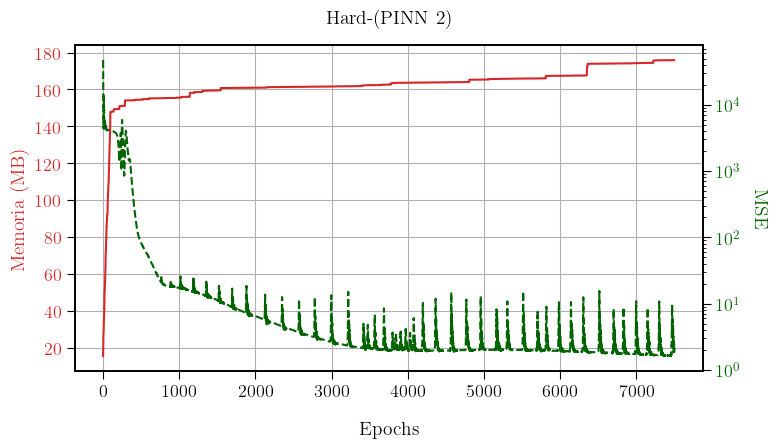

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Hard-(PINN 2)", fontsize=14, y =0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400' 
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [17]:
max(memorias)

175.890625

#### Realización de vídeo y gráficas relevantes.

In [16]:
# Reescalar la solución.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=50):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
# Configurar la red neuronal
layer_size = [2] + [32] * 4 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net1 = dde.nn.FNN(layer_size, activation, initializer)


# Condición inicial compatible con tensores.
def ICtfreescaldox(x):
    return 50 * tf.exp(-10 * (x - 2)**2)*(5-x)*x  # Pico de 200 ºC en x=2.

def output_transformreescaladox(x, y):
    x0 = x[:, 0:1]*L
    t = x[:, 1:2]
    g = ICtfreescaldox(x0)/F
    return (g + x0 * (L - x0) * t * y)

# Reemplazar salida por el ansatz.
net1.apply_output_transform(
    lambda x, y: output_transformreescaladox(x,y)
)

# Dataset solo necesita ecuación diferencial y dominio.
data1 = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [], 
    num_domain=2500,
    solution=u_xt1reescaladox,
    num_test=10201,
)

Nx, Nt = 101, 101  
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model1 = dde.Model(data1, net1)
PredictionLogger = PredictionLogger(model1, XT, save_every=25)
model1.compile("adam", lr=0.001, metrics=["MSE"])
model1.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])
model1.compile("L-BFGS",metrics=["MSE"])
losshistory65, train_state = model1.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.044070 s

'compile' took 0.325597 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [5.38e+02]    [5.44e+02]    [1.60e+00]    
1         [5.36e+02]    [5.42e+02]    [1.16e+00]    
2         [5.34e+02]    [5.40e+02]    [8.35e-01]    
3         [5.33e+02]    [5.39e+02]    [6.14e-01]    
4         [5.32e+02]    [5.38e+02]    [4.80e-01]    
5         [5.32e+02]    [5.37e+02]    [4.19e-01]    
6         [5.31e+02]    [5.37e+02]    [4.15e-01]    
7         [5.31e+02]    [5.37e+02]    [4.50e-01]    
8         [5.31e+02]    [5.37e+02]    [5.07e-01]    
9         [5.32e+02]    [5.37e+02]    [5.68e-01]    
10        [5.32e+02]    [5.38e+02]    [6.18e-01]    
11        [5.32e+02]    [5.38e+02]    [6.49e-01]    
12        [5.32e+02]    [5.38e+02]    [6.59e-01]    
13        [5.32e+02]    [5.38e+02]    [6.49e-01]    
14        [5.32e+02]    [5.38e+02]    [6.24e-01]    
15        [5.32e+02]  

In [26]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

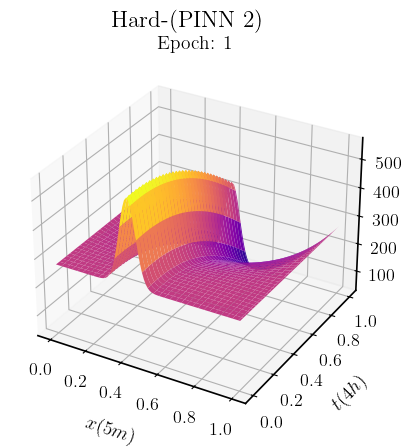

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='plasma')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("Hard-(PINN 2)")
    ax.set_xlabel("$x(5m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=300)
HTML(anim5.to_html5_video())

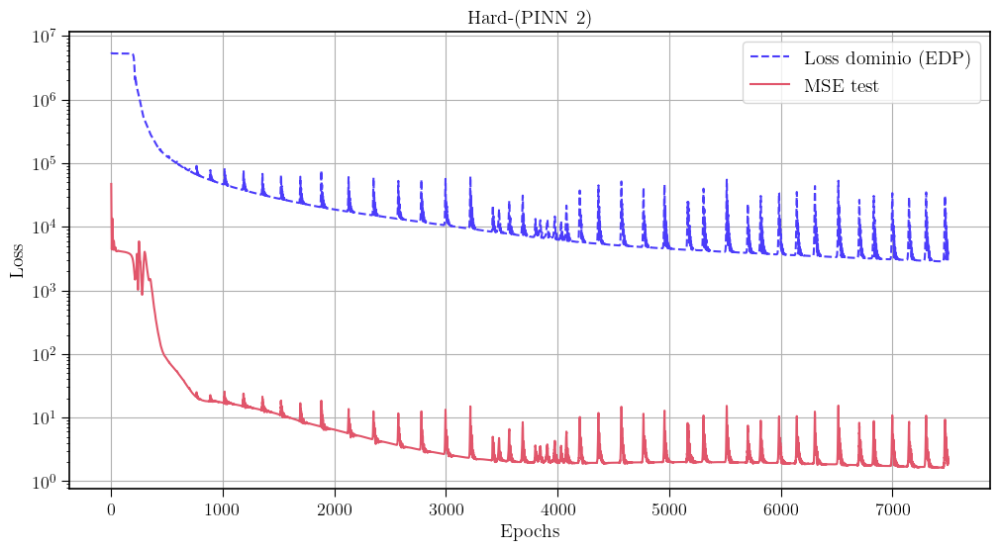

In [ ]:
loss_train = np.array(losshistory65.loss_train)*F**2
testmetric65 = np.array(losshistory65.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D", 
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])

plt.plot(testmetric65[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Hard-(PINN 2)")
plt.legend()
plt.grid(True)
plt.show()

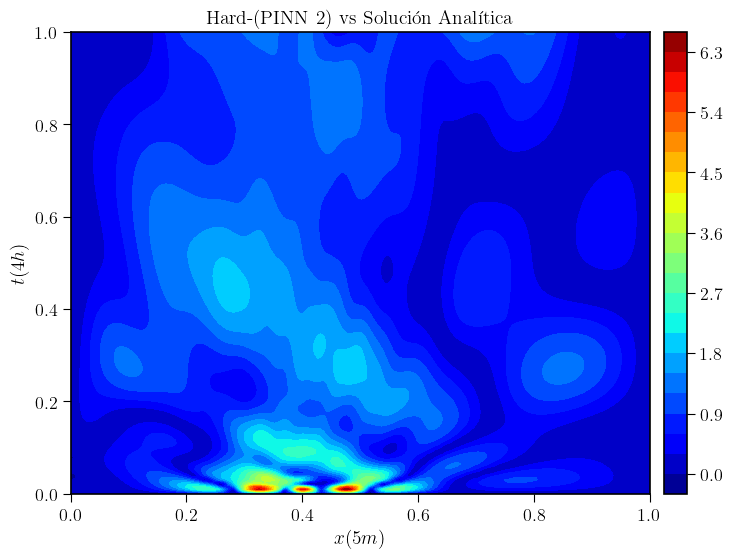

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model1.predict(test_points)*F    # Reescalar la predicción.
y_true = u_xt1reescaladox(test_points)*F  # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, Lscalado, 200)
t_grid = np.linspace(0, T_max, 200)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp, pad=0.02)

plt.xlabel("$x (5m)$")
plt.ylabel("$t (4h)$")
plt.title("Hard-(PINN 2) vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 2.1551


# g-PINN

In [ ]:
# Definición de la EDP.
def gPINNedp(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x
    
    eq = du_t - D * du_xx - K * u
    eq_x = du_tx - D * du_xxx - K * du_x
    eq_t = du_tt - D * du_xxt - K * du_t
    return [eq, eq_x, eq_t]

In [ ]:
# Definición de la EDP.
def gPINNedpreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x

    eq = du_t - (D/(L**2))* du_xx - K * u
    eq_x = (1/L)*du_tx - (D/(L**3))*du_xxx - K *(1/L)* du_x
    eq_t = du_tt - (D/(L**2))*du_xxt - K * du_t
    return [eq, eq_x, eq_t]

### Modelo menos complejo

#### Tiempo de entrenamiento

In [7]:
# Reescalar la solución.
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=7500)

Compiling model...
Building feed-forward neural network...
'build' took 0.020821 s

'compile' took 0.325304 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [4.68e-01, 1.81e-01, 2.39e-01, 4.74e-01, 5.82e-01, 7.18e+03]    [4.01e-01, 1.88e-01, 2.24e-01, 4.74e-01, 5.82e-01, 7.18e+03]    [2.79e+03]    
7500      [6.98e+00, 2.00e+01, 6.85e+01, 2.18e+01, 2.94e+01, 3.15e+03]    [6.27e+00, 1.87e+01, 6.08e+01, 2.18e+01, 2.94e+01, 3.15e+03]    [1.04e+02]    

Best model at step 7500:
  train loss: 3.30e+03
  test loss: 3.29e+03
  test metric: [1.04e+02]

'train' took 25.050948 s

CPU times: user 20.4 s, sys: 7.5 s, total: 27.9 s
Wall time: 25.4 s


#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__() 
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.024469 s

'compile' took 0.266544 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.09e-01, 5.44e-02, 4.04e-02, 1.91e-01, 6.20e-03, 7.15e+03]    [9.21e-02, 5.69e-02, 3.33e-02, 1.91e-01, 6.20e-03, 7.15e+03]    [2.76e+03]    


I0000 00:00:1750731789.243417   41720 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [1.71e-01, 1.01e-01, 4.08e-02, 2.72e-01, 2.15e-01, 7.11e+03]    [1.56e-01, 1.09e-01, 3.50e-02, 2.72e-01, 2.15e-01, 7.11e+03]    [2.72e+03]    
2         [4.89e-01, 1.82e-01, 4.70e-02, 3.77e-01, 1.00e+00, 7.08e+03]    [4.79e-01, 1.94e-01, 4.25e-02, 3.77e-01, 1.00e+00, 7.08e+03]    [2.68e+03]    
3         [1.05e+00, 2.98e-01, 5.82e-02, 5.05e-01, 2.35e+00, 7.04e+03]    [1.05e+00, 3.15e-01, 5.48e-02, 5.05e-01, 2.35e+00, 7.04e+03]    [2.64e+03]    
4         [1.83e+00, 4.57e-01, 7.30e-02, 6.61e-01, 4.21e+00, 7.01e+03]    [1.85e+00, 4.78e-01, 7.07e-02, 6.61e-01, 4.21e+00, 7.01e+03]    [2.61e+03]    
5         [2.80e+00, 6.70e-01, 8.90e-02, 8.44e-01, 6.52e+00, 6.98e+03]    [2.83e+00, 6.90e-01, 8.80e-02, 8.44e-01, 6.52e+00, 6.98e+03]    [2.57e+03]    
6         [3.92e+00, 9.54e-01, 1.03e-01, 1.05e+00, 9.18e+00, 6.95e+03]    [3.98e+00, 9.67e-01, 1.04e-01, 1.05e+00, 9.18e+00, 6.95e+03]    [2.53e+03]    
7         [5.17e+00, 1.34e+00, 1.13e-01, 1.29e+00, 1.21e+01, 6.92e+03]    [5.24e+0

In [11]:
memoria_por_epoca = mem_cb.get_memory()
metrictest = losshistory134.metrics_test
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasgPINN1.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasgPINN1.txt')

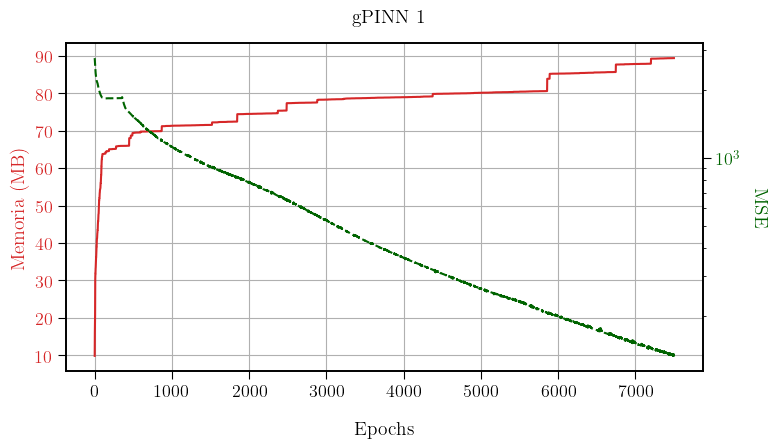

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("gPINN 1", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400' 
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [15]:
max(memorias)

89.4375


#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101 
# Crear malla de puntos.
x = np.linspace(0, L, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model, XT, save_every=100)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])

Compiling model...
Building feed-forward neural network...
'build' took 0.041661 s

'compile' took 0.400890 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [8.21e-01, 3.23e-01, 3.59e-01, 1.70e-01, 3.34e+00, 7.03e+03]    [8.22e-01, 3.19e-01, 3.77e-01, 1.70e-01, 3.34e+00, 7.03e+03]    [2.62e+03]    


I0000 00:00:1750975106.201710  230640 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [1.58e+00, 5.70e-01, 3.94e-01, 2.84e-01, 5.94e+00, 6.99e+03]    [1.59e+00, 5.55e-01, 4.15e-01, 2.84e-01, 5.94e+00, 6.99e+03]    [2.57e+03]    
2         [2.61e+00, 9.38e-01, 4.22e-01, 4.40e-01, 9.13e+00, 6.96e+03]    [2.64e+00, 8.96e-01, 4.45e-01, 4.40e-01, 9.13e+00, 6.96e+03]    [2.53e+03]    
3         [3.90e+00, 1.47e+00, 4.46e-01, 6.45e-01, 1.27e+01, 6.93e+03]    [3.95e+00, 1.37e+00, 4.70e-01, 6.45e-01, 1.27e+01, 6.93e+03]    [2.49e+03]    
4         [5.41e+00, 2.23e+00, 4.66e-01, 9.04e-01, 1.66e+01, 6.90e+03]    [5.47e+00, 2.03e+00, 4.92e-01, 9.04e-01, 1.66e+01, 6.90e+03]    [2.46e+03]    
5         [7.10e+00, 3.27e+00, 4.85e-01, 1.22e+00, 2.05e+01, 6.87e+03]    [7.16e+00, 2.90e+00, 5.11e-01, 1.22e+00, 2.05e+01, 6.87e+03]    [2.43e+03]    
6         [8.92e+00, 4.63e+00, 5.03e-01, 1.61e+00, 2.44e+01, 6.85e+03]    [8.98e+00, 4.01e+00, 5.31e-01, 1.61e+00, 2.44e+01, 6.85e+03]    [2.40e+03]    
7         [1.08e+01, 6.33e+00, 5.25e-01, 2.06e+00, 2.82e+01, 6.82e+03]    [1.09e+0

In [22]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

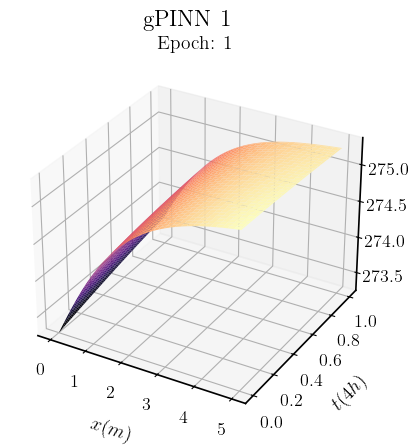

: 

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='magma')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("gPINN 1")
    ax.set_xlabel("$x(m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

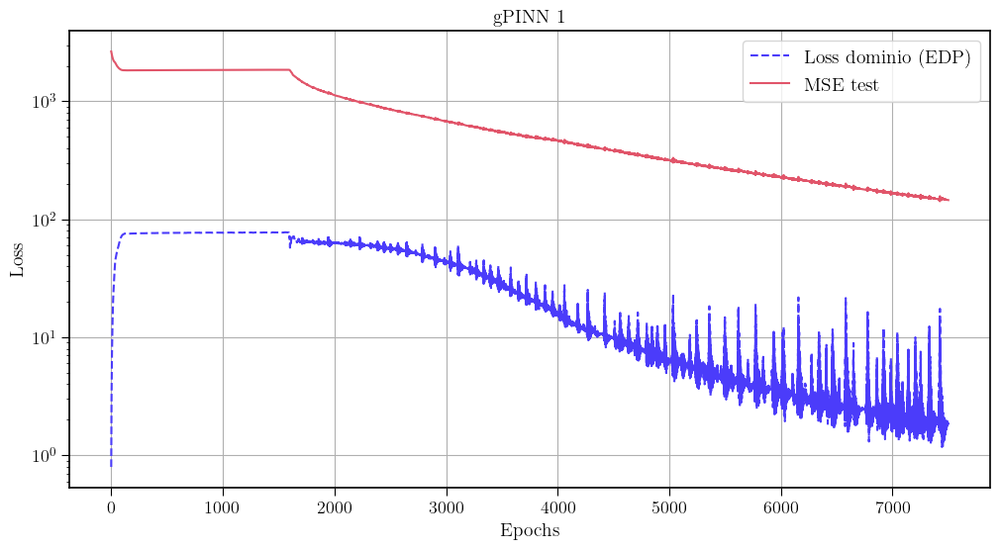

In [ ]:
loss_train = np.array(losshistory134.loss_train)*F**2
testmetric134 = np.array(losshistory134.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",
    "#28A87D", 
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])

plt.plot(testmetric134[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gPINN 1")
plt.legend()
plt.grid(True)
plt.show()

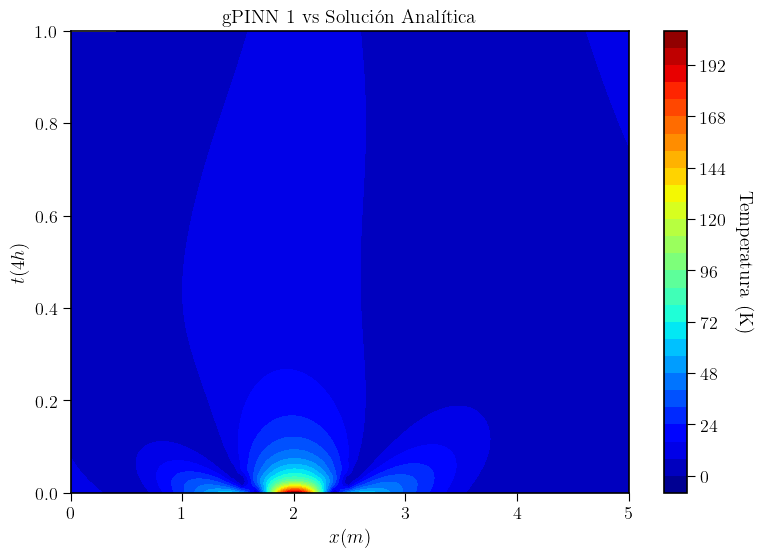

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)
y_pred = model.predict(test_points)*F  # Reescalar la predicción
y_true = u_xt1(test_points)*F          # Reescalar la solución analítica

# Error absoluto.
y_error = np.abs(y_pred - y_true)

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 400)
t_grid = np.linspace(0, T_max, 400)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 1 vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 177.7884


### Modelo más complejo

#### Tiempo de entrenamiento

In [7]:
# Reescalar la solución.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=7500)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.040037 s

'compile' took 0.477467 s

Training model...

0         [9.52e-02, 1.48e-03, 2.31e-02, 6.70e-03, 2.62e-02, 2.63e+00]    [7.45e-02, 1.46e-03, 2.69e-02, 6.70e-03, 2.62e-02, 2.63e+00]    [2.97e-01]    
7500      [4.99e-03, 5.31e-03, 3.35e-02, 1.01e-02, 4.22e-03, 6.16e-01]    [5.42e-03, 4.99e-03, 2.77e-02, 1.01e-02, 4.22e-03, 6.16e-01]    [1.99e-02]    

Best model at step 7500:
  train loss: 6.74e-01
  test loss: 6.68e-01
  test metric: [1.99e-02]

'train' took 267.129074 s

Compiling model...
'compile' took 0.431497 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [4.99e-03, 5.31e-03, 3.35e-02, 1.01e-02, 4.22e-03, 6.16e-01]    [5.42e-03, 4.99e-03, 2.77e-02, 1.01e-02, 4.22e-03, 6.16e-01]    [1.99e-02]    
INFO:tensorflow:Optimization terminated with:
  Message: CONVERGENCE

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None
        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
# Entrenar el modelo.
mem_cb = MemoryCallback()
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.035908 s

'compile' took 0.460379 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [5.86e-01, 1.84e-02, 2.78e-02, 1.17e-02, 5.58e-01, 4.95e+00]    [5.37e-01, 1.96e-02, 3.69e-02, 1.17e-02, 5.58e-01, 4.95e+00]    [7.68e-01]    


I0000 00:00:1750886870.757876  375311 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [3.88e-01, 1.35e-02, 2.34e-02, 1.50e-02, 3.66e-01, 4.31e+00]    [3.50e-01, 1.44e-02, 3.07e-02, 1.50e-02, 3.66e-01, 4.31e+00]    [6.29e-01]    
2         [2.36e-01, 9.42e-03, 1.98e-02, 1.92e-02, 2.17e-01, 3.78e+00]    [2.09e-01, 9.98e-03, 2.55e-02, 1.92e-02, 2.17e-01, 3.78e+00]    [5.10e-01]    
3         [1.26e-01, 6.10e-03, 1.67e-02, 2.39e-02, 1.10e-01, 3.35e+00]    [1.07e-01, 6.45e-03, 2.09e-02, 2.39e-02, 1.10e-01, 3.35e+00]    [4.13e-01]    
4         [5.31e-02, 3.57e-03, 1.37e-02, 2.90e-02, 4.15e-02, 3.01e+00]    [4.28e-02, 3.77e-03, 1.66e-02, 2.90e-02, 4.15e-02, 3.01e+00]    [3.35e-01]    
5         [1.50e-02, 1.79e-03, 1.09e-02, 3.41e-02, 7.11e-03, 2.77e+00]    [1.16e-02, 1.88e-03, 1.26e-02, 3.41e-02, 7.11e-03, 2.77e+00]    [2.75e-01]    
6         [7.42e-03, 6.80e-04, 8.20e-03, 3.90e-02, 1.03e-03, 2.59e+00]    [9.50e-03, 7.14e-04, 9.01e-03, 3.90e-02, 1.03e-03, 2.59e+00]    [2.32e-01]    
7         [2.55e-02, 1.33e-04, 5.72e-03, 4.34e-02, 1.65e-02, 2.49e+00]    [3.12e-0

In [11]:
memoria_por_epoca = mem_cb.get_memory()
metrictest = np.array(losshistory135.metrics_test)*F**2

In [12]:
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('memoriasgPINN2.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('memoriasgPINN2.txt')

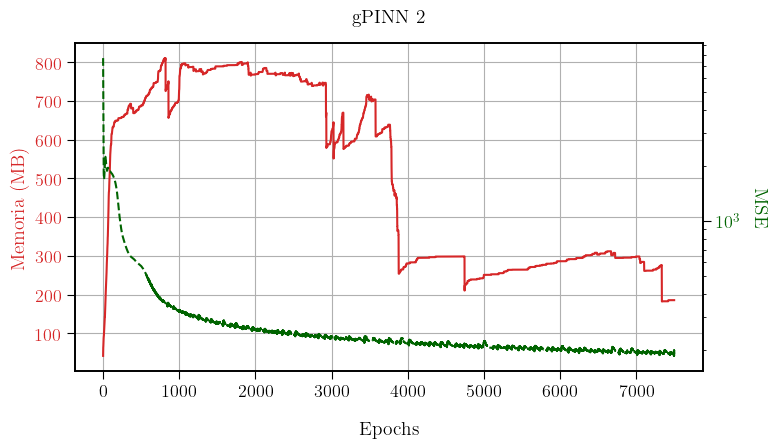

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("gPINN 2", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400' 
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [16]:
max(memorias)

810.859375


#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 100  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T
# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model, XT, save_every=100)
# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.048113 s

'compile' took 0.509365 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [9.55e-02, 1.48e-03, 2.31e-02, 6.11e-03, 2.58e-02, 2.63e+00]    [7.45e-02, 1.46e-03, 2.69e-02, 6.11e-03, 2.58e-02, 2.63e+00]    [2.97e-01]    
1         [3.53e-02, 1.18e-03, 7.17e-04, 8.09e-04, 4.19e-02, 2.60e+00]    [3.29e-02, 1.09e-03, 9.44e-04, 8.09e-04, 4.19e-02, 2.60e+00]    [2.42e-01]    
2         [1.00e-02, 6.72e-04, 5.77e-03, 1.22e-02, 4.68e-02, 2.58e+00]    [1.19e-02, 5.51e-04, 6.12e-03, 1.22e-02, 4.68e-02, 2.58e+00]    [2.12e-01]    
3         [5.79e-03, 3.07e-04, 1.26e-02, 2.65e-02, 4.31e-02, 2.56e+00]    [7.38e-03, 2.07e-04, 1.36e-02, 2.65e-02, 4.31e-02, 2.56e+00]    [1.99e-01]    
4         [7.33e-03, 1.48e-04, 1.08e-02, 3.61e-02, 3.98e-02, 2.52e+00]    [1.02e-02, 8.14e-05, 1.16e-02, 

In [29]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

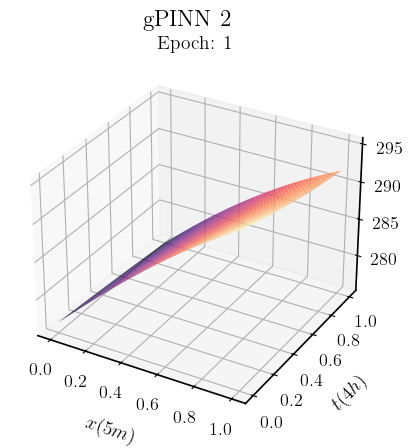

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='magma')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("gPINN 2")
    ax.set_xlabel("$x(5m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

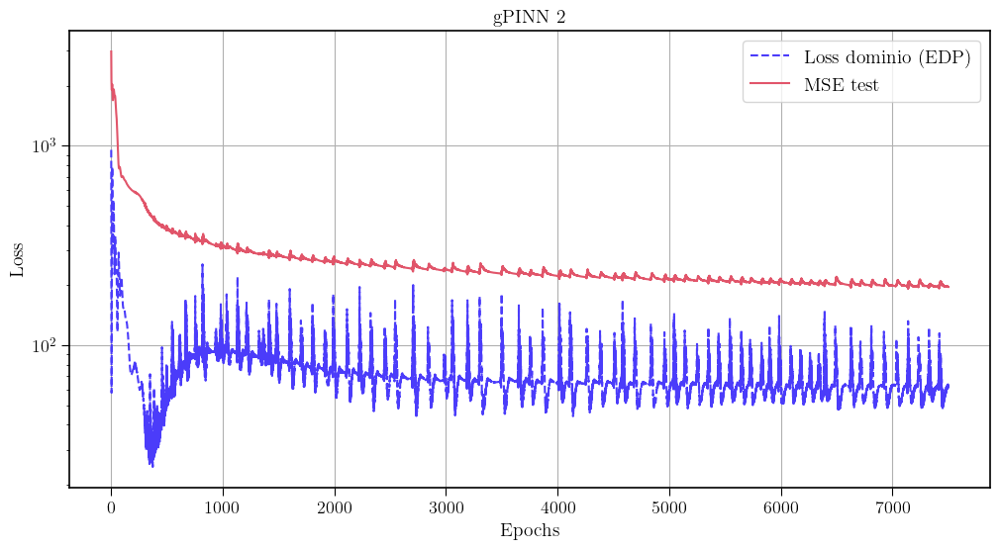

In [ ]:
loss_train = np.array(losshistory135.loss_train)*F**2
testmetric134 = np.array(losshistory135.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3",  
    "#28A87D", 
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])

plt.plot(testmetric134[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gPINN 2")
plt.legend()
plt.grid(True)
plt.show()

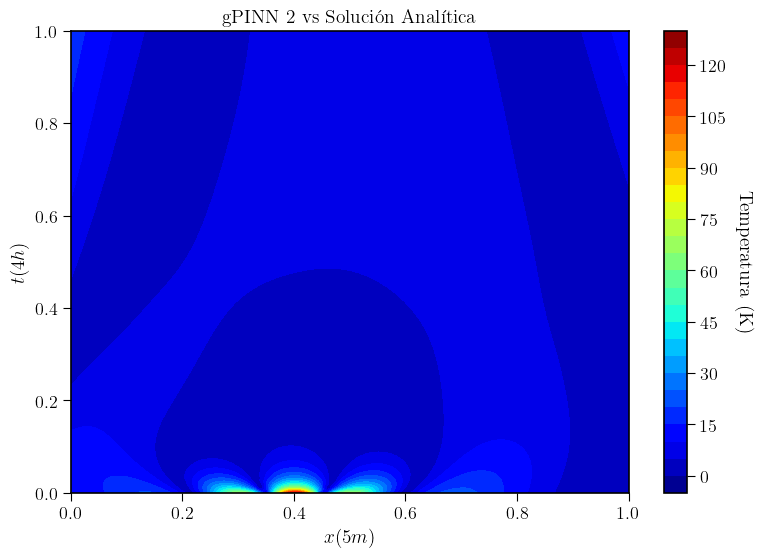

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F     # Reescalar la predicción.
y_true = u_xt1reescaladox(test_points)*F  # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true) 

# Graficar el error en el dominio.
x_grid = np.linspace(0, Lscalado, 400)
t_grid = np.linspace(0, T_max, 400)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (5m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 2 vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 58.7108


: 

# g-PINN + RAR

In [ ]:
# Definición de la EDP.
def gPINNedp(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x
    
    eq = du_t - D * du_xx - K * u
    eq_x = du_tx - D * du_xxx - K * du_x
    eq_t = du_tt - D * du_xxt - K * du_t
    return [eq, eq_x, eq_t]

In [ ]:
# Definición de la EDP.
def gPINNedpreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x

    eq = du_t - (D/(L**2))* du_xx - K * u
    eq_x = (1/L)*du_tx - (D/(L**3))*du_xxx - K *(1/L)* du_x
    eq_t = du_tt - (D/(L**2))*du_xxt - K * du_t
    return [eq, eq_x, eq_t]

### Modelo menos complejo

#### Tiempo de entrenamiento

In [17]:
# Reescalar la solución.
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time

# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
model.train(iterations=7500,display_every=7500)

# RAR manual: refinamiento adaptativo.
err = 101
RAR_threshold = 1
iter = 7500
while iter < 21500:
    
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1(X)  
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  # (5, 2)

    err = np.mean(err)
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.01, metrics=['MSE'])
    losshistory2342, trainstate = model.train(iterations=2000, disregard_previous_best=False)
    iter = iter + 2000

Compiling model...
Building feed-forward neural network...
'build' took 0.023241 s

'compile' took 0.301947 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [2.00e-01, 2.18e-03, 1.28e-01, 1.46e-01, 5.44e-02, 7.15e+03]    [1.84e-01, 2.03e-03, 1.33e-01, 1.46e-01, 5.44e-02, 7.15e+03]    [2.76e+03]    


I0000 00:00:1751005846.589272  467284 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


7500      [2.63e+00, 1.28e+01, 9.23e+01, 3.45e+01, 4.80e+01, 2.85e+03]    [1.92e+00, 1.22e+01, 8.96e+01, 3.45e+01, 4.80e+01, 2.85e+03]    [8.27e+01]    

Best model at step 7500:
  train loss: 3.04e+03
  test loss: 3.04e+03
  test metric: [8.27e+01]

'train' took 22.499677 s

Residual medio: 6.968e+01
Compiling model...
'compile' took 0.324580 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [2.61e+00, 1.28e+01, 9.80e+01, 3.45e+01, 4.80e+01, 2.85e+03]    [1.92e+00, 1.22e+01, 8.96e+01, 3.45e+01, 4.80e+01, 2.85e+03]    [8.27e+01]    


2025-06-27 08:31:09.483993: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_3/Assign' id:2891 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_3, dense_2/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


8000      [2.55e+00, 1.25e+01, 9.34e+01, 3.46e+01, 4.79e+01, 2.85e+03]    [1.85e+00, 1.18e+01, 8.65e+01, 3.46e+01, 4.79e+01, 2.85e+03]    [8.25e+01]    
9000      [2.93e+00, 1.40e+01, 9.97e+01, 3.42e+01, 4.88e+01, 2.78e+03]    [2.17e+00, 1.33e+01, 9.22e+01, 3.42e+01, 4.88e+01, 2.78e+03]    [8.01e+01]    
9500      [3.40e+00, 1.74e+01, 1.15e+02, 3.42e+01, 5.05e+01, 2.75e+03]    [2.45e+00, 1.44e+01, 1.03e+02, 3.42e+01, 5.05e+01, 2.75e+03]    [7.97e+01]    

Best model at step 9500:
  train loss: 2.97e+03
  test loss: 2.95e+03
  test metric: [7.97e+01]

'train' took 6.332331 s

Residual medio: 7.312e+01
Compiling model...
'compile' took 0.206830 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9500      [3.38e+00, 1.77e+01, 1.16e+02, 3.42e+01, 5.05e+01, 2.75e+03]    [2.45e+00, 1.44e+01, 1.03e+02, 3.42e+01, 5.05e+01, 2.75e+03]    [7.97e+01]    


2025-06-27 08:31:16.045940: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_5/Assign' id:4259 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_5, dense_2/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


10000     [3.04e+00, 1.37e+01, 9.93e+01, 3.53e+01, 4.97e+01, 2.75e+03]    [2.21e+00, 1.28e+01, 9.31e+01, 3.53e+01, 4.97e+01, 2.75e+03]    [7.92e+01]    
11000     [7.12e+00, 7.08e+01, 5.91e+02, 3.41e+01, 4.51e+01, 2.69e+03]    [4.39e+00, 4.89e+01, 2.18e+02, 3.41e+01, 4.51e+01, 2.69e+03]    [7.46e+01]    
11500     [3.20e+00, 1.51e+01, 1.08e+02, 3.32e+01, 4.96e+01, 2.69e+03]    [2.32e+00, 1.37e+01, 1.03e+02, 3.32e+01, 4.96e+01, 2.69e+03]    [7.68e+01]    

Best model at step 11500:
  train loss: 2.90e+03
  test loss: 2.89e+03
  test metric: [7.68e+01]

'train' took 6.516276 s

Residual medio: 6.614e+01
Compiling model...
'compile' took 0.208560 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11500     [3.19e+00, 1.50e+01, 1.08e+02, 3.32e+01, 4.96e+01, 2.69e+03]    [2.32e+00, 1.37e+01, 1.03e+02, 3.32e+01, 4.96e+01, 2.69e+03]    [7.68e+01]    


2025-06-27 08:31:22.827241: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_7/Assign' id:5641 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_7, dense_2/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


12000     [3.25e+00, 1.42e+01, 9.98e+01, 3.38e+01, 5.09e+01, 2.70e+03]    [2.35e+00, 1.31e+01, 9.95e+01, 3.38e+01, 5.09e+01, 2.70e+03]    [7.77e+01]    
13000     [3.24e+00, 1.51e+01, 1.11e+02, 3.32e+01, 4.99e+01, 2.65e+03]    [2.34e+00, 1.42e+01, 1.07e+02, 3.32e+01, 4.99e+01, 2.65e+03]    [7.59e+01]    
13500     [3.74e+00, 1.71e+01, 1.26e+02, 3.30e+01, 5.29e+01, 2.66e+03]    [2.72e+00, 1.39e+01, 1.15e+02, 3.30e+01, 5.29e+01, 2.66e+03]    [7.76e+01]    

Best model at step 13000:
  train loss: 2.86e+03
  test loss: 2.86e+03
  test metric: [7.59e+01]

'train' took 6.567486 s

Residual medio: 7.038e+01
Compiling model...
'compile' took 0.238211 s



2025-06-27 08:31:29.636601: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_9/Assign' id:7037 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_9, dense_2/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13500     [3.72e+00, 1.73e+01, 1.26e+02, 3.30e+01, 5.29e+01, 2.66e+03]    [2.72e+00, 1.39e+01, 1.15e+02, 3.30e+01, 5.29e+01, 2.66e+03]    [7.76e+01]    
14000     [3.20e+00, 2.07e+01, 1.28e+02, 3.30e+01, 4.87e+01, 2.66e+03]    [2.36e+00, 1.61e+01, 1.04e+02, 3.30e+01, 4.87e+01, 2.66e+03]    [7.55e+01]    
15000     [6.25e+00, 1.12e+02, 3.61e+02, 3.31e+01, 4.64e+01, 2.62e+03]    [4.78e+00, 6.91e+01, 1.82e+02, 3.31e+01, 4.64e+01, 2.62e+03]    [7.32e+01]    
15500     [3.12e+00, 1.53e+01, 1.19e+02, 3.22e+01, 4.95e+01, 2.60e+03]    [2.22e+00, 1.40e+01, 1.14e+02, 3.22e+01, 4.95e+01, 2.60e+03]    [7.39e+01]    

Best model at step 15500:
  train loss: 2.82e+03
  test loss: 2.81e+03
  test metric: [7.39e+01]

'train' took 6.420288 s

Residual medio: 6.412e+01
Compiling model...
'compile' took 0.244515 s



2025-06-27 08:31:36.331290: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_11/Assign' id:8447 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_11, dense_2/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15500     [3.11e+00, 1.53e+01, 1.18e+02, 3.22e+01, 4.95e+01, 2.60e+03]    [2.22e+00, 1.40e+01, 1.14e+02, 3.22e+01, 4.95e+01, 2.60e+03]    [7.39e+01]    
16000     [3.11e+00, 1.48e+01, 1.08e+02, 3.20e+01, 4.98e+01, 2.61e+03]    [2.22e+00, 1.37e+01, 1.05e+02, 3.20e+01, 4.98e+01, 2.61e+03]    [7.43e+01]    
17000     [3.00e+00, 1.52e+01, 1.21e+02, 3.20e+01, 4.89e+01, 2.58e+03]    [2.13e+00, 1.38e+01, 1.15e+02, 3.20e+01, 4.89e+01, 2.58e+03]    [7.27e+01]    
17500     [3.03e+00, 1.46e+01, 1.14e+02, 3.10e+01, 4.92e+01, 2.58e+03]    [2.18e+00, 1.35e+01, 1.11e+02, 3.10e+01, 4.92e+01, 2.58e+03]    [7.29e+01]    

Best model at step 17500:
  train loss: 2.79e+03
  test loss: 2.78e+03
  test metric: [7.29e+01]

'train' took 6.569842 s

Residual medio: 6.047e+01
Compiling model...
'compile' took 0.246655 s



2025-06-27 08:31:43.177271: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_13/Assign' id:9871 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_13, dense_2/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17500     [3.01e+00, 1.46e+01, 1.14e+02, 3.10e+01, 4.92e+01, 2.58e+03]    [2.18e+00, 1.35e+01, 1.11e+02, 3.10e+01, 4.92e+01, 2.58e+03]    [7.29e+01]    
18000     [2.35e+00, 1.97e+01, 1.19e+02, 2.90e+01, 4.47e+01, 2.62e+03]    [1.93e+00, 1.85e+01, 1.13e+02, 2.90e+01, 4.47e+01, 2.62e+03]    [7.26e+01]    
19000     [3.05e+00, 1.86e+01, 1.26e+02, 3.00e+01, 4.80e+01, 2.57e+03]    [2.18e+00, 1.66e+01, 1.13e+02, 3.00e+01, 4.80e+01, 2.57e+03]    [7.18e+01]    
19500     [3.25e+00, 1.60e+01, 1.17e+02, 3.03e+01, 5.04e+01, 2.57e+03]    [2.34e+00, 1.43e+01, 1.14e+02, 3.03e+01, 5.04e+01, 2.57e+03]    [7.37e+01]    

Best model at step 19500:
  train loss: 2.79e+03
  test loss: 2.78e+03
  test metric: [7.37e+01]

'train' took 6.836757 s

Residual medio: 6.416e+01
Compiling model...
'compile' took 0.251943 s



2025-06-27 08:31:50.298531: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_15/Assign' id:11309 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_15, dense_2/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
19500     [3.23e+00, 1.60e+01, 1.17e+02, 3.03e+01, 5.04e+01, 2.57e+03]    [2.34e+00, 1.43e+01, 1.14e+02, 3.03e+01, 5.04e+01, 2.57e+03]    [7.37e+01]    
20000     [2.63e+00, 1.77e+01, 1.11e+02, 3.01e+01, 4.73e+01, 2.59e+03]    [1.85e+00, 1.70e+01, 1.09e+02, 3.01e+01, 4.73e+01, 2.59e+03]    [7.35e+01]    
21000     [2.41e+00, 1.52e+01, 1.20e+02, 3.01e+01, 4.67e+01, 2.55e+03]    [1.67e+00, 1.42e+01, 1.14e+02, 3.01e+01, 4.67e+01, 2.55e+03]    [7.18e+01]    
21500     [2.61e+00, 1.55e+01, 1.21e+02, 3.00e+01, 4.73e+01, 2.54e+03]    [1.85e+00, 1.43e+01, 1.13e+02, 3.00e+01, 4.73e+01, 2.54e+03]    [7.20e+01]    

Best model at step 21500:
  train loss: 2.76e+03
  test loss: 2.75e+03
  test metric: [7.20e+01]

'train' took 7.085055 s

CPU times: user 1min 3s, sys: 17.5 s, total: 1min 20s
Wall time: 1min 10s


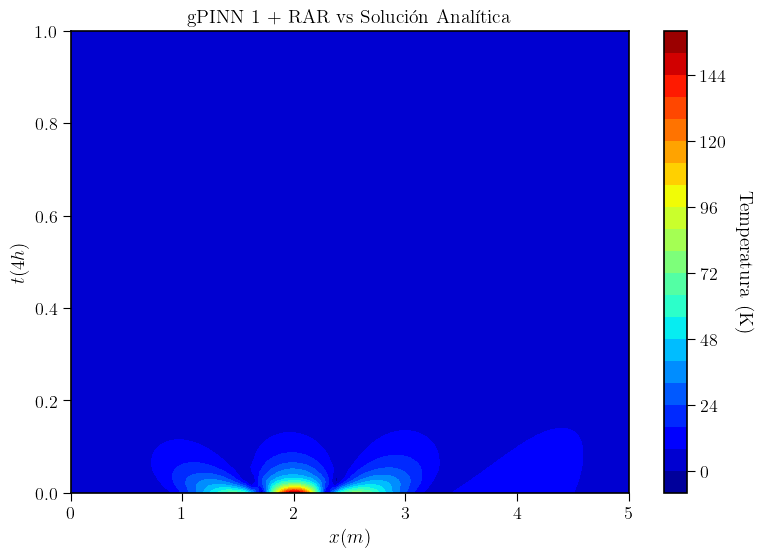

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt1(test_points)*F          # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true) 

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 500)
t_grid = np.linspace(0, T_max, 500)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 1 + RAR vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred-y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 80.0322


: 

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
mem_cb1 = MemoryCallback()

# Entrenar el modelo.
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
memoria_por_epoca1 = mem_cb.get_memory()
memoriaini = mem_cb.mem_init

# RAR manual: refinamiento adaptativo.
err = 101
RAR_threshold = 45

while err > RAR_threshold:
    X = geomtime.random_points(1000)
    y_pred = model.predict(X)
    y_true = u_xt1(X) 
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  # (5, 2)

    err = np.mean(err)
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.01,metrics=["MSE"])
    losshistory2342, trainstate = model.train(iterations=2000, display_every=1,disregard_previous_best=False, callbacks=[mem_cb1])

memooo = mem_cb1.get_memory()

Compiling model...
Building feed-forward neural network...
'build' took 0.021255 s

'compile' took 0.389897 s

Training model...

0         [6.53e-01, 7.18e-02, 6.72e-02, 7.54e-02, 1.42e+00, 7.19e+03]    [6.38e-01, 7.01e-02, 6.99e-02, 7.54e-02, 1.42e+00, 7.19e+03]    [2.81e+03]    
1         [2.37e-01, 2.81e-02, 7.96e-02, 1.19e-01, 4.08e-01, 7.16e+03]    [2.25e-01, 2.93e-02, 8.44e-02, 1.19e-01, 4.08e-01, 7.16e+03]    [2.78e+03]    
2         [3.75e-02, 2.56e-02, 9.27e-02, 1.77e-01, 7.52e-03, 7.12e+03]    [3.11e-02, 2.69e-02, 9.90e-02, 1.77e-01, 7.52e-03, 7.12e+03]    [2.74e+03]    
3         [7.28e-02, 5.97e-02, 1.06e-01, 2.47e-01, 2.37e-01, 7.09e+03]    [7.38e-02, 6.00e-02, 1.13e-01, 2.47e-01, 2.37e-01, 7.09e+03]    [2.70e+03]    
4         [3.40e-01, 1.28e-01, 1.19e-01, 3.26e-01, 1.06e+00, 7.06e+03]    [3.49e-01, 1.27e-01, 1.26e-01, 3.26e-01, 1.06e+00, 7.06e+03]    [2.67e+03]    
5         [8.17e-01, 2.31e-01, 1.32e-01, 4.13e-01, 2.40e+00, 7.03e+03]    [8.35e-01, 2.26e-01, 1.38e-01, 

2025-06-26 01:23:49.886967: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_3/Assign' id:28566 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_3, dense_5/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [3.51e+00, 1.95e+01, 1.11e+02, 3.97e+01, 5.54e+01, 2.92e+03]    [2.36e+00, 1.28e+01, 9.33e+01, 3.97e+01, 5.54e+01, 2.92e+03]    [8.61e+01]    
7501      [4.82e+02, 5.30e+03, 3.24e+04, 4.51e+01, 3.06e+01, 3.01e+03]    [3.00e+02, 2.85e+03, 1.03e+04, 4.51e+01, 3.06e+01, 3.01e+03]    [1.77e+02]    
7502      [3.62e+01, 3.77e+02, 2.97e+03, 4.07e+01, 4.06e+01, 2.92e+03]    [2.18e+01, 2.09e+02, 8.02e+02, 4.07e+01, 4.06e+01, 2.92e+03]    [8.89e+01]    
7503      [1.13e+02, 8.78e+02, 8.67e+03, 3.76e+01, 9.97e+01, 2.99e+03]    [6.86e+01, 5.03e+02, 2.66e+03, 3.76e+01, 9.97e+01, 2.99e+03]    [1.19e+02]    
7504      [2.36e+02, 2.27e+03, 1.63e+04, 3.61e+01, 1.25e+02, 3.01e+03]    [1.47e+02, 1.25e+03, 5.09e+03, 3.61e+01, 1.25e+02, 3.01e+03]    [1.45e+02]    
7505      [1.70e+02, 2.18e+03, 1.14e+04, 3.56e+01, 9.63e+01, 2.

2025-06-26 01:24:22.782594: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_5/Assign' id:30178 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_5, dense_5/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9500      [3.75e+00, 1.46e+01, 1.14e+02, 4.18e+01, 5.61e+01, 2.79e+03]    [2.45e+00, 9.96e+00, 8.92e+01, 4.18e+01, 5.61e+01, 2.79e+03]    [8.15e+01]    
9501      [3.78e+02, 4.52e+03, 5.97e+04, 4.01e+01, 3.19e+01, 2.77e+03]    [1.75e+02, 2.57e+03, 1.41e+04, 4.01e+01, 3.19e+01, 2.77e+03]    [1.45e+02]    
9502      [5.14e+01, 1.04e+03, 4.69e+03, 4.09e+01, 4.24e+01, 2.76e+03]    [3.37e+01, 7.54e+02, 1.49e+03, 4.09e+01, 4.24e+01, 2.76e+03]    [7.97e+01]    
9503      [8.88e+01, 5.11e+02, 1.33e+04, 4.16e+01, 9.37e+01, 2.89e+03]    [3.94e+01, 2.39e+02, 2.89e+03, 4.16e+01, 9.37e+01, 2.89e+03]    [1.17e+02]    
9504      [2.13e+02, 1.84e+03, 3.14e+04, 4.20e+01, 1.21e+02, 2.97e+03]    [9.84e+01, 1.07e+03, 6.81e+03, 4.20e+01, 1.21e+02, 2.97e+03]    [1.51e+02]    
9505      [1.45e+02, 1.88e+03, 2.09e+04, 4.17e+01, 9.27e+01, 2.

2025-06-26 01:24:58.157337: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_7/Assign' id:31804 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_7, dense_5/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11500     [3.64e+00, 1.59e+01, 1.02e+02, 4.16e+01, 5.40e+01, 2.70e+03]    [2.30e+00, 1.04e+01, 8.78e+01, 4.16e+01, 5.40e+01, 2.70e+03]    [7.74e+01]    
11501     [7.68e+02, 7.39e+03, 6.39e+04, 3.73e+01, 1.99e+02, 2.87e+03]    [4.13e+02, 3.31e+03, 1.95e+04, 3.73e+01, 1.99e+02, 2.87e+03]    [2.21e+02]    
11502     [4.04e+01, 5.62e+02, 3.89e+03, 4.08e+01, 6.77e+01, 2.69e+03]    [2.24e+01, 2.32e+02, 1.12e+03, 4.08e+01, 6.77e+01, 2.69e+03]    [8.57e+01]    
11503     [1.97e+02, 2.08e+03, 1.41e+04, 4.62e+01, 3.24e+01, 2.70e+03]    [1.11e+02, 1.10e+03, 4.11e+03, 4.62e+01, 3.24e+01, 2.70e+03]    [9.37e+01]    
11504     [4.87e+02, 5.35e+03, 3.25e+04, 4.93e+01, 2.93e+01, 2.73e+03]    [2.77e+02, 2.70e+03, 9.95e+03, 4.93e+01, 2.93e+01, 2.73e+03]    [1.32e+02]    
11505     [4.49e+02, 4.61e+03, 2.51e+04, 4.90e+01, 2.87e+01, 2.

2025-06-26 01:25:30.022367: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_9/Assign' id:33444 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_9, dense_5/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13500     [4.14e+00, 1.62e+01, 9.52e+01, 3.98e+01, 5.44e+01, 2.63e+03]    [2.66e+00, 1.09e+01, 8.41e+01, 3.98e+01, 5.44e+01, 2.63e+03]    [7.51e+01]    
13501     [5.81e+02, 3.64e+03, 1.01e+05, 4.20e+01, 1.82e+02, 2.91e+03]    [2.43e+02, 1.67e+03, 2.02e+04, 4.20e+01, 1.82e+02, 2.91e+03]    [2.22e+02]    
13502     [4.41e+01, 3.00e+02, 6.39e+03, 4.00e+01, 7.45e+01, 2.67e+03]    [1.77e+01, 1.45e+02, 1.26e+03, 4.00e+01, 7.45e+01, 2.67e+03]    [9.15e+01]    
13503     [1.06e+02, 9.68e+02, 1.91e+04, 3.87e+01, 3.79e+01, 2.60e+03]    [4.84e+01, 5.05e+02, 3.84e+03, 3.87e+01, 3.79e+01, 2.60e+03]    [7.93e+01]    
13504     [3.16e+02, 3.00e+03, 5.15e+04, 3.94e+01, 3.17e+01, 2.62e+03]    [1.39e+02, 1.45e+03, 1.05e+04, 3.94e+01, 3.17e+01, 2.62e+03]    [1.11e+02]    
13505     [3.18e+02, 2.74e+03, 4.52e+04, 3.96e+01, 3.12e+01, 2.

2025-06-26 01:26:01.908215: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_11/Assign' id:35098 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_11, dense_5/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15500     [4.25e+00, 1.55e+01, 9.76e+01, 3.72e+01, 5.42e+01, 2.58e+03]    [2.75e+00, 1.04e+01, 8.37e+01, 3.72e+01, 5.42e+01, 2.58e+03]    [7.29e+01]    
15501     [4.81e+02, 5.35e+03, 1.04e+05, 4.18e+01, 2.98e+01, 2.60e+03]    [1.77e+02, 2.55e+03, 1.72e+04, 4.18e+01, 2.98e+01, 2.60e+03]    [1.36e+02]    
15502     [3.55e+01, 5.55e+02, 6.88e+03, 3.83e+01, 4.27e+01, 2.56e+03]    [1.44e+01, 3.15e+02, 1.16e+03, 3.83e+01, 4.27e+01, 2.56e+03]    [7.14e+01]    
15503     [1.39e+02, 1.03e+03, 2.37e+04, 3.61e+01, 9.39e+01, 2.66e+03]    [5.88e+01, 5.72e+02, 4.32e+03, 3.61e+01, 9.39e+01, 2.66e+03]    [1.12e+02]    
15504     [2.38e+02, 2.86e+03, 4.97e+04, 3.53e+01, 1.07e+02, 2.69e+03]    [1.01e+02, 1.42e+03, 8.28e+03, 3.53e+01, 1.07e+02, 2.69e+03]    [1.24e+02]    
15505     [1.60e+02, 3.06e+03, 3.55e+04, 3.52e+01, 7.76e+01, 2.

: 

In [ ]:
# Corregir la memoria restando la memoria inicial.
memoria1 = np.array(memoria_por_epoca1) - memoriaini
memoria2 = np.array(memooo) - memoriaini

# Métricas MSE.
mse1 = np.array(losshistory2342.metrics_test)[:7500]
mse2 = np.array(losshistory2342.metrics_test)[7500:]

# Concatenar para graficar todo en una sola curva.
memoria_total = np.concatenate([memoria1, memoria2])
mse_total = np.concatenate([mse1, mse2])

In [15]:
np.savetxt('memoriasgPINN1RAR.txt', memoria_total)
np.savetxt('MSEgPINN1RAR.txt', mse_total)

In [ ]:
iteracioness = len(memoria_total)
print("Iteraciones:", iteracioness)

Iteraciones: 21500


: 

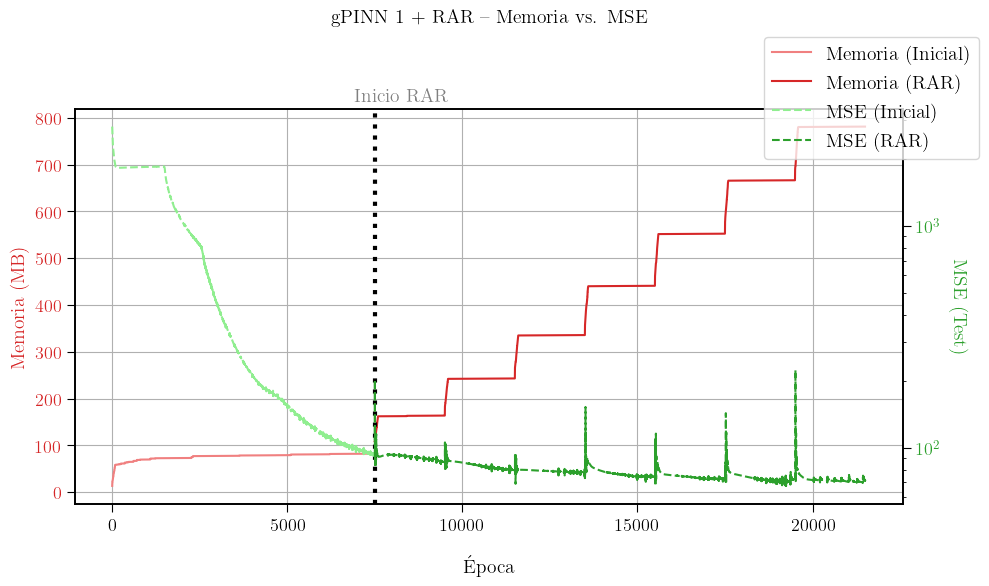

In [ ]:
fig, ax1 = plt.subplots(figsize=(10, 6))
plt.suptitle("gPINN 1 + RAR – Memoria vs. MSE", fontsize=14)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'   
color1_dark = 'tab:red'   

ax1.set_xlabel("Época", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', color=color1_light, label="Memoria (Inicial)")
ax1.plot(range(len(memoria1), len(memoria_total)), memoria2, '-', color=color1_dark, label="Memoria (RAR)")
ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrica de Test (MSE).
color2_light = '#90ee90'  
color2_dark = 'tab:green' 

ax2 = ax1.twinx()
ax2.set_ylabel("MSE (Test)", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--', color=color2_light, label="MSE (Inicial)")
ax2.plot(range(len(mse1), len(mse_total)), mse2, '--', color=color2_dark, label="MSE (RAR)")
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "Inicio RAR", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
fig.legend(lines1 + lines2, labels1 + labels2, loc="upper right", bbox_to_anchor=(1, 0.95))

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

Comparación con gPINN 1

tiempo

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=21500,display_every=21500)

Compiling model...
Building feed-forward neural network...
'build' took 0.021010 s

'compile' took 0.428962 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [2.00e-01, 2.19e-03, 1.29e-01, 1.57e-01, 5.89e-02, 7.15e+03]    [1.84e-01, 2.03e-03, 1.33e-01, 1.57e-01, 5.89e-02, 7.15e+03]    [2.76e+03]    
21500     [9.44e+00, 1.12e+02, 1.60e+03, 2.95e+01, 3.87e+01, 2.40e+03]    [5.57e+00, 3.64e+01, 5.26e+02, 2.95e+01, 3.87e+01, 2.40e+03]    [7.00e+01]    

Best model at step 21500:
  train loss: 4.19e+03
  test loss: 3.04e+03
  test metric: [7.00e+01]

'train' took 69.485740 s

CPU times: user 57.3 s, sys: 19.4 s, total: 1min 16s
Wall time: 1min 9s


consumo memoria

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=21500,display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.021874 s

'compile' took 0.266601 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.22e-01, 5.07e-03, 1.13e-02, 4.57e-02, 2.44e-01, 7.10e+03]    [1.19e-01, 4.69e-03, 9.92e-03, 4.57e-02, 2.44e-01, 7.10e+03]    [2.73e+03]    


I0000 00:00:1750948062.142096   33325 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [3.21e-01, 9.06e-03, 1.12e-02, 2.51e-02, 9.11e-01, 7.08e+03]    [3.21e-01, 8.42e-03, 9.68e-03, 2.51e-02, 9.11e-01, 7.08e+03]    [2.70e+03]    
2         [6.25e-01, 1.97e-02, 1.95e-02, 1.55e-02, 1.99e+00, 7.06e+03]    [6.28e-01, 1.90e-02, 1.82e-02, 1.55e-02, 1.99e+00, 7.06e+03]    [2.67e+03]    
3         [1.03e+00, 3.99e-02, 3.41e-02, 2.00e-02, 3.42e+00, 7.03e+03]    [1.03e+00, 3.94e-02, 3.31e-02, 2.00e-02, 3.42e+00, 7.03e+03]    [2.64e+03]    
4         [1.52e+00, 7.48e-02, 5.24e-02, 4.34e-02, 5.12e+00, 7.01e+03]    [1.53e+00, 7.46e-02, 5.14e-02, 4.34e-02, 5.12e+00, 7.01e+03]    [2.61e+03]    
5         [2.08e+00, 1.33e-01, 7.26e-02, 9.20e-02, 6.98e+00, 6.99e+03]    [2.09e+00, 1.32e-01, 7.11e-02, 9.20e-02, 6.98e+00, 6.99e+03]    [2.59e+03]    
6         [2.70e+00, 2.27e-01, 9.36e-02, 1.74e-01, 8.93e+00, 6.97e+03]    [2.72e+00, 2.23e-01, 9.04e-02, 1.74e-01, 8.93e+00, 6.97e+03]    [2.56e+03]    
7         [3.38e+00, 3.75e-01, 1.15e-01, 2.99e-01, 1.09e+01, 6.95e+03]    [3.41e+0

In [11]:
metrictest = losshistory134.metrics_test

In [12]:
memoria_por_epoca = mem_cb.get_memory()
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [16]:
np.savetxt('memoriasPRUEBAgPINN1.txt', memoria_por_epoca)

In [3]:
memorias = np.loadtxt('memoriasgPINN1RAR.txt')
mse = np.loadtxt('MSEgPINN1RAR.txt')

In [23]:
memoria_por_epoca=np.loadtxt('memoriasPRUEBAgPINN1.txt')

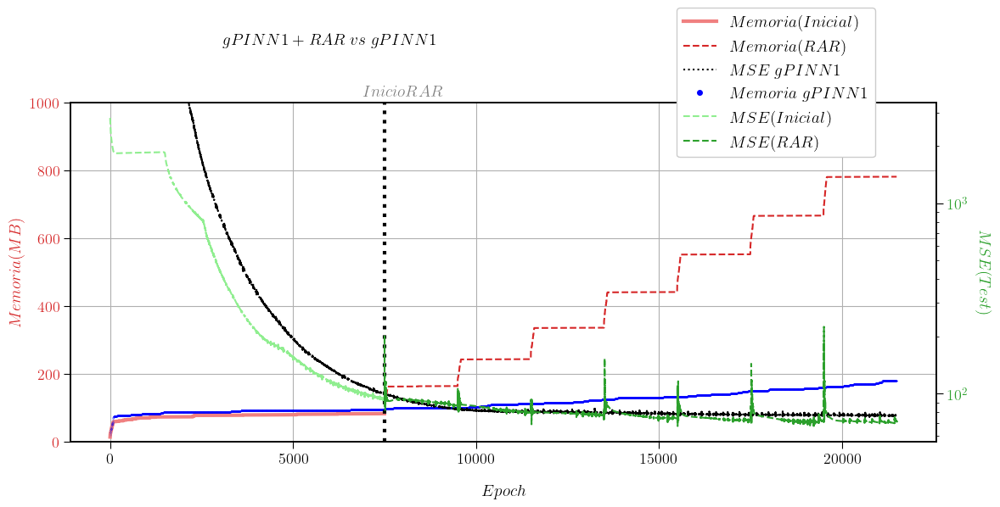

In [ ]:
memoria1 = memorias[:7500]
memoria2 = memorias[7500:]
mse1 = mse[:7500]
mse2 = mse[7500:]


fig, ax1 = plt.subplots(figsize=(8, 6))
plt.suptitle(r"$gPINN 1 + RAR \; vs \; gPINN1$", fontsize=14, y=0.95)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'   
color1_dark = 'tab:red'  

ax1.set_xlabel("$Epoch$", labelpad=15)
ax1.set_ylabel("$Memoria (MB)$", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', linewidth = 3,color=color1_light, label="$Memoria (Inicial)$")
ax1.plot(range(len(memoria1), len(memoria1)+len(memoria2)), memoria2, "--", color=color1_dark, label="$Memoria (RAR)$")
ax1.plot(range( len(memoria1)+len(memoria2)), memoria_por_epoca, '.', color='b', markersize = 0.1)
memoria_gpinn1_legend = Line2D([0], [0], marker='.', color='b', linestyle='None', 
                               markersize=8, label=r"$Memoria \; gPINN 1$")

ax1.set_ylim(0, 1000)
ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrico de Test (MSE).
color2_light = '#90ee90'   
color2_dark = 'tab:green' 

ax2 = ax1.twinx()
ax2.set_ylabel("$MSE (Test)$", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--',color=color2_light, label="$MSE (Inicial)$")
ax2.plot(range(len(mse1), len(mse1)+len(mse2)), mse2, '--', color=color2_dark, label="$MSE (RAR)$")
ax1.plot(range( 21500), metrictest[:21500], ':', color='k' ,label=r"$MSE \; gPINN 1$")
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "$Inicio RAR$", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
fig.legend(lines1 + [memoria_gpinn1_legend] + lines2, 
           labels1 + [r"$Memoria \; gPINN 1$"] + labels2,
           loc="upper left",
           bbox_to_anchor=(1.01, 1),  
           borderaxespad=0.,
           prop={'size': 14},
            frameon=True,           
           facecolor='white',       
           framealpha=1.0)  

fig.tight_layout(rect=[0, 0, 1.5, 0.95])
plt.show()

In [4]:
max(memorias)

781.125


#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=7500)

# RAR manual: refinamiento adaptativo.
err = 101
RAR_threshold = 55

RAR_history = []  
error_grid = []

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 500)
t_grid = np.linspace(0, T_max, 500)
X1, T1 = np.meshgrid(x_grid, t_grid)

RAR_points = np.empty((0, 2)) 

while err > RAR_threshold:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1(X)  
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  

    err = np.mean(err)
    print("Residual medio: %.3e" % err)
    print("\u2795 Añadiendo nuevo punto:", x_max_error)
    data.add_anchors(x_max_error)
    
    RAR_points = np.vstack([RAR_points, x_max_error])  

    RAR_history.append(RAR_points.copy())
 
    # Error absoluto.
    y_error = np.abs(y_pred - y_true)  
    error_grid.append( griddata(X, y_error.flatten(), (X1, T1), method="cubic"))
    
    model.compile("adam", lr=0.01)
    losshistory2342, trainstate= model.train(iterations=2000, disregard_previous_best=False)


Compiling model...
Building feed-forward neural network...
'build' took 0.065504 s

'compile' took 0.315661 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [9.68e-02, 3.59e-02, 7.98e-02, 3.03e-02, 1.51e-02, 7.13e+03]    [9.12e-02, 3.31e-02, 8.21e-02, 3.03e-02, 1.51e-02, 7.13e+03]    [2.77e+03]    


I0000 00:00:1750979943.009105  291523 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


7500      [2.13e+00, 1.53e+01, 1.85e+02, 2.47e+01, 4.89e+01, 2.96e+03]    [1.43e+00, 9.31e+00, 1.28e+02, 2.47e+01, 4.89e+01, 2.96e+03]    [9.08e+01]    

Best model at step 7500:
  train loss: 3.23e+03
  test loss: 3.17e+03
  test metric: [9.08e+01]

'train' took 23.047464 s

Residual medio: 8.623e+01
➕ Añadiendo nuevo punto: [[1.8684595e+00 9.0892911e-03]
 [1.9535093e+00 1.0976926e-02]
 [2.0164981e+00 1.1775230e-02]
 [2.1540163e+00 3.4416087e-03]
 [1.9687706e+00 7.5368178e-03]
 [2.0388272e+00 4.8239152e-03]
 [2.0003090e+00 4.6229186e-03]
 [1.9430519e+00 3.6516794e-04]
 [1.9767299e+00 1.1482099e-03]
 [2.0188048e+00 4.7159308e-04]]
Compiling model...
'compile' took 0.192846 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric
7500      [2.23e+00, 1.53e+01, 1.98e+02, 2.47e+01, 4.89e+01, 2.96e+03]    [1.43e+00, 9.31e+00, 1.28e+02, 2.47e+01, 4.89e+01, 2.96e+03]    []  


2025-06-27 01:19:26.409746: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_3/Assign' id:2891 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_3, dense_2/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


8000      [1.54e+00, 1.01e+01, 9.19e+01, 2.50e+01, 4.80e+01, 2.94e+03]    [1.14e+00, 7.62e+00, 8.37e+01, 2.50e+01, 4.80e+01, 2.94e+03]    []  
9000      [1.93e+00, 1.29e+01, 1.04e+02, 2.61e+01, 4.86e+01, 2.87e+03]    [1.34e+00, 9.44e+00, 9.71e+01, 2.61e+01, 4.86e+01, 2.87e+03]    []  
9500      [1.56e+00, 1.05e+01, 9.66e+01, 2.60e+01, 5.02e+01, 2.84e+03]    [1.04e+00, 7.68e+00, 8.76e+01, 2.60e+01, 5.02e+01, 2.84e+03]    []  

Best model at step 9500:
  train loss: 3.03e+03
  test loss: 3.01e+03
  test metric: []

'train' took 6.183145 s

Residual medio: 7.345e+01
➕ Añadiendo nuevo punto: [[1.9473264e+00 1.5598477e-02]
 [1.9375592e+00 1.4330289e-02]
 [2.0326028e+00 1.4890137e-02]
 [2.0321310e+00 1.3152218e-02]
 [2.0346310e+00 1.2743654e-02]
 [1.8759081e+00 1.5826414e-03]
 [2.1284492e+00 2.9384377e-03]
 [2.0659909e+00 6.3854828e-03]
 [1.9684751e+00 3.9522792e-03]
 [1.9783556e+00 2.9896742e-03]]
Compiling model...
'compile' took 0.194738 s

Training model...

Step      Train loss         

2025-06-27 01:19:32.905140: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_5/Assign' id:4259 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_5, dense_2/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


10000     [1.59e+00, 9.31e+00, 9.51e+01, 2.69e+01, 5.05e+01, 2.84e+03]    [1.08e+00, 6.58e+00, 8.31e+01, 2.69e+01, 5.05e+01, 2.84e+03]    []  
11000     [2.44e+00, 1.69e+01, 1.88e+02, 2.62e+01, 5.27e+01, 2.79e+03]    [1.53e+00, 8.35e+00, 1.12e+02, 2.62e+01, 5.27e+01, 2.79e+03]    []  
11500     [1.81e+00, 1.05e+01, 1.07e+02, 2.64e+01, 5.12e+01, 2.77e+03]    [1.19e+00, 7.15e+00, 9.42e+01, 2.64e+01, 5.12e+01, 2.77e+03]    []  

Best model at step 11500:
  train loss: 2.97e+03
  test loss: 2.95e+03
  test metric: []

'train' took 6.160655 s

Residual medio: 6.077e+01
➕ Añadiendo nuevo punto: [[2.1076880e+00 1.7083004e-02]
 [2.1995153e+00 3.6537116e-03]
 [2.0967848e+00 1.7742367e-02]
 [1.9501446e+00 1.6187094e-02]
 [2.0134840e+00 1.6937179e-02]
 [2.1856451e+00 3.0759517e-03]
 [1.9238030e+00 1.1065421e-02]
 [1.8452411e+00 8.9875836e-04]
 [2.0481000e+00 9.9470308e-03]
 [2.0220761e+00 4.5469389e-03]]
Compiling model...
'compile' took 0.196216 s

Training model...

Step      Train loss        

2025-06-27 01:19:39.379788: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_7/Assign' id:5641 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_7, dense_2/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


12000     [1.92e+00, 9.72e+00, 1.01e+02, 2.74e+01, 5.19e+01, 2.77e+03]    [1.29e+00, 6.65e+00, 8.69e+01, 2.74e+01, 5.19e+01, 2.77e+03]    []  
13000     [2.09e+00, 1.13e+01, 1.04e+02, 2.56e+01, 5.16e+01, 2.73e+03]    [1.34e+00, 7.16e+00, 9.04e+01, 2.56e+01, 5.16e+01, 2.73e+03]    []  
13500     [2.11e+00, 1.40e+01, 1.14e+02, 2.56e+01, 5.30e+01, 2.72e+03]    [1.42e+00, 8.13e+00, 9.33e+01, 2.56e+01, 5.30e+01, 2.72e+03]    []  

Best model at step 13000:
  train loss: 2.92e+03
  test loss: 2.90e+03
  test metric: []

'train' took 6.250252 s

Residual medio: 6.465e+01
➕ Añadiendo nuevo punto: [[1.9763663e+00 2.3674635e-02]
 [2.2104273e+00 2.8349380e-03]
 [2.2064335e+00 2.0604399e-03]
 [1.9686937e+00 1.8779395e-02]
 [1.8774774e+00 9.5964409e-03]
 [1.9453646e+00 1.3628043e-02]
 [2.1031082e+00 8.4526325e-03]
 [1.9379591e+00 6.0831951e-03]
 [2.0129342e+00 5.0953249e-03]
 [1.9655691e+00 4.2900024e-03]]
Compiling model...
'compile' took 0.201412 s



2025-06-27 01:19:45.949776: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_9/Assign' id:7037 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_9, dense_2/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
13500     [2.10e+00, 1.42e+01, 1.19e+02, 2.56e+01, 5.30e+01, 2.72e+03]    [1.42e+00, 8.13e+00, 9.33e+01, 2.56e+01, 5.30e+01, 2.72e+03]    []  
14000     [2.16e+00, 9.48e+00, 9.57e+01, 2.69e+01, 5.36e+01, 2.72e+03]    [1.42e+00, 6.11e+00, 8.12e+01, 2.69e+01, 5.36e+01, 2.72e+03]    []  
15000     [2.47e+00, 1.02e+01, 9.94e+01, 2.46e+01, 5.39e+01, 2.68e+03]    [1.62e+00, 6.24e+00, 8.48e+01, 2.46e+01, 5.39e+01, 2.68e+03]    []  
15500     [4.41e+00, 3.22e+01, 4.85e+02, 2.41e+01, 5.17e+01, 2.68e+03]    [2.35e+00, 1.24e+01, 1.85e+02, 2.41e+01, 5.17e+01, 2.68e+03]    []  

Best model at step 15000:
  train loss: 2.87e+03
  test loss: 2.85e+03
  test metric: []

'train' took 5.900582 s

Residual medio: 6.807e+01
➕ Añadiendo nuevo punto: [[1.9629170e+00 1.4957055e-02]
 [1.9246799e+00 1.2223630e-02]
 [2.1212480e+00 9.3061114e-03]

2025-06-27 01:19:52.266532: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_11/Assign' id:8447 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_11, dense_2/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
15500     [4.59e+00, 3.43e+01, 5.29e+02, 2.41e+01, 5.17e+01, 2.68e+03]    [2.35e+00, 1.24e+01, 1.85e+02, 2.41e+01, 5.17e+01, 2.68e+03]    []  
16000     [2.52e+00, 1.08e+01, 9.75e+01, 2.43e+01, 5.48e+01, 2.68e+03]    [1.64e+00, 7.21e+00, 8.12e+01, 2.43e+01, 5.48e+01, 2.68e+03]    []  
17000     [3.64e+00, 2.02e+01, 1.55e+02, 2.31e+01, 5.51e+01, 2.64e+03]    [1.99e+00, 1.01e+01, 1.03e+02, 2.31e+01, 5.51e+01, 2.64e+03]    []  
17500     [4.33e+00, 3.41e+01, 2.86e+02, 2.30e+01, 5.22e+01, 2.64e+03]    [2.76e+00, 1.48e+01, 1.48e+02, 2.30e+01, 5.22e+01, 2.64e+03]    []  

Best model at step 16000:
  train loss: 2.87e+03
  test loss: 2.85e+03
  test metric: []

'train' took 6.053981 s

Residual medio: 6.299e+01
➕ Añadiendo nuevo punto: [[2.1781821e+00 5.4712342e-03]
 [1.8286527e+00 2.4368721e-03]
 [1.8778131e+00 1.0270056e-02]

2025-06-27 01:19:58.663755: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_13/Assign' id:9871 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_13, dense_2/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
17500     [4.33e+00, 3.65e+01, 3.15e+02, 2.30e+01, 5.22e+01, 2.64e+03]    [2.76e+00, 1.48e+01, 1.48e+02, 2.30e+01, 5.22e+01, 2.64e+03]    []  
18000     [2.97e+00, 1.29e+01, 1.02e+02, 2.28e+01, 5.59e+01, 2.65e+03]    [2.08e+00, 8.46e+00, 8.55e+01, 2.28e+01, 5.59e+01, 2.65e+03]    []  
19000     [6.82e+00, 4.63e+01, 5.52e+02, 2.21e+01, 5.55e+01, 2.61e+03]    [2.32e+00, 1.60e+01, 1.83e+02, 2.21e+01, 5.55e+01, 2.61e+03]    []  
19500     [3.19e+00, 1.37e+01, 1.34e+02, 2.20e+01, 5.71e+01, 2.62e+03]    [2.08e+00, 7.39e+00, 9.02e+01, 2.20e+01, 5.71e+01, 2.62e+03]    []  

Best model at step 19500:
  train loss: 2.85e+03
  test loss: 2.80e+03
  test metric: []

'train' took 6.388058 s

Residual medio: 6.246e+01
➕ Añadiendo nuevo punto: [[1.8729157e+00 1.1767945e-02]
 [2.0587461e+00 1.7610833e-02]
 [1.8775589e+00 6.6237189e-03]

2025-06-27 01:20:05.383874: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_15/Assign' id:11309 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_15, dense_2/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
19500     [3.21e+00, 1.41e+01, 1.36e+02, 2.20e+01, 5.71e+01, 2.62e+03]    [2.08e+00, 7.39e+00, 9.02e+01, 2.20e+01, 5.71e+01, 2.62e+03]    []  
20000     [2.86e+00, 9.92e+00, 8.69e+01, 2.38e+01, 5.60e+01, 2.65e+03]    [1.97e+00, 6.46e+00, 7.34e+01, 2.38e+01, 5.60e+01, 2.65e+03]    []  
21000     [4.04e+00, 2.10e+01, 1.64e+02, 2.08e+01, 5.50e+01, 2.60e+03]    [2.02e+00, 1.07e+01, 1.06e+02, 2.08e+01, 5.50e+01, 2.60e+03]    []  
21500     [3.20e+00, 1.00e+01, 1.03e+02, 2.12e+01, 5.63e+01, 2.60e+03]    [2.26e+00, 6.65e+00, 8.36e+01, 2.12e+01, 5.63e+01, 2.60e+03]    []  

Best model at step 21500:
  train loss: 2.79e+03
  test loss: 2.77e+03
  test metric: []

'train' took 6.193924 s

Residual medio: 6.459e+01
➕ Añadiendo nuevo punto: [[2.1794252e+00 6.1586332e-03]
 [1.8374877e+00 3.9532599e-03]
 [2.0374010e+00 1.5641185e-02]

2025-06-27 01:20:11.912935: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_17/Assign' id:12761 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_17/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_17, dense_2/bias/Adam_17/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
21500     [3.18e+00, 1.01e+01, 1.05e+02, 2.12e+01, 5.63e+01, 2.60e+03]    [2.26e+00, 6.65e+00, 8.36e+01, 2.12e+01, 5.63e+01, 2.60e+03]    []  
22000     [2.97e+00, 9.27e+00, 9.18e+01, 2.34e+01, 5.59e+01, 2.61e+03]    [2.03e+00, 6.12e+00, 7.65e+01, 2.34e+01, 5.59e+01, 2.61e+03]    []  
23000     [3.46e+00, 9.34e+00, 1.00e+02, 2.14e+01, 5.71e+01, 2.59e+03]    [2.47e+00, 6.54e+00, 8.10e+01, 2.14e+01, 5.71e+01, 2.59e+03]    []  
23500     [3.52e+00, 9.88e+00, 9.75e+01, 2.15e+01, 5.68e+01, 2.58e+03]    [2.49e+00, 6.70e+00, 8.09e+01, 2.15e+01, 5.68e+01, 2.58e+03]    []  

Best model at step 23500:
  train loss: 2.77e+03
  test loss: 2.75e+03
  test metric: []

'train' took 6.300917 s

Residual medio: 6.255e+01
➕ Añadiendo nuevo punto: [[1.87418044e+00 1.25681031e-02]
 [1.89971995e+00 1.42405126e-02]
 [1.98651063e+00 1.7988519

2025-06-27 01:20:18.555079: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_19/Assign' id:14227 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_19/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_19, dense_2/bias/Adam_19/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
23500     [3.51e+00, 9.95e+00, 9.90e+01, 2.15e+01, 5.68e+01, 2.58e+03]    [2.49e+00, 6.70e+00, 8.09e+01, 2.15e+01, 5.68e+01, 2.58e+03]    []  
24000     [2.99e+00, 8.71e+00, 8.70e+01, 2.19e+01, 5.61e+01, 2.60e+03]    [2.08e+00, 6.06e+00, 7.43e+01, 2.19e+01, 5.61e+01, 2.60e+03]    []  
25000     [3.54e+00, 1.23e+01, 1.36e+02, 2.11e+01, 5.90e+01, 2.58e+03]    [2.59e+00, 7.09e+00, 8.90e+01, 2.11e+01, 5.90e+01, 2.58e+03]    []  
25500     [4.41e+00, 2.17e+01, 2.47e+02, 2.10e+01, 5.83e+01, 2.56e+03]    [2.47e+00, 8.74e+00, 1.07e+02, 2.10e+01, 5.83e+01, 2.56e+03]    []  

Best model at step 23500:
  train loss: 2.77e+03
  test loss: 2.75e+03
  test metric: []

'train' took 6.260910 s

Residual medio: 7.377e+01
➕ Añadiendo nuevo punto: [[2.10239840e+00 1.23741832e-02]
 [2.13911843e+00 8.89748335e-03]
 [2.18473005e+00 4.6767908

2025-06-27 01:20:25.175644: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_21/Assign' id:15707 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_21/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_21, dense_2/bias/Adam_21/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
25500     [4.52e+00, 2.22e+01, 2.54e+02, 2.10e+01, 5.83e+01, 2.56e+03]    [2.47e+00, 8.74e+00, 1.07e+02, 2.10e+01, 5.83e+01, 2.56e+03]    []  
26000     [3.24e+00, 9.63e+00, 7.97e+01, 2.22e+01, 5.72e+01, 2.60e+03]    [2.30e+00, 6.56e+00, 6.86e+01, 2.22e+01, 5.72e+01, 2.60e+03]    []  
27000     [2.81e+00, 8.66e+00, 1.15e+02, 2.10e+01, 5.60e+01, 2.56e+03]    [1.99e+00, 6.09e+00, 8.21e+01, 2.10e+01, 5.60e+01, 2.56e+03]    []  
27500     [3.48e+00, 1.05e+01, 9.77e+01, 2.08e+01, 5.61e+01, 2.55e+03]    [2.37e+00, 6.97e+00, 8.20e+01, 2.08e+01, 5.61e+01, 2.55e+03]    []  

Best model at step 27500:
  train loss: 2.74e+03
  test loss: 2.72e+03
  test metric: []

'train' took 6.214285 s

Residual medio: 6.727e+01
➕ Añadiendo nuevo punto: [[1.9488388e+00 1.7533341e-02]
 [2.0176389e+00 1.6666479e-02]
 [1.8597199e+00 6.8933922e-03]

2025-06-27 01:20:31.736763: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_23/Assign' id:17201 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_23/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_23, dense_2/bias/Adam_23/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
27500     [3.48e+00, 1.05e+01, 9.77e+01, 2.08e+01, 5.61e+01, 2.55e+03]    [2.37e+00, 6.97e+00, 8.20e+01, 2.08e+01, 5.61e+01, 2.55e+03]    []  
28000     [3.02e+00, 9.77e+00, 7.63e+01, 2.25e+01, 5.50e+01, 2.59e+03]    [2.13e+00, 7.25e+00, 6.74e+01, 2.25e+01, 5.50e+01, 2.59e+03]    []  
29000     [3.41e+00, 1.03e+01, 9.58e+01, 2.17e+01, 5.75e+01, 2.55e+03]    [2.41e+00, 7.05e+00, 7.77e+01, 2.17e+01, 5.75e+01, 2.55e+03]    []  
29500     [3.38e+00, 9.56e+00, 9.21e+01, 2.12e+01, 5.69e+01, 2.54e+03]    [2.39e+00, 6.73e+00, 7.93e+01, 2.12e+01, 5.69e+01, 2.54e+03]    []  

Best model at step 29500:
  train loss: 2.72e+03
  test loss: 2.71e+03
  test metric: []

'train' took 6.791550 s

Residual medio: 6.520e+01
➕ Añadiendo nuevo punto: [[1.95941710e+00 1.41664585e-02]
 [1.85007274e+00 1.22696604e-03]
 [2.07878065e+00 9.6283983

2025-06-27 01:20:38.901225: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_25/Assign' id:18709 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_25/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_25, dense_2/bias/Adam_25/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
29500     [3.37e+00, 9.53e+00, 9.25e+01, 2.12e+01, 5.69e+01, 2.54e+03]    [2.39e+00, 6.73e+00, 7.93e+01, 2.12e+01, 5.69e+01, 2.54e+03]    []  
30000     [2.85e+00, 9.51e+00, 8.37e+01, 2.09e+01, 5.62e+01, 2.56e+03]    [1.96e+00, 6.49e+00, 7.23e+01, 2.09e+01, 5.62e+01, 2.56e+03]    []  
31000     [2.98e+00, 1.68e+01, 2.65e+02, 2.12e+01, 4.46e+01, 2.53e+03]    [1.73e+00, 6.52e+00, 8.59e+01, 2.12e+01, 4.46e+01, 2.53e+03]    []  
31500     [2.86e+00, 2.93e+01, 2.76e+02, 2.16e+01, 4.65e+01, 2.54e+03]    [1.99e+00, 1.02e+01, 1.08e+02, 2.16e+01, 4.65e+01, 2.54e+03]    []  

Best model at step 29500:
  train loss: 2.72e+03
  test loss: 2.71e+03
  test metric: []

'train' took 6.876831 s

Residual medio: 7.039e+01
➕ Añadiendo nuevo punto: [[2.1266761e+00 1.0819959e-02]
 [1.8436375e+00 3.8568510e-03]
 [1.8590083e+00 5.6592012e-03]

2025-06-27 01:20:46.132950: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_27/Assign' id:20231 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_27/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_27, dense_2/bias/Adam_27/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
31500     [2.87e+00, 3.02e+01, 2.76e+02, 2.16e+01, 4.65e+01, 2.54e+03]    [1.99e+00, 1.02e+01, 1.08e+02, 2.16e+01, 4.65e+01, 2.54e+03]    []  
32000     [1.61e+00, 7.78e+00, 5.99e+01, 2.12e+01, 4.33e+01, 2.56e+03]    [1.70e+00, 5.58e+00, 5.13e+01, 2.12e+01, 4.33e+01, 2.56e+03]    []  
33000     [2.13e+00, 8.07e+00, 1.59e+02, 2.24e+01, 4.26e+01, 2.53e+03]    [2.10e+00, 5.05e+00, 6.68e+01, 2.24e+01, 4.26e+01, 2.53e+03]    []  
33500     [2.28e+00, 1.02e+01, 1.07e+02, 2.27e+01, 4.29e+01, 2.52e+03]    [2.03e+00, 5.70e+00, 6.51e+01, 2.27e+01, 4.29e+01, 2.52e+03]    []  

Best model at step 32000:
  train loss: 2.69e+03
  test loss: 2.68e+03
  test metric: []

'train' took 6.981103 s

Residual medio: 5.780e+01
➕ Añadiendo nuevo punto: [[2.197115   0.00242   ]
 [2.1364887  0.01312627]
 [2.0153036  0.01314556]
 [1.9529902  0.01

2025-06-27 01:20:53.477597: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_29/Assign' id:21767 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_29/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_29, dense_2/bias/Adam_29/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
33500     [2.30e+00, 1.03e+01, 1.07e+02, 2.27e+01, 4.29e+01, 2.52e+03]    [2.03e+00, 5.70e+00, 6.51e+01, 2.27e+01, 4.29e+01, 2.52e+03]    []  
34000     [1.89e+00, 9.18e+00, 5.60e+01, 2.14e+01, 4.31e+01, 2.57e+03]    [2.05e+00, 6.57e+00, 4.77e+01, 2.14e+01, 4.31e+01, 2.57e+03]    []  
35000     [2.03e+00, 6.77e+00, 8.45e+01, 2.25e+01, 4.12e+01, 2.52e+03]    [2.25e+00, 4.94e+00, 5.78e+01, 2.25e+01, 4.12e+01, 2.52e+03]    []  
35500     [1.72e+00, 7.36e+00, 7.15e+01, 2.24e+01, 4.31e+01, 2.51e+03]    [1.91e+00, 4.97e+00, 5.80e+01, 2.24e+01, 4.31e+01, 2.51e+03]    []  

Best model at step 35500:
  train loss: 2.66e+03
  test loss: 2.64e+03
  test metric: []

'train' took 7.196361 s

Residual medio: 5.930e+01
➕ Añadiendo nuevo punto: [[2.1146150e+00 1.4861795e-02]
 [2.1663942e+00 6.8924860e-03]
 [1.8760045e+00 8.1972377e-03]

2025-06-27 01:21:01.047219: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_31/Assign' id:23317 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_31/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_31, dense_2/bias/Adam_31/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
35500     [1.71e+00, 7.39e+00, 7.19e+01, 2.24e+01, 4.31e+01, 2.51e+03]    [1.91e+00, 4.97e+00, 5.80e+01, 2.24e+01, 4.31e+01, 2.51e+03]    []  
36000     [2.12e+00, 7.46e+00, 5.88e+01, 2.08e+01, 4.17e+01, 2.54e+03]    [2.34e+00, 5.38e+00, 5.15e+01, 2.08e+01, 4.17e+01, 2.54e+03]    []  
37000     [2.14e+00, 7.97e+00, 1.15e+02, 2.31e+01, 4.24e+01, 2.51e+03]    [2.28e+00, 6.10e+00, 6.81e+01, 2.31e+01, 4.24e+01, 2.51e+03]    []  
37500     [5.21e+00, 2.51e+01, 4.60e+02, 2.32e+01, 4.19e+01, 2.49e+03]    [2.61e+00, 8.12e+00, 9.65e+01, 2.32e+01, 4.19e+01, 2.49e+03]    []  

Best model at step 35500:
  train loss: 2.66e+03
  test loss: 2.64e+03
  test metric: []

'train' took 7.034706 s

Residual medio: 6.129e+01
➕ Añadiendo nuevo punto: [[2.1582673e+00 6.7507317e-03]
 [2.1573164e+00 5.1755141e-03]
 [2.1313720e+00 6.6892584e-03]

2025-06-27 01:21:08.449827: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_33/Assign' id:24881 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_33/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_33, dense_2/bias/Adam_33/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
37500     [5.38e+00, 2.54e+01, 4.75e+02, 2.32e+01, 4.19e+01, 2.49e+03]    [2.61e+00, 8.12e+00, 9.65e+01, 2.32e+01, 4.19e+01, 2.49e+03]    []  
38000     [1.64e+00, 7.35e+00, 5.39e+01, 2.16e+01, 4.33e+01, 2.55e+03]    [1.79e+00, 5.22e+00, 4.67e+01, 2.16e+01, 4.33e+01, 2.55e+03]    []  
39000     [2.59e+00, 6.99e+00, 6.81e+01, 2.33e+01, 3.96e+01, 2.49e+03]    [2.83e+00, 5.07e+00, 5.83e+01, 2.33e+01, 3.96e+01, 2.49e+03]    []  
39500     [2.58e+00, 1.02e+01, 2.13e+02, 2.31e+01, 4.26e+01, 2.50e+03]    [2.50e+00, 6.76e+00, 7.37e+01, 2.31e+01, 4.26e+01, 2.50e+03]    []  

Best model at step 39000:
  train loss: 2.63e+03
  test loss: 2.62e+03
  test metric: []

'train' took 7.209322 s

Residual medio: 5.677e+01
➕ Añadiendo nuevo punto: [[2.6299024e+00 1.1561762e-03]
 [2.1527889e+00 1.1887376e-02]
 [1.9108195e+00 1.4920794e-02]

2025-06-27 01:21:16.051161: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_35/Assign' id:26459 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_35/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_35, dense_2/bias/Adam_35/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
39500     [2.59e+00, 1.04e+01, 2.19e+02, 2.31e+01, 4.26e+01, 2.50e+03]    [2.50e+00, 6.76e+00, 7.37e+01, 2.31e+01, 4.26e+01, 2.50e+03]    []  
40000     [1.55e+00, 6.73e+00, 6.62e+01, 2.32e+01, 4.07e+01, 2.52e+03]    [1.73e+00, 5.20e+00, 6.01e+01, 2.32e+01, 4.07e+01, 2.52e+03]    []  
41000     [2.02e+01, 8.54e+01, 1.52e+03, 2.29e+01, 4.26e+01, 2.46e+03]    [5.37e+00, 2.63e+01, 2.09e+02, 2.29e+01, 4.26e+01, 2.46e+03]    []  
41500     [2.82e+00, 9.61e+00, 2.35e+02, 2.36e+01, 4.34e+01, 2.49e+03]    [2.65e+00, 6.28e+00, 6.69e+01, 2.36e+01, 4.34e+01, 2.49e+03]    []  

Best model at step 39000:
  train loss: 2.63e+03
  test loss: 2.62e+03
  test metric: []

'train' took 7.303201 s

Residual medio: 6.454e+01
➕ Añadiendo nuevo punto: [[1.8782771e+00 1.0200741e-02]
 [1.8362353e+00 2.0082654e-03]
 [1.8642515e+00 5.2300962e-03]

2025-06-27 01:21:23.776206: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_37/Assign' id:28051 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_37/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_37, dense_2/bias/Adam_37/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
41500     [2.83e+00, 9.61e+00, 2.43e+02, 2.36e+01, 4.34e+01, 2.49e+03]    [2.65e+00, 6.28e+00, 6.69e+01, 2.36e+01, 4.34e+01, 2.49e+03]    []  
42000     [1.84e+00, 6.12e+00, 6.08e+01, 2.28e+01, 4.07e+01, 2.51e+03]    [2.01e+00, 4.76e+00, 5.47e+01, 2.28e+01, 4.07e+01, 2.51e+03]    []  
43000     [2.11e+00, 6.76e+00, 1.26e+02, 2.33e+01, 4.31e+01, 2.48e+03]    [2.17e+00, 5.00e+00, 6.08e+01, 2.33e+01, 4.31e+01, 2.48e+03]    []  
43500     [2.63e+00, 1.55e+01, 1.11e+02, 2.33e+01, 4.21e+01, 2.48e+03]    [2.77e+00, 6.64e+00, 6.79e+01, 2.33e+01, 4.21e+01, 2.48e+03]    []  

Best model at step 39000:
  train loss: 2.63e+03
  test loss: 2.62e+03
  test metric: []

'train' took 7.553942 s

Residual medio: 6.184e+01
➕ Añadiendo nuevo punto: [[2.1634765e+00 7.6971813e-03]
 [2.0641272e+00 1.5922522e-02]
 [1.8333228e+00 3.5709015e-03]

2025-06-27 01:21:31.718003: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_39/Assign' id:29657 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_39/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_39, dense_2/bias/Adam_39/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
43500     [2.62e+00, 1.57e+01, 1.12e+02, 2.33e+01, 4.21e+01, 2.48e+03]    [2.77e+00, 6.64e+00, 6.79e+01, 2.33e+01, 4.21e+01, 2.48e+03]    []  
44000     [1.98e+00, 8.83e+00, 6.21e+01, 2.17e+01, 4.17e+01, 2.50e+03]    [2.17e+00, 7.11e+00, 5.42e+01, 2.17e+01, 4.17e+01, 2.50e+03]    []  
45000     [3.88e+00, 1.16e+01, 1.71e+02, 2.35e+01, 4.19e+01, 2.48e+03]    [3.69e+00, 7.72e+00, 7.57e+01, 2.35e+01, 4.19e+01, 2.48e+03]    []  
45500     [2.32e+00, 8.51e+00, 7.60e+01, 2.36e+01, 4.36e+01, 2.47e+03]    [2.49e+00, 5.46e+00, 5.81e+01, 2.36e+01, 4.36e+01, 2.47e+03]    []  

Best model at step 45500:
  train loss: 2.62e+03
  test loss: 2.60e+03
  test metric: []

'train' took 7.423676 s

Residual medio: 5.809e+01
➕ Añadiendo nuevo punto: [[1.8189781e+00 2.1048436e-04]
 [2.1875324e+00 1.5744289e-03]
 [2.1349187e+00 8.6666346e-03]

2025-06-27 01:21:39.531235: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_41/Assign' id:31277 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_41/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_41, dense_2/bias/Adam_41/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
45500     [2.31e+00, 8.54e+00, 7.62e+01, 2.36e+01, 4.36e+01, 2.47e+03]    [2.49e+00, 5.46e+00, 5.81e+01, 2.36e+01, 4.36e+01, 2.47e+03]    []  
46000     [2.41e+00, 6.36e+00, 5.28e+01, 2.05e+01, 4.18e+01, 2.52e+03]    [2.67e+00, 5.13e+00, 4.77e+01, 2.05e+01, 4.18e+01, 2.52e+03]    []  
47000     [4.23e+00, 1.76e+01, 3.75e+02, 2.38e+01, 4.02e+01, 2.47e+03]    [4.24e+00, 1.14e+01, 8.84e+01, 2.38e+01, 4.02e+01, 2.47e+03]    []  
47500     [2.43e+00, 7.99e+00, 7.84e+01, 2.30e+01, 4.11e+01, 2.46e+03]    [2.81e+00, 5.80e+00, 6.03e+01, 2.30e+01, 4.11e+01, 2.46e+03]    []  

Best model at step 47500:
  train loss: 2.61e+03
  test loss: 2.59e+03
  test metric: []

'train' took 7.527391 s

Residual medio: 6.521e+01
➕ Añadiendo nuevo punto: [[1.8653483e+00 7.1700043e-03]
 [2.0790691e+00 1.3133615e-02]
 [2.1711841e+00 2.9820860e-03]

2025-06-27 01:21:47.544918: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_43/Assign' id:32911 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_43/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_43, dense_2/bias/Adam_43/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
47500     [2.42e+00, 8.00e+00, 7.85e+01, 2.30e+01, 4.11e+01, 2.46e+03]    [2.81e+00, 5.80e+00, 6.03e+01, 2.30e+01, 4.11e+01, 2.46e+03]    []  
48000     [2.59e+00, 7.16e+00, 5.67e+01, 2.06e+01, 4.10e+01, 2.49e+03]    [2.90e+00, 5.91e+00, 5.20e+01, 2.06e+01, 4.10e+01, 2.49e+03]    []  
49000     [2.98e+00, 8.29e+00, 1.10e+02, 2.35e+01, 4.03e+01, 2.45e+03]    [3.03e+00, 5.69e+00, 6.37e+01, 2.35e+01, 4.03e+01, 2.45e+03]    []  
49500     [2.40e+00, 6.59e+00, 6.76e+01, 2.34e+01, 4.14e+01, 2.45e+03]    [2.78e+00, 5.34e+00, 6.02e+01, 2.34e+01, 4.14e+01, 2.45e+03]    []  

Best model at step 49500:
  train loss: 2.59e+03
  test loss: 2.58e+03
  test metric: []

'train' took 7.519901 s

Residual medio: 5.479e+01
➕ Añadiendo nuevo punto: [[1.8722906e+00 1.5428423e-02]
 [2.1661253e+00 1.1188240e-02]
 [2.0458574e+00 1.8635880e-02]

2025-06-27 01:21:55.470602: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_45/Assign' id:34559 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_45/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_45, dense_2/bias/Adam_45/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
49500     [2.39e+00, 6.59e+00, 6.81e+01, 2.34e+01, 4.14e+01, 2.45e+03]    [2.78e+00, 5.34e+00, 6.02e+01, 2.34e+01, 4.14e+01, 2.45e+03]    []  
50000     [2.03e+00, 5.97e+00, 5.55e+01, 2.26e+01, 4.14e+01, 2.49e+03]    [2.28e+00, 5.14e+00, 5.11e+01, 2.26e+01, 4.14e+01, 2.49e+03]    []  
51000     [3.02e+00, 1.38e+01, 9.91e+01, 2.37e+01, 4.31e+01, 2.46e+03]    [3.52e+00, 7.93e+00, 6.38e+01, 2.37e+01, 4.31e+01, 2.46e+03]    []  
51500     [2.29e+00, 7.16e+00, 6.42e+01, 2.29e+01, 4.26e+01, 2.45e+03]    [2.57e+00, 5.95e+00, 5.70e+01, 2.29e+01, 4.26e+01, 2.45e+03]    []  

Best model at step 51500:
  train loss: 2.59e+03
  test loss: 2.58e+03
  test metric: []

'train' took 7.904774 s



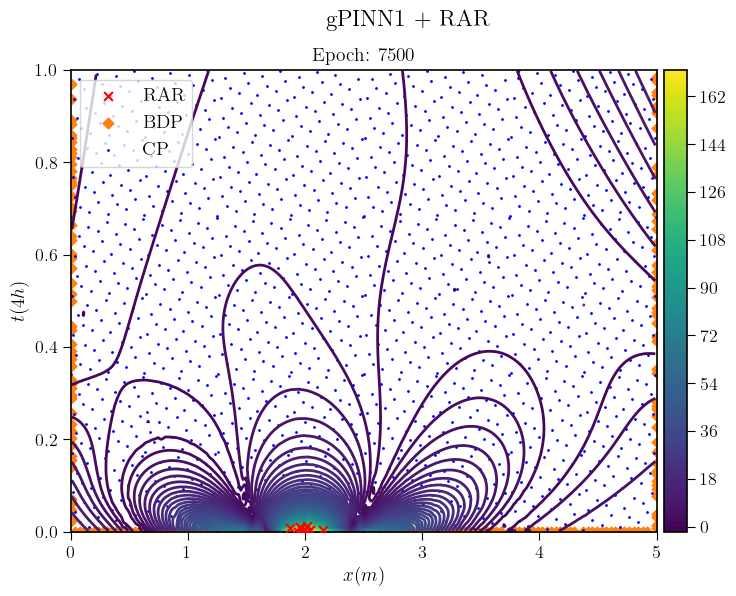

: 

: 

In [ ]:
fig, ax = plt.subplots(figsize=(9, 6))
cont = ax.contourf(X1, T1, error_grid[0], levels=100)
cbar = fig.colorbar(cont, ax=ax, pad=0.01)

# Extraer puntos de collocation, boundary e inicial.
collocation_points = data.train_x   # Todos los puntos de entrenamiento.
boundary_points = data.bc_points()  # Puntos de frontera.

all_points_tuples = set(map(tuple, collocation_points))
boundary_points_tuples = set(map(tuple, boundary_points))

# Collocation points = todos los puntos menos los de frontera/inicial.
collocation_points_tuples = all_points_tuples - boundary_points_tuples
collocation_points = np.array(list(collocation_points_tuples))

def animate(i):
    ax.clear()
    cp = RAR_history[i]

    ax.scatter(cp[:, 0], cp[:, 1], marker="x", c="r", s=40, label="RAR",zorder=3)

    ax.contour(X1, T1, error_grid[i], levels=100, linewidths=2)
    
    ax.scatter(boundary_points[:, 0], boundary_points[:, 1], marker="D", c='tab:orange', s=30, label="BDP")

    ax.scatter(collocation_points[:, 0], collocation_points[:, 1], s=4, marker=".", c="b", label="CP")
    
    ax.set_xlabel("$x (m)$")
    ax.set_ylabel("$t (4h)$")
    plt.suptitle("gPINN1 + RAR")
    ax.set_title(f"Epoch: {(i*2000)+7500}")
    ax.legend(loc='upper left')
    ax.set_xlim(0, 5)
    ax.set_ylim(0, 1)

# Crear animación
ani = animation.FuncAnimation(fig, animate, frames=len(error_grid), interval=700)
HTML(ani.to_html5_video())

### Modelo más complejo

#### Tiempo de entrenamiento

In [7]:
# Reescalar la solución.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=7500)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
model.train()

# RAR manual: refinamiento adaptativo.
err = 101
RAR_threshold = 45
iter = 7500
while iter < 13500:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1reescaladox(X)  # Reescalar la solución analítica.
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  # (5, 2)

    err = np.mean(err)*F**2
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
    # Entrenar el modelo.
    model.train(iterations=2000, disregard_previous_best=False)
    model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
    losshistory5, train_state = model.train()
    iter = iter + 2000

Compiling model...
Building feed-forward neural network...
'build' took 0.030661 s

'compile' took 0.549419 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.33e-01, 1.49e-03, 2.24e-02, 1.18e-02, 2.98e-02, 3.23e+00]    [1.11e-01, 1.71e-03, 2.69e-02, 1.18e-02, 2.98e-02, 3.23e+00]    [3.50e-01]    
7500      [5.62e-03, 6.37e-03, 5.97e-02, 6.53e-03, 2.87e-03, 5.07e-01]    [4.96e-03, 4.52e-03, 2.97e-02, 6.53e-03, 2.87e-03, 5.07e-01]    [1.64e-02]    

Best model at step 7500:
  train loss: 5.89e-01
  test loss: 5.56e-01
  test metric: [1.64e-02]

'train' took 261.723627 s

Compiling model...
'compile' took 0.284528 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [5.62e-03, 6.37e-03, 5.97e-02, 6.53e-03, 2.87e-03, 5.07e-0

2025-06-27 08:39:09.281386: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_7/bias/Adam_3/Assign' id:18439 op device:{requested: '', assigned: ''} def:{{{node dense_7/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_7/bias/Adam_3, dense_7/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7517      [5.62e-03, 6.37e-03, 7.31e-02, 6.53e-03, 2.87e-03, 5.07e-01]    [4.96e-03, 4.52e-03, 2.97e-02, 6.53e-03, 2.87e-03, 5.07e-01]    [1.64e-02]    
8000      [5.22e-03, 6.12e-03, 1.72e-02, 6.56e-03, 2.64e-03, 5.63e-01]    [4.78e-03, 4.46e-03, 2.18e-02, 6.56e-03, 2.64e-03, 5.63e-01]    [1.78e-02]    
9000      [5.03e-03, 5.90e-03, 2.97e-02, 6.74e-03, 2.84e-03, 4.87e-01]    [4.74e-03, 4.31e-03, 2.71e-02, 6.74e-03, 2.84e-03, 4.87e-01]    [1.59e-02]    
9517      [4.63e-03, 6.38e-03, 7.23e-02, 6.76e-03, 3.04e-03, 4.89e-01]    [4.36e-03, 4.19e-03, 2.78e-02, 6.76e-03, 3.04e-03, 4.89e-01]    [1.57e-02]    

Best model at step 9000:
  train loss: 5.37e-01
  test loss: 5.33e-01
  test metric: [1.59e-02]

'train' took 72.479635 s

Compiling model...
'compile' took 0.298989 s

Training model...

Step      Train loss       

2025-06-27 08:40:24.221474: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_7/bias/Adam_5/Assign' id:22681 op device:{requested: '', assigned: ''} def:{{{node dense_7/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_7/bias/Adam_5, dense_7/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9535      [4.63e-03, 6.40e-03, 7.52e-02, 6.76e-03, 3.04e-03, 4.89e-01]    [4.36e-03, 4.19e-03, 2.78e-02, 6.76e-03, 3.04e-03, 4.89e-01]    [1.57e-02]    
10000     [4.74e-03, 5.73e-03, 1.94e-02, 6.47e-03, 2.75e-03, 5.42e-01]    [4.38e-03, 4.14e-03, 2.32e-02, 6.47e-03, 2.75e-03, 5.42e-01]    [1.71e-02]    
11000     [5.75e-03, 9.36e-03, 2.87e-01, 6.90e-03, 2.69e-03, 4.66e-01]    [3.90e-03, 4.13e-03, 4.08e-02, 6.90e-03, 2.69e-03, 4.66e-01]    [1.52e-02]    
11535     [4.25e-03, 5.45e-03, 2.24e-02, 6.73e-03, 2.71e-03, 4.88e-01]    [4.12e-03, 3.80e-03, 2.27e-02, 6.73e-03, 2.71e-03, 4.88e-01]    [1.59e-02]    

Best model at step 11535:
  train loss: 5.29e-01
  test loss: 5.28e-01
  test metric: [1.59e-02]

'train' took 76.156554 s

Compiling model...
'compile' took 0.435928 s

Training model...

Step      Train loss      

2025-06-27 08:41:43.203764: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_7/bias/Adam_7/Assign' id:26967 op device:{requested: '', assigned: ''} def:{{{node dense_7/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_7/bias/Adam_7, dense_7/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11551     [4.24e-03, 5.46e-03, 2.30e-02, 6.73e-03, 2.71e-03, 4.88e-01]    [4.12e-03, 3.80e-03, 2.27e-02, 6.73e-03, 2.71e-03, 4.88e-01]    [1.59e-02]    
12000     [4.32e-03, 5.48e-03, 1.96e-02, 6.26e-03, 2.77e-03, 5.44e-01]    [4.02e-03, 3.69e-03, 2.15e-02, 6.26e-03, 2.77e-03, 5.44e-01]    [1.70e-02]    
13000     [3.90e-03, 5.93e-03, 4.37e-02, 6.47e-03, 3.07e-03, 4.70e-01]    [3.83e-03, 3.40e-03, 2.82e-02, 6.47e-03, 3.07e-03, 4.70e-01]    [1.51e-02]    
13551     [3.48e-03, 6.39e-03, 7.79e-02, 6.78e-03, 3.00e-03, 4.75e-01]    [3.25e-03, 3.46e-03, 2.81e-02, 6.78e-03, 3.00e-03, 4.75e-01]    [1.51e-02]    

Best model at step 11535:
  train loss: 5.29e-01
  test loss: 5.28e-01
  test metric: [1.59e-02]

'train' took 81.232453 s

Compiling model...
'compile' took 0.310056 s

Training model...

Step      Train loss      

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None
        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
# Entrenar el modelo
mem_cb = MemoryCallback()
mem_cb1 = MemoryCallback()
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
model.train()
memoria_por_epoca1 = mem_cb.get_memory()
memoriaini = mem_cb.mem_init

# RAR manual: refinamiento adaptativo.
err = 101
RAR_threshold = 45

while err > RAR_threshold:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1reescaladox(X)  
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  

    err = np.mean(err)*F**2
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
    # Entrenar el modelo.
    model.train(iterations=2000, display_every=1,disregard_previous_best=False, callbacks=[mem_cb1])
    model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
    losshistory5, train_state = model.train()

memooo = mem_cb1.get_memory()

Compiling model...
Building feed-forward neural network...
'build' took 0.047947 s

'compile' took 0.692478 s

Training model...

0         [9.61e-02, 6.03e-03, 1.84e-01, 5.54e-02, 2.89e-01, 2.59e+00]    [6.05e-02, 6.02e-03, 1.87e-01, 5.54e-02, 2.89e-01, 2.59e+00]    [1.75e-01]    
1         [4.25e-02, 3.71e-03, 8.96e-02, 3.31e-02, 1.83e-01, 2.58e+00]    [3.05e-02, 3.70e-03, 8.90e-02, 3.31e-02, 1.83e-01, 2.58e+00]    [1.78e-01]    
2         [1.65e-02, 2.01e-03, 3.17e-02, 1.89e-02, 1.07e-01, 2.57e+00]    [1.72e-02, 2.00e-03, 2.98e-02, 1.89e-02, 1.07e-01, 2.57e+00]    [1.91e-01]    
3         [1.67e-02, 8.87e-04, 4.75e-03, 1.03e-02, 5.61e-02, 2.57e+00]    [1.96e-02, 8.84e-04, 3.51e-03, 1.03e-02, 5.61e-02, 2.57e+00]    [2.13e-01]    
4         [3.70e-02, 2.65e-04, 1.38e-03, 6.43e-03, 2.57e-02, 2.56e+00]    [3.42e-02, 2.64e-04, 2.03e-03, 6.43e-03, 2.57e-02, 2.56e+00]    [2.37e-01]    
5         [6.76e-02, 2.85e-05, 1.13e-02, 5.86e-03, 1.09e-02, 2.55e+00]    [5.51e-02, 2.61e-05, 1.42e-02, 

2025-06-26 20:20:26.109591: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_3/Assign' id:59662 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_3, dense_24/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7516      [8.70e-03, 5.12e-03, 3.44e-02, 1.36e-02, 2.79e-03, 5.61e-01]    [8.29e-03, 4.04e-03, 3.34e-02, 1.36e-02, 2.79e-03, 5.61e-01]    [1.94e-02]    
7517      [3.14e-01, 1.25e+00, 5.86e+01, 3.04e-02, 1.38e-03, 5.32e-01]    [3.55e-02, 1.27e-01, 3.32e+00, 3.04e-02, 1.38e-03, 5.32e-01]    [1.94e-02]    
7518      [2.41e-02, 1.35e-01, 3.87e+00, 1.72e-02, 2.43e-03, 5.62e-01]    [8.62e-03, 2.06e-02, 2.61e-01, 1.72e-02, 2.43e-03, 5.62e-01]    [1.92e-02]    
7519      [9.06e-02, 1.70e-01, 1.32e+01, 8.75e-03, 3.75e-03, 5.93e-01]    [1.81e-02, 2.03e-02, 7.90e-01, 8.75e-03, 3.75e-03, 5.93e-01]    [2.19e-02]    
7520      [1.80e-01, 3.73e-01, 3.10e+01, 6.62e-03, 3.85e-03, 6.10e-01]    [2.85e-02, 4.82e-02, 1.70e+00, 6.62e-03, 3.85e-03, 6.10e-01]    [2.37e-02]    
7521      [1.20e-01, 2.75e-01, 2.29e+01, 7.36e-03, 3.25e-03, 6.

2025-06-26 20:23:18.580891: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_5/Assign' id:64718 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_5, dense_24/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9534      [7.98e-03, 4.64e-03, 2.89e-02, 1.34e-02, 2.93e-03, 5.29e-01]    [7.66e-03, 3.82e-03, 2.94e-02, 1.34e-02, 2.93e-03, 5.29e-01]    [1.84e-02]    
9535      [3.88e-01, 9.40e-01, 6.94e+01, 2.67e-02, 8.83e-03, 4.96e-01]    [4.87e-02, 1.02e-01, 3.79e+00, 2.67e-02, 8.83e-03, 4.96e-01]    [1.88e-02]    
9536      [3.49e-02, 1.18e-01, 4.54e+00, 1.68e-02, 3.91e-03, 5.25e-01]    [1.03e-02, 1.89e-02, 3.51e-01, 1.68e-02, 3.91e-03, 5.25e-01]    [1.70e-02]    
9537      [8.30e-02, 1.24e-01, 1.23e+01, 1.01e-02, 1.09e-03, 5.56e-01]    [1.88e-02, 1.92e-02, 6.03e-01, 1.01e-02, 1.09e-03, 5.56e-01]    [2.42e-02]    
9538      [2.00e-01, 3.18e-01, 3.31e+01, 8.06e-03, 4.94e-04, 5.78e-01]    [3.64e-02, 4.19e-02, 1.66e+00, 8.06e-03, 4.94e-04, 5.78e-01]    [3.11e-02]    
9539      [1.58e-01, 2.33e-01, 2.82e+01, 8.39e-03, 5.01e-04, 5.

2025-06-26 20:26:05.878612: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_7/Assign' id:69818 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_7, dense_24/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11550     [7.54e-03, 4.26e-03, 2.88e-02, 1.32e-02, 2.92e-03, 5.05e-01]    [7.29e-03, 3.60e-03, 2.78e-02, 1.32e-02, 2.92e-03, 5.05e-01]    [1.76e-02]    
11551     [3.75e-01, 1.10e+00, 7.77e+01, 2.53e-02, 7.40e-03, 4.74e-01]    [3.82e-02, 9.64e-02, 3.77e+00, 2.53e-02, 7.40e-03, 4.74e-01]    [1.63e-02]    
11552     [3.04e-02, 1.16e-01, 5.42e+00, 1.55e-02, 4.27e-03, 5.06e-01]    [1.03e-02, 1.65e-02, 3.49e-01, 1.55e-02, 4.27e-03, 5.06e-01]    [1.64e-02]    
11553     [8.66e-02, 1.60e-01, 1.46e+01, 9.42e-03, 1.63e-03, 5.36e-01]    [1.59e-02, 1.69e-02, 6.45e-01, 9.42e-03, 1.63e-03, 5.36e-01]    [2.20e-02]    
11554     [2.02e-01, 3.46e-01, 3.82e+01, 8.01e-03, 7.27e-04, 5.53e-01]    [2.61e-02, 3.53e-02, 1.68e+00, 8.01e-03, 7.27e-04, 5.53e-01]    [2.68e-02]    
11555     [1.56e-01, 2.53e-01, 3.14e+01, 8.59e-03, 7.10e-04, 5.

2025-06-26 20:28:57.185948: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_9/Assign' id:74962 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_9, dense_24/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13566     [9.50e-03, 1.26e-02, 3.72e-01, 1.31e-02, 2.72e-03, 5.13e-01]    [7.03e-03, 4.28e-03, 5.78e-02, 1.31e-02, 2.72e-03, 5.13e-01]    [1.80e-02]    
13567     [4.01e-01, 1.35e+00, 7.24e+01, 4.62e-03, 8.28e-03, 5.70e-01]    [5.50e-02, 1.19e-01, 3.62e+00, 4.62e-03, 8.28e-03, 5.70e-01]    [2.37e-02]    
13568     [3.25e-02, 9.04e-02, 5.17e+00, 1.01e-02, 4.27e-03, 5.40e-01]    [1.13e-02, 1.37e-02, 2.43e-01, 1.01e-02, 4.27e-03, 5.40e-01]    [1.89e-02]    
13569     [9.42e-02, 3.60e-01, 1.34e+01, 1.82e-02, 1.72e-03, 5.12e-01]    [1.41e-02, 3.22e-02, 9.01e-01, 1.82e-02, 1.72e-03, 5.12e-01]    [1.78e-02]    
13570     [2.45e-01, 1.01e+00, 3.65e+01, 2.21e-02, 1.12e-03, 5.08e-01]    [3.06e-02, 8.94e-02, 2.32e+00, 2.21e-02, 1.12e-03, 5.08e-01]    [1.88e-02]    
13571     [2.04e-01, 8.70e-01, 2.84e+01, 2.03e-02, 1.08e-03, 5.

2025-06-26 20:31:45.769542: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_11/Assign' id:80150 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_11, dense_24/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15583     [6.20e-03, 4.42e-03, 2.39e-02, 1.30e-02, 3.10e-03, 4.92e-01]    [6.60e-03, 3.55e-03, 1.76e-02, 1.30e-02, 3.10e-03, 4.92e-01]    [1.69e-02]    
15584     [3.28e-01, 2.28e+00, 6.52e+01, 1.56e-02, 9.10e-03, 5.20e-01]    [5.34e-02, 2.53e-01, 3.72e+00, 1.56e-02, 9.10e-03, 5.20e-01]    [1.74e-02]    
15585     [3.30e-02, 2.33e-01, 6.03e+00, 1.75e-02, 4.28e-03, 4.97e-01]    [1.21e-02, 4.27e-02, 5.91e-01, 1.75e-02, 4.28e-03, 4.97e-01]    [1.64e-02]    
15586     [8.58e-02, 4.72e-01, 1.36e+01, 1.62e-02, 1.56e-03, 4.86e-01]    [1.67e-02, 4.56e-02, 6.96e-01, 1.62e-02, 1.56e-03, 4.86e-01]    [1.76e-02]    
15587     [1.79e-01, 1.23e+00, 2.83e+01, 1.24e-02, 9.54e-04, 4.95e-01]    [4.10e-02, 1.49e-01, 1.79e+00, 1.24e-02, 9.54e-04, 4.95e-01]    [1.98e-02]    
15588     [1.70e-01, 1.20e+00, 2.63e+01, 9.62e-03, 1.11e-03, 5.

2025-06-26 20:34:42.051908: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_13/Assign' id:85382 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_13, dense_24/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17600     [7.08e-03, 4.26e-03, 1.97e-02, 1.21e-02, 2.78e-03, 4.70e-01]    [6.90e-03, 3.29e-03, 1.79e-02, 1.21e-02, 2.78e-03, 4.70e-01]    [1.65e-02]    
17601     [2.99e-01, 5.41e-01, 7.27e+01, 2.19e-02, 1.27e-02, 4.65e-01]    [3.87e-02, 6.52e-02, 3.30e+00, 2.19e-02, 1.27e-02, 4.65e-01]    [1.68e-02]    
17602     [2.02e-02, 4.03e-02, 4.99e+00, 1.41e-02, 5.38e-03, 4.78e-01]    [8.83e-03, 8.87e-03, 2.66e-01, 1.41e-02, 5.38e-03, 4.78e-01]    [1.54e-02]    
17603     [7.61e-02, 1.53e-01, 1.24e+01, 9.43e-03, 1.32e-03, 4.89e-01]    [1.52e-02, 2.56e-02, 5.75e-01, 9.43e-03, 1.32e-03, 4.89e-01]    [2.07e-02]    
17604     [1.74e-01, 2.37e-01, 3.42e+01, 7.93e-03, 5.21e-04, 4.99e-01]    [2.66e-02, 3.50e-02, 1.53e+00, 7.93e-03, 5.21e-04, 4.99e-01]    [2.57e-02]    
17605     [1.48e-01, 1.59e-01, 2.98e+01, 7.70e-03, 5.44e-04, 5.

2025-06-26 20:37:36.794513: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_15/Assign' id:90658 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_15, dense_24/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
19617     [6.85e-03, 4.14e-03, 3.46e-02, 1.20e-02, 3.01e-03, 4.53e-01]    [6.56e-03, 3.17e-03, 1.95e-02, 1.20e-02, 3.01e-03, 4.53e-01]    [1.59e-02]    
19618     [5.82e-01, 2.63e+00, 1.20e+02, 2.57e-02, 1.20e-03, 4.13e-01]    [5.25e-02, 2.00e-01, 5.08e+00, 2.57e-02, 1.20e-03, 4.13e-01]    [1.61e-02]    
19619     [4.72e-02, 1.98e-01, 7.91e+00, 1.49e-02, 2.16e-03, 4.46e-01]    [9.02e-03, 1.79e-02, 3.81e-01, 1.49e-02, 2.16e-03, 4.46e-01]    [1.56e-02]    
19620     [1.08e-01, 3.54e-01, 2.19e+01, 7.71e-03, 4.07e-03, 4.84e-01]    [1.69e-02, 2.93e-02, 8.58e-01, 7.71e-03, 4.07e-03, 4.84e-01]    [1.82e-02]    
19621     [2.71e-01, 9.65e-01, 6.05e+01, 5.77e-03, 5.13e-03, 5.07e-01]    [3.22e-02, 7.65e-02, 2.34e+00, 5.77e-03, 5.13e-03, 5.07e-01]    [2.02e-02]    
19622     [1.97e-01, 7.32e-01, 4.96e+01, 6.48e-03, 4.65e-03, 5.

2025-06-26 20:40:32.612958: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_17/Assign' id:95978 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_17/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_17, dense_24/bias/Adam_17/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
21634     [6.21e-03, 3.85e-03, 1.50e-02, 1.20e-02, 2.91e-03, 4.60e-01]    [6.44e-03, 3.29e-03, 1.52e-02, 1.20e-02, 2.91e-03, 4.60e-01]    [1.61e-02]    
21635     [2.92e-01, 1.12e+00, 7.60e+01, 4.36e-03, 1.02e-03, 4.45e-01]    [4.91e-02, 1.92e-01, 4.03e+00, 4.36e-03, 1.02e-03, 4.45e-01]    [2.14e-02]    
21636     [3.55e-02, 2.48e-01, 6.08e+00, 1.03e-02, 2.23e-03, 4.47e-01]    [1.15e-02, 3.03e-02, 4.16e-01, 1.03e-02, 2.23e-03, 4.47e-01]    [1.63e-02]    
21637     [5.37e-02, 1.33e-01, 1.43e+01, 1.86e-02, 5.04e-03, 4.62e-01]    [1.24e-02, 3.03e-02, 7.01e-01, 1.86e-02, 5.04e-03, 4.62e-01]    [1.49e-02]    
21638     [1.43e-01, 6.25e-01, 3.64e+01, 2.24e-02, 7.59e-03, 4.84e-01]    [3.00e-02, 1.13e-01, 2.20e+00, 2.24e-02, 7.59e-03, 4.84e-01]    [1.57e-02]    
21639     [1.35e-01, 7.48e-01, 3.20e+01, 2.09e-02, 7.54e-03, 4.

2025-06-26 20:43:27.615970: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_19/Assign' id:101342 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_19/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_19, dense_24/bias/Adam_19/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
23652     [5.69e-03, 3.83e-03, 1.47e-02, 1.19e-02, 2.89e-03, 4.85e-01]    [6.07e-03, 3.28e-03, 1.34e-02, 1.19e-02, 2.89e-03, 4.85e-01]    [1.65e-02]    
23653     [4.68e-01, 2.27e+00, 7.38e+01, 8.10e-03, 2.11e-03, 5.31e-01]    [6.17e-02, 2.13e-01, 4.11e+00, 8.10e-03, 2.11e-03, 5.31e-01]    [2.70e-02]    
23654     [4.09e-02, 1.93e-01, 6.34e+00, 1.15e-02, 1.69e-03, 4.97e-01]    [1.12e-02, 2.61e-02, 4.29e-01, 1.15e-02, 1.69e-03, 4.97e-01]    [1.94e-02]    
23655     [1.14e-01, 5.67e-01, 1.54e+01, 1.50e-02, 2.36e-03, 4.70e-01]    [1.83e-02, 5.62e-02, 7.32e-01, 1.50e-02, 2.36e-03, 4.70e-01]    [1.53e-02]    
23656     [2.70e-01, 1.41e+00, 3.46e+01, 1.48e-02, 3.83e-03, 4.71e-01]    [4.61e-02, 1.50e-01, 2.10e+00, 1.48e-02, 3.83e-03, 4.71e-01]    [1.50e-02]    
23657     [2.46e-01, 1.28e+00, 2.95e+01, 1.26e-02, 4.64e-03, 4.

2025-06-26 20:46:25.785126: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_21/Assign' id:106750 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_21/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_21, dense_24/bias/Adam_21/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
25668     [5.57e-03, 3.67e-03, 1.55e-02, 1.18e-02, 2.84e-03, 4.98e-01]    [5.90e-03, 3.29e-03, 1.35e-02, 1.18e-02, 2.84e-03, 4.98e-01]    [1.68e-02]    
25669     [4.89e-01, 2.75e+00, 7.38e+01, 1.66e-02, 8.64e-04, 4.50e-01]    [6.89e-02, 2.52e-01, 4.31e+00, 1.66e-02, 8.64e-04, 4.50e-01]    [1.86e-02]    
25670     [3.98e-02, 3.00e-01, 5.46e+00, 1.17e-02, 1.74e-03, 4.88e-01]    [1.15e-02, 3.36e-02, 4.08e-01, 1.17e-02, 1.74e-03, 4.88e-01]    [1.73e-02]    
25671     [1.14e-01, 4.65e-01, 1.61e+01, 9.27e-03, 5.30e-03, 5.29e-01]    [1.87e-02, 3.62e-02, 7.95e-01, 9.27e-03, 5.30e-03, 5.29e-01]    [1.81e-02]    
25672     [2.26e-01, 1.15e+00, 3.62e+01, 1.02e-02, 8.00e-03, 5.52e-01]    [3.76e-02, 9.71e-02, 2.09e+00, 1.02e-02, 8.00e-03, 5.52e-01]    [1.87e-02]    
25673     [1.59e-01, 1.02e+00, 3.01e+01, 1.21e-02, 7.56e-03, 5.

2025-06-26 20:49:16.962630: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_24/bias/Adam_23/Assign' id:112202 op device:{requested: '', assigned: ''} def:{{{node dense_24/bias/Adam_23/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_24/bias/Adam_23, dense_24/bias/Adam_23/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
27684     [5.86e-03, 4.03e-03, 1.42e-02, 1.13e-02, 2.72e-03, 4.49e-01]    [5.85e-03, 3.07e-03, 1.22e-02, 1.13e-02, 2.72e-03, 4.49e-01]    [1.56e-02]    
27685     [5.48e-01, 2.90e+00, 1.06e+02, 2.22e-02, 2.06e-03, 4.01e-01]    [4.53e-02, 2.24e-01, 3.98e+00, 2.22e-02, 2.06e-03, 4.01e-01]    [1.44e-02]    
27686     [3.45e-02, 2.17e-01, 5.08e+00, 1.38e-02, 2.78e-03, 4.36e-01]    [7.53e-03, 2.09e-02, 2.70e-01, 1.38e-02, 2.78e-03, 4.36e-01]    [1.46e-02]    
27687     [1.17e-01, 4.33e-01, 2.49e+01, 8.23e-03, 3.05e-03, 4.71e-01]    [1.44e-02, 3.43e-02, 8.06e-01, 8.23e-03, 3.05e-03, 4.71e-01]    [1.78e-02]    
27688     [2.51e-01, 1.07e+00, 5.50e+01, 6.64e-03, 2.37e-03, 4.90e-01]    [2.69e-02, 9.33e-02, 1.85e+00, 6.64e-03, 2.37e-03, 4.90e-01]    [2.08e-02]    
27689     [1.77e-01, 9.57e-01, 4.09e+01, 6.98e-03, 1.68e-03, 4.

In [ ]:
# Corregir la memoria restando la memoria inicial.
memoria1 = np.array(memoria_por_epoca1) - memoriaini
memoria2 = np.array(memooo) - memoriaini

# Métricas MSE.
mse1 = np.array(losshistory5.metrics_test)[:7500]
mse2 = np.array(losshistory5.metrics_test)[7500:]

# Concatenar para graficar todo en una sola curva.
memoria_total = np.concatenate([memoria1, memoria2])
mse_total = (np.concatenate([mse1, mse2]))*F**2

In [ ]:
np.savetxt('memoriasgPINN2RAR.txt', memoria_total)
np.savetxt('MSEgPINN2RAR.txt', mse_total)

: 

In [13]:
iteracioness = len(memoria_total)
print("Iteraciones:", iteracioness)

Iteraciones: 13500


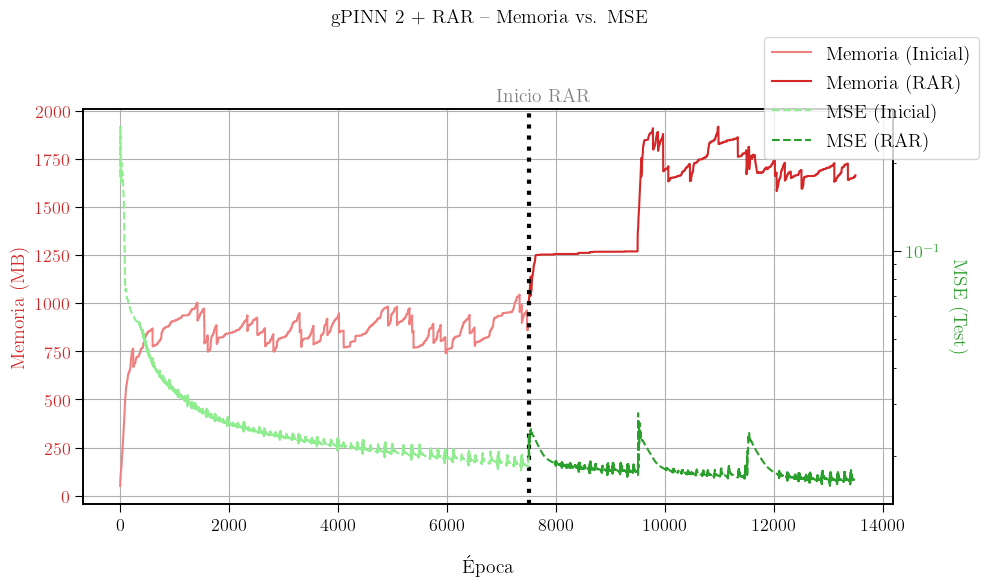

In [ ]:
fig, ax1 = plt.subplots(figsize=(10, 6))
plt.suptitle("gPINN 2 + RAR – Memoria vs. MSE", fontsize=14)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'  
color1_dark = 'tab:red'    

ax1.set_xlabel("Época", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', color=color1_light, label="Memoria (Inicial)")
ax1.plot(range(len(memoria1), len(memoria_total)), memoria2, '-', color=color1_dark, label="Memoria (RAR)")
ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrico de Test (MSE).
color2_light = '#90ee90'   
color2_dark = 'tab:green'

ax2 = ax1.twinx()
ax2.set_ylabel("MSE (Test)", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--', color=color2_light, label="MSE (Inicial)")
ax2.plot(range(len(mse1), len(mse_total)), mse2, '--', color=color2_dark, label="MSE (RAR)")
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "Inicio RAR", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
fig.legend(lines1 + lines2, labels1 + labels2, loc="upper right", bbox_to_anchor=(1, 0.95))

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

Comparación con gPINN 2

tiempo

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=13500, display_every=13500)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.067521 s

'compile' took 0.493655 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   


I0000 00:00:1751007889.380151  483937 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


0         [8.62e-03, 7.59e-05, 4.78e-03, 3.17e-03, 2.36e-03, 2.84e+00]    [5.85e-03, 5.56e-05, 4.93e-03, 3.17e-03, 2.36e-03, 2.84e+00]    [3.60e-01]    
13500     [3.80e-03, 6.35e-03, 5.45e-02, 4.75e-03, 3.64e-03, 5.06e-01]    [3.35e-03, 3.80e-03, 2.65e-02, 4.75e-03, 3.64e-03, 5.06e-01]    [1.60e-02]    

Best model at step 13500:
  train loss: 5.79e-01
  test loss: 5.48e-01
  test metric: [1.60e-02]

'train' took 474.728808 s

Compiling model...
'compile' took 0.236741 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13500     [3.80e-03, 6.35e-03, 5.45e-02, 4.75e-03, 3.64e-03, 5.06e-01]    [3.35e-03, 3.80e-03, 2.65e-02, 4.75e-03, 3.64e-03, 5.06e-01]    [1.60e-02]    
INFO:tensorflow:Optimization terminated with:
  Message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  Objective function value: 0.579005
  Number of iterations: 1
  Number of functions evaluat

consumo de memoria

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

mem_cb = MemoryCallback()

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=13500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.032625 s

'compile' took 0.442446 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.14e+00, 1.41e-03, 6.28e-01, 2.06e-01, 7.05e-02, 3.23e+00]    [7.79e-01, 1.88e-03, 7.40e-01, 2.06e-01, 7.05e-02, 3.23e+00]    [2.11e-01]    


I0000 00:00:1750954125.403996   76645 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [7.63e-01, 9.09e-04, 4.61e-01, 1.70e-01, 6.26e-02, 3.03e+00]    [5.10e-01, 1.22e-03, 5.37e-01, 1.70e-01, 6.26e-02, 3.03e+00]    [1.96e-01]    
2         [4.71e-01, 5.45e-04, 3.24e-01, 1.39e-01, 5.78e-02, 2.86e+00]    [3.06e-01, 7.42e-04, 3.74e-01, 1.39e-01, 5.78e-02, 2.86e+00]    [1.85e-01]    
3         [2.58e-01, 2.98e-04, 2.14e-01, 1.13e-01, 5.55e-02, 2.73e+00]    [1.60e-01, 4.14e-04, 2.45e-01, 1.13e-01, 5.55e-02, 2.73e+00]    [1.77e-01]    
4         [1.15e-01, 1.49e-04, 1.30e-01, 9.01e-02, 5.47e-02, 2.62e+00]    [6.70e-02, 2.09e-04, 1.47e-01, 9.01e-02, 5.47e-02, 2.62e+00]    [1.73e-01]    
5         [3.51e-02, 7.49e-05, 6.87e-02, 7.13e-02, 5.47e-02, 2.55e+00]    [1.87e-02, 9.88e-05, 7.71e-02, 7.13e-02, 5.47e-02, 2.55e+00]    [1.73e-01]    
6         [7.19e-03, 5.12e-05, 2.86e-02, 5.59e-02, 5.44e-02, 2.49e+00]    [7.99e-03, 5.35e-05, 3.16e-02, 5.59e-02, 5.44e-02, 2.49e+00]    [1.75e-01]    
7         [2.08e-02, 5.37e-05, 6.82e-03, 4.36e-02, 5.27e-02, 2.46e+00]    [2.62e-0

In [33]:
metrictest = np.array(losshistory135.metrics_test)*F**2

In [12]:
memoria_por_epoca = mem_cb.get_memory()
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [28]:
np.savetxt('memoriasPRUEBAgPINN2.txt', memoria_por_epoca)

In [17]:
memorias = np.loadtxt('memoriasgPINN2RAR.txt')
mse = np.loadtxt('MSEgPINN2RAR.txt')

In [29]:
memoria_por_epoca=np.loadtxt('memoriasPRUEBAgPINN2.txt')

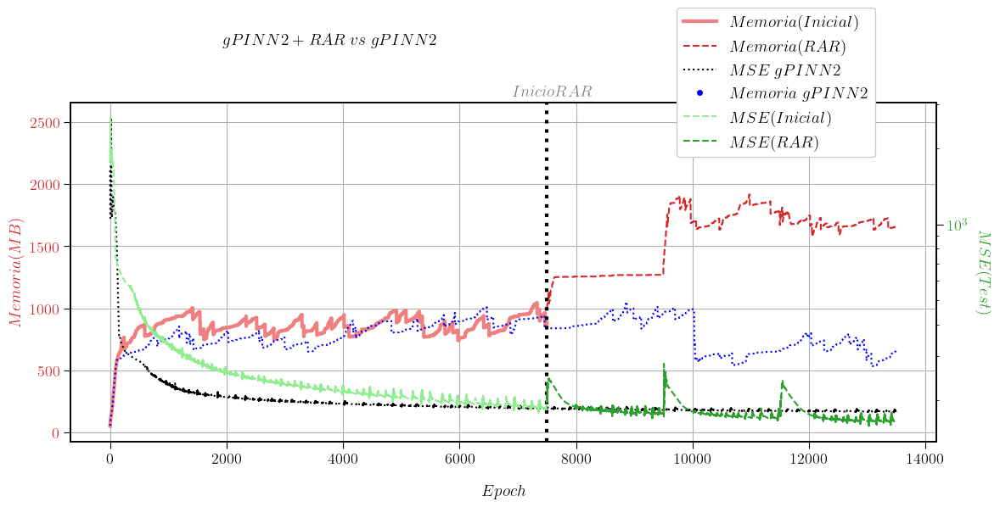

In [ ]:
memoria1 = memorias[:7500]
memoria2 = memorias[7500:]
mse1 = mse[:7500]
mse2 = mse[7500:]


fig, ax1 = plt.subplots(figsize=(8, 6))
plt.suptitle(r"$gPINN 2 + RAR \; vs \; gPINN2$", fontsize=14, y=0.95)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'  
color1_dark = 'tab:red'   

ax1.set_xlabel("$Epoch$", labelpad=15)
ax1.set_ylabel("$Memoria (MB)$", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', linewidth = 3,color=color1_light, label="$Memoria (Inicial)$")
ax1.plot(range(len(memoria1), len(memoria1)+len(memoria2)), memoria2, "--", color=color1_dark, label="$Memoria (RAR)$")
ax1.plot(range( len(memoria1)+len(memoria2)), memoria_por_epoca, ':', color='b', markersize = 0.8)
memoria_gpinn1_legend = Line2D([0], [0], marker='.', color='b', linestyle='None', 
                               markersize=8, label=r"$Memoria \; gPINN 2$")

ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrico de Test (MSE).
color2_light = '#90ee90'  
color2_dark = 'tab:green'  

ax2 = ax1.twinx()
ax2.set_ylabel("$MSE (Test)$", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--',color=color2_light, label="$MSE (Inicial)$")
ax2.plot(range(len(mse1), len(mse1)+len(mse2)), mse2, '--', color=color2_dark, label="$MSE (RAR)$")
ax1.plot(range( 13500), metrictest[:13500], ':', color='k' ,label=r"$MSE \; gPINN 2$")
ax2.set_yscale("log")
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "$Inicio RAR$", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
fig.legend(lines1 + [memoria_gpinn1_legend] + lines2, 
           labels1 + [r"$Memoria \; gPINN 2$"] + labels2,
           loc="upper left",
           bbox_to_anchor=(1.01, 1),  
           borderaxespad=0.,
           prop={'size': 14},
            frameon=True,             
           facecolor='white',       
           framealpha=1.0)  

fig.tight_layout(rect=[0, 0, 1.5, 0.95])
plt.show()


#### Gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 100  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101 
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model, XT, save_every=100)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
model.train()

# RAR manual: refinamiento adaptativo.
err = 101
RAR_threshold = 45

while err > RAR_threshold:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1reescaladox(X) 
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  

    err = np.mean(err)*F**2
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
    # Entrenar el modelo.
    model.train(iterations=2000, display_every=1, disregard_previous_best=False, callbacks=[PredictionLogger])
    model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
    losshistory5, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.037007 s

'compile' took 1.145553 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [9.60e-02, 6.04e-03, 1.84e-01, 6.34e-02, 2.79e-01, 2.59e+00]    [6.05e-02, 6.02e-03, 1.87e-01, 6.34e-02, 2.79e-01, 2.59e+00]    [1.74e-01]    
1         [4.23e-02, 3.71e-03, 8.97e-02, 3.75e-02, 1.78e-01, 2.58e+00]    [3.05e-02, 3.69e-03, 8.90e-02, 3.75e-02, 1.78e-01, 2.58e+00]    [1.77e-01]    
2         [1.63e-02, 2.01e-03, 3.17e-02, 2.07e-02, 1.05e-01, 2.57e+00]    [1.72e-02, 2.00e-03, 2.98e-02, 2.07e-02, 1.05e-01, 2.57e+00]    [1.91e-01]    
3         [1.65e-02, 8.91e-04, 4.74e-03, 1.08e-02, 5.56e-02, 2.57e+00]    [1.95e-02, 8.87e-04, 3.50e-03, 1.08e-02, 5.56e-02, 2.57e+00]    [2.13e-01]    
4         [3.67e-02, 2.68e-04, 1.38e-03, 6.17e-03, 2.60e-02, 2.56e+00]    [3.39e-02, 2.67e-04, 2.03e-03, 

2025-06-26 21:26:24.914161: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_3/Assign' id:124453 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_3, dense_29/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7517      [1.40e-02, 1.02e-02, 3.04e-01, 1.21e-02, 2.96e-03, 5.92e-01]    [9.91e-03, 4.41e-03, 3.56e-02, 1.21e-02, 2.96e-03, 5.92e-01]    [2.10e-02]    
7518      [3.21e-01, 1.28e+00, 4.56e+01, 2.65e-02, 1.34e-03, 5.41e-01]    [4.05e-02, 1.10e-01, 3.16e+00, 2.65e-02, 1.34e-03, 5.41e-01]    [1.89e-02]    
7519      [3.38e-02, 1.42e-01, 3.16e+00, 1.56e-02, 2.33e-03, 5.78e-01]    [1.08e-02, 1.84e-02, 3.02e-01, 1.56e-02, 2.33e-03, 5.78e-01]    [1.93e-02]    
7520      [7.21e-02, 1.58e-01, 9.05e+00, 8.78e-03, 4.01e-03, 6.20e-01]    [1.83e-02, 1.87e-02, 5.10e-01, 8.78e-03, 4.01e-03, 6.20e-01]    [2.36e-02]    
7521      [1.69e-01, 4.52e-01, 2.35e+01, 7.34e-03, 4.68e-03, 6.46e-01]    [3.09e-02, 4.50e-02, 1.36e+00, 7.34e-03, 4.68e-03, 6.46e-01]    [2.70e-02]    
7522      [1.18e-01, 3.17e-01, 1.76e+01, 8.15e-03, 4.10e-03, 6.

2025-06-26 21:29:20.069249: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_5/Assign' id:130173 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_5, dense_29/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9535      [7.87e-03, 4.53e-03, 2.15e-02, 1.35e-02, 2.60e-03, 5.44e-01]    [8.08e-03, 3.62e-03, 2.09e-02, 1.35e-02, 2.60e-03, 5.44e-01]    [1.88e-02]    
9536      [3.73e-01, 1.13e+00, 5.70e+01, 5.61e-03, 3.52e-03, 6.03e-01]    [6.38e-02, 1.12e-01, 3.63e+00, 5.61e-03, 3.52e-03, 6.03e-01]    [3.06e-02]    
9537      [2.90e-02, 8.02e-02, 4.53e+00, 1.12e-02, 2.45e-03, 5.67e-01]    [1.31e-02, 1.33e-02, 2.99e-01, 1.12e-02, 2.45e-03, 5.67e-01]    [2.11e-02]    
9538      [8.86e-02, 2.70e-01, 1.13e+01, 2.05e-02, 2.57e-03, 5.36e-01]    [1.54e-02, 2.99e-02, 8.07e-01, 2.05e-02, 2.57e-03, 5.36e-01]    [1.73e-02]    
9539      [2.33e-01, 7.03e-01, 2.88e+01, 2.51e-02, 3.10e-03, 5.33e-01]    [3.58e-02, 8.03e-02, 2.21e+00, 2.51e-02, 3.10e-03, 5.33e-01]    [1.78e-02]    
9540      [2.10e-01, 6.17e-01, 2.32e+01, 2.35e-02, 3.01e-03, 5.

2025-06-26 21:32:10.962099: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_7/Assign' id:135937 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_7, dense_29/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11553     [8.14e-03, 4.08e-03, 2.49e-02, 1.32e-02, 2.53e-03, 5.06e-01]    [7.88e-03, 3.33e-03, 2.45e-02, 1.32e-02, 2.53e-03, 5.06e-01]    [1.78e-02]    
11554     [2.73e-01, 8.49e-01, 7.04e+01, 2.84e-02, 4.59e-03, 4.88e-01]    [3.16e-02, 1.12e-01, 3.39e+00, 2.84e-02, 4.59e-03, 4.88e-01]    [1.60e-02]    
11555     [2.15e-02, 6.57e-02, 5.81e+00, 1.55e-02, 3.74e-03, 5.15e-01]    [9.89e-03, 1.29e-02, 3.54e-01, 1.55e-02, 3.74e-03, 5.15e-01]    [1.72e-02]    
11556     [7.72e-02, 1.54e-01, 1.34e+01, 8.41e-03, 2.12e-03, 5.36e-01]    [1.57e-02, 2.49e-02, 6.25e-01, 8.41e-03, 2.12e-03, 5.36e-01]    [2.10e-02]    
11557     [1.60e-01, 2.80e-01, 3.34e+01, 7.21e-03, 1.05e-03, 5.46e-01]    [2.41e-02, 5.30e-02, 1.52e+00, 7.21e-03, 1.05e-03, 5.46e-01]    [2.39e-02]    
11558     [1.30e-01, 2.24e-01, 2.81e+01, 8.14e-03, 8.98e-04, 5.

2025-06-26 21:35:06.381836: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_9/Assign' id:141745 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_9, dense_29/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13569     [6.58e-03, 3.85e-03, 1.86e-02, 1.36e-02, 2.96e-03, 5.09e-01]    [6.83e-03, 3.59e-03, 1.90e-02, 1.36e-02, 2.96e-03, 5.09e-01]    [1.73e-02]    
13570     [2.16e-01, 8.76e-01, 4.97e+01, 7.37e-03, 6.58e-04, 5.31e-01]    [5.45e-02, 1.58e-01, 3.34e+00, 7.37e-03, 6.58e-04, 5.31e-01]    [2.79e-02]    
13571     [1.94e-02, 9.85e-02, 3.97e+00, 1.24e-02, 2.38e-03, 5.22e-01]    [1.25e-02, 2.29e-02, 2.75e-01, 1.24e-02, 2.38e-03, 5.22e-01]    [1.84e-02]    
13572     [5.69e-02, 2.17e-01, 8.95e+00, 1.75e-02, 5.39e-03, 5.23e-01]    [1.49e-02, 4.20e-02, 6.86e-01, 1.75e-02, 5.39e-03, 5.23e-01]    [1.65e-02]    
13573     [1.41e-01, 5.00e-01, 2.43e+01, 2.08e-02, 6.41e-03, 5.29e-01]    [2.89e-02, 9.44e-02, 1.93e+00, 2.08e-02, 6.41e-03, 5.29e-01]    [1.73e-02]    
13574     [1.19e-01, 3.73e-01, 2.00e+01, 2.00e-02, 5.80e-03, 5.

2025-06-26 21:38:03.122799: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_11/Assign' id:147597 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_11, dense_29/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15585     [6.70e-03, 4.24e-03, 2.79e-02, 1.30e-02, 2.96e-03, 4.85e-01]    [6.91e-03, 3.57e-03, 1.86e-02, 1.30e-02, 2.96e-03, 4.85e-01]    [1.65e-02]    
15586     [2.07e-01, 1.04e+00, 6.17e+01, 2.67e-02, 3.77e-03, 4.91e-01]    [3.88e-02, 1.97e-01, 3.98e+00, 2.67e-02, 3.77e-03, 4.91e-01]    [1.66e-02]    
15587     [2.55e-02, 1.57e-01, 5.99e+00, 1.49e-02, 3.45e-03, 5.04e-01]    [9.87e-03, 2.64e-02, 4.47e-01, 1.49e-02, 3.45e-03, 5.04e-01]    [1.70e-02]    
15588     [5.09e-02, 1.34e-01, 1.11e+01, 8.49e-03, 2.34e-03, 5.04e-01]    [1.37e-02, 2.63e-02, 5.78e-01, 8.49e-03, 2.34e-03, 5.04e-01]    [1.79e-02]    
15589     [1.31e-01, 6.75e-01, 2.91e+01, 6.91e-03, 1.88e-03, 5.00e-01]    [3.25e-02, 1.08e-01, 1.98e+00, 6.91e-03, 1.88e-03, 5.00e-01]    [1.77e-02]    
15590     [1.34e-01, 8.16e-01, 2.50e+01, 7.33e-03, 2.18e-03, 5.

2025-06-26 21:40:59.105078: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_13/Assign' id:153493 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_13, dense_29/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17601     [5.91e-03, 4.09e-03, 2.03e-02, 1.32e-02, 3.02e-03, 5.16e-01]    [6.07e-03, 3.71e-03, 1.75e-02, 1.32e-02, 3.02e-03, 5.16e-01]    [1.73e-02]    
17602     [2.78e-01, 1.46e+00, 6.46e+01, 6.79e-03, 1.46e-02, 5.52e-01]    [5.89e-02, 2.12e-01, 4.32e+00, 6.79e-03, 1.46e-02, 5.52e-01]    [1.92e-02]    
17603     [2.23e-02, 1.74e-01, 4.55e+00, 1.23e-02, 5.54e-03, 5.25e-01]    [1.33e-02, 3.84e-02, 4.41e-01, 1.23e-02, 5.54e-03, 5.25e-01]    [1.64e-02]    
17604     [9.53e-02, 4.39e-01, 1.32e+01, 1.80e-02, 1.38e-03, 5.11e-01]    [1.49e-02, 5.24e-02, 7.96e-01, 1.80e-02, 1.38e-03, 5.11e-01]    [1.79e-02]    
17605     [1.84e-01, 9.86e-01, 3.24e+01, 1.93e-02, 9.16e-04, 5.21e-01]    [3.05e-02, 1.43e-01, 2.40e+00, 1.93e-02, 9.16e-04, 5.21e-01]    [2.10e-02]    
17606     [1.46e-01, 8.60e-01, 2.64e+01, 1.76e-02, 8.72e-04, 5.

2025-06-26 21:43:56.008416: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_15/Assign' id:159433 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_15, dense_29/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
19618     [7.04e-03, 4.01e-03, 2.01e-02, 1.21e-02, 2.63e-03, 4.57e-01]    [6.88e-03, 3.24e-03, 1.76e-02, 1.21e-02, 2.63e-03, 4.57e-01]    [1.61e-02]    
19619     [4.61e-01, 2.48e+00, 9.01e+01, 1.95e-02, 5.34e-04, 4.35e-01]    [5.19e-02, 1.74e-01, 4.38e+00, 1.95e-02, 5.34e-04, 4.35e-01]    [2.12e-02]    
19620     [6.17e-02, 4.24e-01, 7.69e+00, 1.29e-02, 1.65e-03, 4.60e-01]    [1.35e-02, 3.04e-02, 4.26e-01, 1.29e-02, 1.65e-03, 4.60e-01]    [1.82e-02]    
19621     [8.42e-02, 2.89e-01, 1.87e+01, 8.79e-03, 5.04e-03, 4.88e-01]    [1.73e-02, 2.65e-02, 8.25e-01, 8.79e-03, 5.04e-03, 4.88e-01]    [1.68e-02]    
19622     [1.99e-01, 7.65e-01, 4.27e+01, 8.17e-03, 7.34e-03, 5.06e-01]    [3.18e-02, 5.62e-02, 1.96e+00, 8.17e-03, 7.34e-03, 5.06e-01]    [1.68e-02]    
19623     [1.83e-01, 9.17e-01, 3.49e+01, 9.42e-03, 6.74e-03, 5.

2025-06-26 21:46:51.661814: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_17/Assign' id:165417 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_17/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_17, dense_29/bias/Adam_17/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
21635     [6.77e-03, 4.35e-03, 5.29e-02, 1.10e-02, 2.99e-03, 5.01e-01]    [6.71e-03, 3.86e-03, 2.32e-02, 1.10e-02, 2.99e-03, 5.01e-01]    [1.73e-02]    
21636     [3.67e-01, 1.81e+00, 6.73e+01, 1.86e-02, 8.89e-04, 4.58e-01]    [5.59e-02, 1.99e-01, 4.42e+00, 1.86e-02, 8.89e-04, 4.58e-01]    [1.78e-02]    
21637     [3.01e-02, 1.48e-01, 5.62e+00, 1.24e-02, 2.72e-03, 4.98e-01]    [9.72e-03, 3.09e-02, 4.67e-01, 1.24e-02, 2.72e-03, 4.98e-01]    [1.74e-02]    
21638     [1.20e-01, 4.93e-01, 1.64e+01, 8.82e-03, 7.14e-03, 5.38e-01]    [2.08e-02, 4.18e-02, 8.26e-01, 8.82e-03, 7.14e-03, 5.38e-01]    [1.89e-02]    
21639     [1.85e-01, 8.15e-01, 3.20e+01, 8.70e-03, 9.35e-03, 5.57e-01]    [3.82e-02, 8.31e-02, 2.12e+00, 8.70e-03, 9.35e-03, 5.57e-01]    [1.95e-02]    
21640     [1.17e-01, 5.94e-01, 2.56e+01, 1.01e-02, 7.98e-03, 5.

2025-06-26 21:49:48.853653: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_19/Assign' id:171445 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_19/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_19, dense_29/bias/Adam_19/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
23652     [6.64e-03, 4.18e-03, 1.85e-02, 1.16e-02, 2.58e-03, 4.43e-01]    [6.38e-03, 3.30e-03, 1.62e-02, 1.16e-02, 2.58e-03, 4.43e-01]    [1.55e-02]    
23653     [3.79e-01, 2.55e+00, 7.81e+01, 1.71e-02, 9.68e-03, 4.76e-01]    [4.94e-02, 2.23e-01, 3.64e+00, 1.71e-02, 9.68e-03, 4.76e-01]    [1.59e-02]    
23654     [2.96e-02, 1.75e-01, 6.48e+00, 1.69e-02, 3.88e-03, 4.49e-01]    [1.02e-02, 3.46e-02, 4.44e-01, 1.69e-02, 3.88e-03, 4.49e-01]    [1.45e-02]    
23655     [9.69e-02, 6.48e-01, 1.94e+01, 1.23e-02, 1.19e-03, 4.34e-01]    [1.51e-02, 5.01e-02, 1.00e+00, 1.23e-02, 1.19e-03, 4.34e-01]    [1.63e-02]    
23656     [1.87e-01, 1.18e+00, 3.64e+01, 7.59e-03, 6.35e-04, 4.43e-01]    [3.14e-02, 9.34e-02, 1.96e+00, 7.59e-03, 6.35e-04, 4.43e-01]    [2.03e-02]    
23657     [1.60e-01, 7.99e-01, 2.99e+01, 5.64e-03, 5.87e-04, 4.

2025-06-26 21:52:43.464161: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_29/bias/Adam_21/Assign' id:177517 op device:{requested: '', assigned: ''} def:{{{node dense_29/bias/Adam_21/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_29/bias/Adam_21, dense_29/bias/Adam_21/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
25668     [5.90e-03, 3.86e-03, 1.52e-02, 1.13e-02, 2.65e-03, 4.64e-01]    [6.40e-03, 3.56e-03, 1.36e-02, 1.13e-02, 2.65e-03, 4.64e-01]    [1.58e-02]    
25669     [4.55e-01, 2.90e+00, 8.31e+01, 6.20e-03, 2.85e-03, 4.97e-01]    [4.86e-02, 2.47e-01, 3.11e+00, 6.20e-03, 2.85e-03, 4.97e-01]    [2.11e-02]    
25670     [4.77e-02, 4.11e-01, 6.24e+00, 9.44e-03, 2.12e-03, 4.77e-01]    [1.10e-02, 3.48e-02, 3.14e-01, 9.44e-03, 2.12e-03, 4.77e-01]    [1.74e-02]    
25671     [1.07e-01, 6.27e-01, 1.60e+01, 1.54e-02, 2.09e-03, 4.61e-01]    [1.61e-02, 6.50e-02, 6.35e-01, 1.54e-02, 2.09e-03, 4.61e-01]    [1.51e-02]    
25672     [2.48e-01, 1.91e+00, 3.90e+01, 1.90e-02, 2.71e-03, 4.65e-01]    [3.64e-02, 1.96e-01, 1.69e+00, 1.90e-02, 2.71e-03, 4.65e-01]    [1.47e-02]    
25673     [2.13e-01, 1.95e+00, 3.25e+01, 1.84e-02, 3.27e-03, 4.

In [ ]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

In [ ]:
Nx, Nt = 101, 101  
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

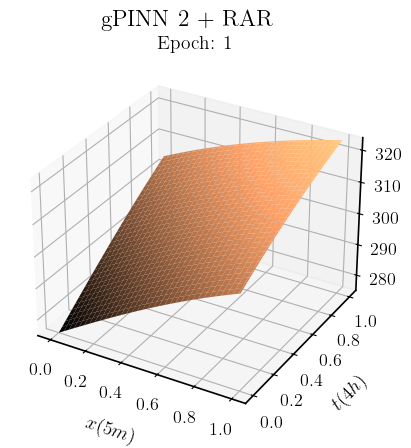

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='copper')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("gPINN 2 + RAR")
    ax.set_xlabel("$x(5m)$", labelpad=10)
    ax.set_ylabel("$t(4h)$", labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$", labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=150)
HTML(anim5.to_html5_video())

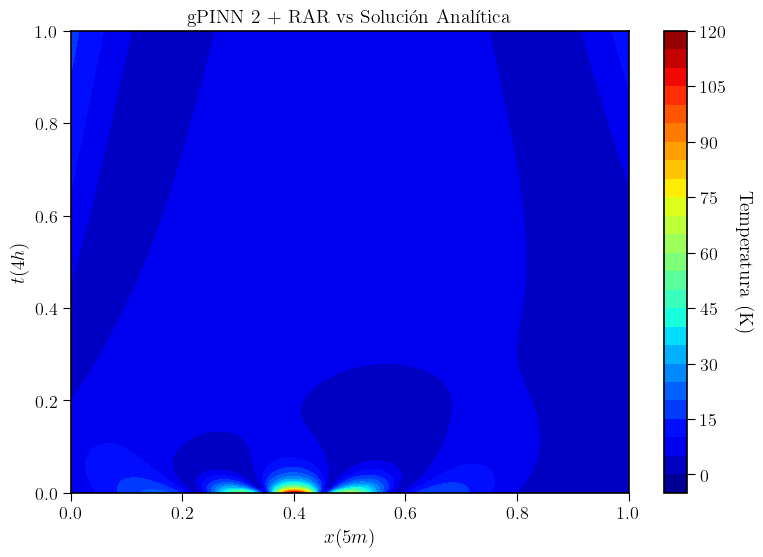

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F     # Reescalar la predicción.
y_true = u_xt1reescaladox(test_points)*F  # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, Lscalado, 200)
t_grid = np.linspace(0, T_max, 200)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (5m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 2 + RAR vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 60.8631
